In [2]:
import pandas as pd
pd.set_option('display.max_rows', None)
import geopandas as gpd
import matplotlib.pyplot as plt
from matplotlib import path
import os
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy
import numpy as np
import netCDF4 as nc
np.set_printoptions(threshold=100000)
from shapely.geometry import Polygon, Point, MultiPoint, LineString, LinearRing
from shapely.ops import cascaded_union, unary_union, transform
import datetime
import math
from scipy.ndimage.interpolation import shift
import scipy.interpolate as si
import shapely.wkt
from shapely.validation import explain_validity
import xarray as xr
import seaborn as sns
from my_functions import sat_vap_press, vap_press, hot_dry_windy, haines
from joblib import Parallel, delayed
import multiprocessing
import os
import rasterio
from rasterio.windows import get_data_window,Window, from_bounds
from rasterio.plot import show
from itertools import product

from timezonefinder import TimezoneFinder
import pytz

# Postprocess 2019

In [12]:
file_list = os.listdir('../mtbs/2019/')

mtbs_bdrys = gpd.GeoDataFrame()
for file in file_list:
    if file.endswith('_burn_bndy.shp'):
        gdf_file = gpd.read_file('../mtbs/2019/'+file)
        mtbs_bdrys = pd.concat([mtbs_bdrys, gdf_file], axis=0)

mtbs_bdrys_merged = mtbs_bdrys.dissolve(by='irwinID').reset_index()
print(mtbs_bdrys_merged.head())

                                irwinID  \
0  026F0FC5-D38C-4F7B-928A-59F37BE81BAA   
1  02F5A6D9-30E9-4B60-9583-6081C60C4955   
2  044FCDB3-02B4-4166-A0E2-21D01913F3ED   
3  0788D1EE-E09B-4BEF-9B79-F43B91350D18   
4  085CC92E-2D49-4F95-98B8-2ED293D238CB   

                                            geometry               Event_ID  \
0  POLYGON ((-1666620.387 2655610.867, -1666618.9...  OR4517811742720190728   
1  POLYGON ((-2187716.566 1895702.336, -2187718.7...  CA3747212124920190625   
2  POLYGON ((-872420.944 1606010.594, -872423.217...  CO3708210594220191027   
3  POLYGON ((-823295.134 2515231.807, -823292.617...  MT4520210650820190815   
4  POLYGON ((-1347699.509 1974619.658, -1347700.8...  UT3977911193520190803   

      Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
0  GRANITE GULCH   Wildfire  10016387     MTBS   Extended       5834   
1           ROCK   Wildfire  10015610     MTBS    Initial       2451   
2            G18   Wildfire  10015845     MTBS    

In [28]:
print(len(np.unique(mtbs_bdrys_merged['irwinID'])))
print(len(mtbs_bdrys_merged))
print(mtbs_bdrys_merged[['irwinID','Incid_Name']])
print(mtbs_bdrys_merged.columns.values)

226
226
                                  irwinID                  Incid_Name
0    026F0FC5-D38C-4F7B-928A-59F37BE81BAA               GRANITE GULCH
1    02F5A6D9-30E9-4B60-9583-6081C60C4955                        ROCK
2    044FCDB3-02B4-4166-A0E2-21D01913F3ED                         G18
3    0788D1EE-E09B-4BEF-9B79-F43B91350D18                      VICTOR
4    085CC92E-2D49-4F95-98B8-2ED293D238CB                  PAINT MINE
5    094DE97E-055E-4489-81EA-9FE7AB80F221                       RIVER
6    0A04F520-2251-4B7A-BF45-D47DC6BD6D49                W-1 MCDONALD
7    0BC4A236-9114-4044-8F7C-9ABAC2EF8CEA                       CUEVA
8    10FD280C-1EFB-4398-821F-F9B49A3D0653                POWELL LEASE
9    12D435C8-627E-438F-994A-1105E5DBB56F                      TENAJA
10   16601786-0C27-4047-876C-A985B7BAE2D2                       POKER
11   169D6993-FD9C-4E72-AB3D-ED752F19FC8E                     BUFFALO
12   19B6F261-215E-4D6C-B62B-DA836C097B86               WHITE SPRINGS
13   1BFD3A0

In [19]:
polygons_2019 = gpd.read_file('AllFires_VIIRS_per_overpass_irwin_2019.geojson', include_fields=['irwinID'])
#print(polygons_2019[polygons_2019['Fire Name']=='BARREN HILL'])

In [29]:
clipped_polys = gpd.GeoDataFrame()
to_clip_polys = gpd.GeoDataFrame()
for ii in range(len(mtbs_bdrys_merged)):
    clipper = mtbs_bdrys_merged.iloc[ii:ii+1].to_crs('EPSG:3347') #the merged MTBS
    clipper['geometry'] = clipper['geometry'].iloc[0].buffer(0) #make sure the clipper is valid
    print(clipper[['irwinID', 'Incid_Name', 'Ig_Date']])
    to_clip = polygons_2019.iloc[np.where(polygons_2019['irwinID'].values==clipper['irwinID'].values)] #my polygon
    to_clip = to_clip.loc[~to_clip['geometry'].isna()].reset_index(drop=True) #get rid of nans
    print(to_clip[['irwinID', 'Fire Name']].iloc[0:1])
    clipped = gpd.clip(to_clip, clipper) #clip out all the extra stuff, other fires, random spot detections, etc
    clipped_polys = pd.concat([clipped_polys, clipped],axis=0) #save the clipped ones, work with these

    
print(clipped_polys.head())
#clipped_polys.to_file('./fire_polygons/ClippedFires_VIIRS_per_overpass_2019.geojson', driver = 'GeoJSON')

                                irwinID     Incid_Name     Ig_Date
0  026F0FC5-D38C-4F7B-928A-59F37BE81BAA  GRANITE GULCH  2019-07-28
                                irwinID      Fire Name
0  026F0FC5-D38C-4F7B-928A-59F37BE81BAA  GRANITE GULCH
                                irwinID Incid_Name     Ig_Date
1  02F5A6D9-30E9-4B60-9583-6081C60C4955       ROCK  2019-06-25
Empty DataFrame
Columns: [irwinID, Fire Name]
Index: []
                                irwinID Incid_Name     Ig_Date
2  044FCDB3-02B4-4166-A0E2-21D01913F3ED        G18  2019-10-27
                                irwinID Fire Name
0  044FCDB3-02B4-4166-A0E2-21D01913F3ED       G18
                                irwinID Incid_Name     Ig_Date
3  0788D1EE-E09B-4BEF-9B79-F43B91350D18     VICTOR  2019-08-15
                                irwinID Fire Name
0  0788D1EE-E09B-4BEF-9B79-F43B91350D18    VICTOR
                                irwinID  Incid_Name     Ig_Date
4  085CC92E-2D49-4F95-98B8-2ED293D238CB  PAINT MINE  2019-

                                 irwinID Incid_Name     Ig_Date
40  399ABB4B-69D2-4170-A59F-B63AF5D70046       HUCK  2019-07-23
                                irwinID Fire Name
0  399ABB4B-69D2-4170-A59F-B63AF5D70046      HUCK
                                 irwinID     Incid_Name     Ig_Date
41  3A55D333-D630-43F4-B8EB-A21BFC031394  ALKALI CANYON  2019-06-20
Empty DataFrame
Columns: [irwinID, Fire Name]
Index: []
                                 irwinID Incid_Name     Ig_Date
42  3A7E9370-F824-404E-8936-50607249ED1B   HORSEFLY  2019-08-05
                                irwinID Fire Name
0  3A7E9370-F824-404E-8936-50607249ED1B  HORSEFLY
                                 irwinID Incid_Name     Ig_Date
43  3B62D7D5-0BCB-4DFA-93C6-D61F0F7F6D86       LONE  2019-08-08
                                irwinID Fire Name
0  3B62D7D5-0BCB-4DFA-93C6-D61F0F7F6D86      LONE
                                 irwinID Incid_Name     Ig_Date
44  3C414AA1-6948-4BF3-B6CD-417691D8633E      SOUTH  2019-09

                                 irwinID Incid_Name     Ig_Date
79  63EEA353-E202-4764-B5C5-C1F9E70DD814    SHAFTER  2019-08-04
                                irwinID Fire Name
0  63EEA353-E202-4764-B5C5-C1F9E70DD814   SHAFTER
                                 irwinID   Incid_Name     Ig_Date
80  659B5E49-52DE-4A6B-9EC6-CD2F0D095DC8  BARREN HILL  2019-07-01
                                irwinID    Fire Name
0  659B5E49-52DE-4A6B-9EC6-CD2F0D095DC8  BARREN HILL
                                 irwinID Incid_Name     Ig_Date
81  65A19A3E-162E-42F6-92DF-872A21D7633F     CASTLE  2019-07-12
                                irwinID Fire Name
0  65A19A3E-162E-42F6-92DF-872A21D7633F    CASTLE
                                 irwinID Incid_Name     Ig_Date
82  65A3609E-E52A-4FA9-AAA8-CB2B56A007EF     HUNTER  2019-10-14
                                irwinID Fire Name
0  65A3609E-E52A-4FA9-AAA8-CB2B56A007EF    HUNTER
                                 irwinID          Incid_Name     Ig_Date
83  6

                                  irwinID  Incid_Name     Ig_Date
118  902D8B39-A23A-4D21-AA52-53FBF0493D56  COVE CREEK  2019-08-04
                                irwinID   Fire Name
0  902D8B39-A23A-4D21-AA52-53FBF0493D56  COVE CREEK
                                  irwinID Incid_Name     Ig_Date
119  917FD9EC-ACAE-4D9B-9934-57ABE27B564B        ELK  2019-06-06
Empty DataFrame
Columns: [irwinID, Fire Name]
Index: []
                                  irwinID Incid_Name     Ig_Date
120  92A45D96-AFE1-458B-8B6B-45291DDD4744     CELLAR  2019-07-14
                                irwinID Fire Name
0  92A45D96-AFE1-458B-8B6B-45291DDD4744    CELLAR
                                  irwinID  Incid_Name     Ig_Date
121  932C1F1C-BB0F-4F1F-BCAF-C47834DCE412  BLUE RIVER  2019-06-30
Empty DataFrame
Columns: [irwinID, Fire Name]
Index: []
                                  irwinID  Incid_Name     Ig_Date
122  96F9FEEE-822C-4FA9-98AC-38C77D614B77  WAR BONNET  2019-08-21
                            

                                  irwinID Incid_Name     Ig_Date
157  BD27D846-7490-4F88-B86C-A63E274894CC     MATSON  2019-10-07
                                irwinID Fire Name
0  BD27D846-7490-4F88-B86C-A63E274894CC    MATSON
                                  irwinID    Incid_Name     Ig_Date
158  BDF99ECF-D313-47D2-A3D1-87089AF8452B  SHEEP CANYON  2019-07-23
                                irwinID     Fire Name
0  BDF99ECF-D313-47D2-A3D1-87089AF8452B  SHEEP CANYON
                                  irwinID Incid_Name     Ig_Date
159  BDFF81B5-02FD-44A6-848E-418B8FAC3FD1   RIDGETOP  2019-08-01
                                irwinID Fire Name
0  BDFF81B5-02FD-44A6-848E-418B8FAC3FD1  RIDGETOP
                                  irwinID   Incid_Name     Ig_Date
160  BF4C99A2-B88D-499E-BC61-BBDA06FF6D58  WOOD CANYON  2019-08-13
                                irwinID    Fire Name
0  BF4C99A2-B88D-499E-BC61-BBDA06FF6D58  WOOD CANYON
                                  irwinID  Incid_Name   

                                  irwinID Incid_Name     Ig_Date
196  DD2B053D-B6D6-49C7-A077-A5ED37669C80     REFUGE  2019-05-07
Empty DataFrame
Columns: [irwinID, Fire Name]
Index: []
                                  irwinID Incid_Name     Ig_Date
197  DE39D0B4-0A78-400D-A646-A833748B546C       DOVE  2019-05-24
Empty DataFrame
Columns: [irwinID, Fire Name]
Index: []
                                  irwinID      Incid_Name     Ig_Date
198  DE8D0134-9714-4D14-9B62-310C726A17EE  PEDRO MOUNTAIN  2019-08-24
                                irwinID       Fire Name
0  DE8D0134-9714-4D14-9B62-310C726A17EE  PEDRO MOUNTAIN
                                  irwinID      Incid_Name     Ig_Date
199  DF4A3D1F-A673-4782-86D8-E48612B8A491  PEAVINE CANYON  2019-07-16
                                irwinID       Fire Name
0  DF4A3D1F-A673-4782-86D8-E48612B8A491  PEAVINE CANYON
                                  irwinID    Incid_Name     Ig_Date
200  DFB90F7A-A539-409A-A8E3-4F3BD77D1064  MEADOW CREEK 

# Postprocess 2020

In [9]:
file_list = os.listdir('../mtbs/2020/')

mtbs_bdrys = gpd.GeoDataFrame()
for file in file_list:
    if file.endswith('_burn_bndy.shp'):
        gdf_file = gpd.read_file('../mtbs/2020/'+file)
        mtbs_bdrys = pd.concat([mtbs_bdrys, gdf_file], axis=0)

mtbs_bdrys_merged = mtbs_bdrys.dissolve(by='irwinID').reset_index()
print(mtbs_bdrys_merged)

                                  irwinID  \
0    007738AD-E20A-4B7D-9F77-6A5D50291B88   
1    00B3EDB2-87A4-4D0A-A834-4E1012BF9693   
2    013BE5E0-9AC8-4901-B7B7-E9DE5D0D14E2   
3    024CFE3D-2AA3-4BEC-BF99-7508B3B14C24   
4    03E930CE-D511-42C2-8808-08CF0FF43C7D   
5    04010825-BEF3-4692-8D12-36A952383659   
6    04156FA2-01E3-4146-97C3-28EB819CB0A8   
7    049F5FF6-0A78-48C0-8CAA-FC73A8A64EB6   
8    05D46C54-1361-480E-B6F4-3D811CEA2AF8   
9    065C99E4-5FC2-4097-8D7D-BB3CA6396302   
10   076E3987-66BC-481B-A436-3D02579BCA45   
11   07A2F787-CF35-46AB-92FB-EEA413392BE3   
12   08871458-2A59-42B7-A535-DCF94F79242C   
13   08906405-D2A2-478D-A367-32198983F7CC   
14   0896AFFE-7839-40D4-BA6D-407F47E4CAA6   
15   08BCEF87-391E-4AC7-941D-EF63D9D3A6C3   
16   09509DA4-590D-43E2-A28B-035FC42DC19F   
17   0A2BB376-060F-4A68-959A-25B146A7C1BD   
18   0A774A4C-3800-4712-8F15-CB36A308DC00   
19   0AB02E6D-FE2D-4DDA-BE46-7F7D7E9E7530   
20   0AFEBC32-36EE-4FA8-AEC5-419C9C6BA51D   
21   0B975

In [6]:
polygons_2020 = gpd.read_file('AllFires_VIIRS_per_overpass_irwin_2020.geojson', include_fields=['irwinID'])
print(polygons_2020.head())

   Incident Number                               irwinID Fire Name  \
0       11736184.0  92EB6A48-F988-48C5-BE65-EB3140DC6E27     APPLE   
1       11736184.0  92EB6A48-F988-48C5-BE65-EB3140DC6E27     APPLE   
2       11736184.0  92EB6A48-F988-48C5-BE65-EB3140DC6E27     APPLE   
3       11736184.0  92EB6A48-F988-48C5-BE65-EB3140DC6E27     APPLE   
4       11736184.0  92EB6A48-F988-48C5-BE65-EB3140DC6E27     APPLE   

  Current Day  Current Overpass   Lat Fire    Lon Fire  \
0  2020-08-01             730.0  33.988611 -116.958056   
1  2020-08-01             918.0  33.988611 -116.958056   
2  2020-08-01            1006.0  33.988611 -116.958056   
3  2020-08-01            1948.0  33.988611 -116.958056   
4  2020-08-01            2036.0  33.988611 -116.958056   

   Number of NEW VIIRS points  NEW FRP   daily_area  \
0                         0.0     0.00    29.147663   
1                        53.0   305.87  1297.412925   
2                        49.0   268.60   603.187019   
3         

In [8]:
clipped_polys = gpd.GeoDataFrame()
to_clip_polys = gpd.GeoDataFrame()
for ii in range(len(mtbs_bdrys_merged)):
    clipper = mtbs_bdrys_merged.iloc[ii:ii+1].to_crs('EPSG:3347') #the merged MTBS
    clipper['geometry'] = clipper['geometry'].iloc[0].buffer(0) #make sure the clipper is valid
    print(clipper)
    to_clip = polygons_2020.iloc[np.where(polygons_2020['irwinID'].values==clipper['irwinID'].values)] #my polygon
    to_clip = to_clip.loc[~to_clip['geometry'].isna()] #get rid of nans
    clipped = gpd.clip(to_clip, clipper) #clip out all the extra stuff, other fires, random spot detections, etc
    clipped_polys = pd.concat([clipped_polys, clipped],axis=0) #save the clipped ones, work with these

    
print(clipped_polys.head())
clipped_polys.to_file('./fire_polygons/ClippedFires_VIIRS_per_overpass_2020.geojson', driver = 'GeoJSON')

                                irwinID  \
0  007738AD-E20A-4B7D-9F77-6A5D50291B88   

                                            geometry               Event_ID  \
0  POLYGON ((5291254.353 -57150.671, 5291254.365 ...  TX3553710125120200609   

  Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
0      YANDY   Wildfire  10019331     MTBS    Initial       2722     35.507   

   ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
0  ...  803003520200620     None         32         11     -970        -150   

   Low_T  Mod_T  High_T  Comment  
0     70   9999    9999     None  

[1 rows x 23 columns]
                                irwinID  \
1  00B3EDB2-87A4-4D0A-A834-4E1012BF9693   

                                            geometry               Event_ID  \
1  MULTIPOLYGON (((3917236.204 1636014.610, 39172...  WA4592712198020200908   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
1  BIG HOLLOW   W

                                 irwinID  \
12  08871458-2A59-42B7-A535-DCF94F79242C   

                                             geometry               Event_ID  \
12  POLYGON ((4089592.266 1476849.174, 4089593.454...  OR4538011911420200908   

                Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  \
12  EAST FORK BUTTER CREEK   Wildfire  10020207     MTBS    Initial   

    BurnBndAc BurnBndLat  ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv  \
12      11497     45.352  ...  804402820200910     None         16         15   

   NoData_T  IncGreen_T  Low_T  Mod_T  High_T  Comment  
12     -970        -150     70    385    9999     None  

[1 rows x 23 columns]
                                 irwinID  \
13  08906405-D2A2-478D-A367-32198983F7CC   

                                             geometry               Event_ID  \
13  POLYGON ((3751817.590 819077.563, 3751810.488 ...  NV3884311963920200707   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  B

                                 irwinID  \
25  0DF1645C-5A67-4734-89A6-172330D04945   

                                             geometry               Event_ID  \
25  POLYGON ((3710480.323 611196.411, 3710439.428 ...  CA3714111902520200908   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
25   BULLFROG   Wildfire  10020969     MTBS   Extended       1166     37.127   

    ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
25  ...  804203420210915     None         -3         30     -970        -150   

    Low_T  Mod_T  High_T  Comment  
25     40    300     625     None  

[1 rows x 23 columns]
                                 irwinID  \
26  0E790F30-12EA-4D90-90F6-4BC3D2D0E543   

                                             geometry               Event_ID  \
26  POLYGON ((4326613.805 1073094.555, 4326629.728...  ID4282811459820200825   

     Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
26  COUNTY L

                                 irwinID  \
37  192C3FCF-435F-4BA2-86C9-22024364F54F   

                                             geometry               Event_ID  \
37  POLYGON ((4271345.516 793534.698, 4271363.595 ...  NV4034511406020200530   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
37     IBAPAH   Wildfire  10020669     MTBS    Initial       6696     40.377   

    ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
37  ...  804003220200626     None         15          5     -970        -150   

    Low_T  Mod_T  High_T  Comment  
37     55   9999    9999     None  

[1 rows x 23 columns]
                                 irwinID  \
38  1AA854A7-3969-4969-9413-950CF0C2DFB6   

                                             geometry               Event_ID  \
38  MULTIPOLYGON (((3847413.395 1558704.869, 38474...  OR4504912206220200908   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
38 

                                 irwinID  \
49  24CDAB5C-7832-4546-BD05-15CC702A0326   

                                             geometry               Event_ID  \
49  POLYGON ((3578790.236 1304426.959, 3578788.936...  CA4185812335420200908   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
49     SLATER   Wildfire  10019506     MTBS   Extended     157779     41.932   

    ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
49  ...  B10TDM20210716_30m     None          9         34     -970   

    IncGreen_T  Low_T  Mod_T  High_T  Comment  
49        -150     60    325     615     None  

[1 rows x 23 columns]
                                 irwinID  \
50  25194918-0133-4154-8B62-6C884154BBCD   

                                             geometry               Event_ID  \
50  POLYGON ((4145376.494 1341474.627, 4145313.931...  OR4441811785820200817   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat 

                                 irwinID  \
61  2C1549A7-7DBE-4846-A71F-AF8C42FAF16A   

                                             geometry               Event_ID  \
61  POLYGON ((5408337.399 -565128.428, 5408342.742...  TX3143909942320200714   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
61    WALDROP   Wildfire  10018996     MTBS    Initial       1007     31.444   

    ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
61  ...  802803820200809     None         25         17     -970        -150   

    Low_T  Mod_T  High_T  Comment  
61     30    315    9999     None  

[1 rows x 23 columns]
                                 irwinID  \
62  2D317440-5A5C-43E2-82E4-E89AE2B922DF   

                                             geometry               Event_ID  \
62  POLYGON ((3857158.134 1182645.380, 3857142.779...  OR4209412026920200816   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
62 

                                 irwinID  \
75  37B62542-EA3C-497E-80D1-34816DE96D65   

                                             geometry               Event_ID  \
75  POLYGON ((4406793.010 1404132.531, 4406794.916...  ID4576011519320200818   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
75   SHISSLER   Wildfire  10020979     MTBS   Extended      11200      45.78   

    ...          Post_ID         Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
75  ...  804102820210722  804102820200921         30         18     -970   

    IncGreen_T  Low_T  Mod_T  High_T  Comment  
75        -150     70    283     530     None  

[1 rows x 23 columns]
                                 irwinID  \
76  3883D723-E328-4DA2-A7E8-ECBD419B420A   

                                             geometry               Event_ID  \
76  POLYGON ((3682865.002 130168.978, 3682859.616 ...  CA3340311726720201224   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc B

                                 irwinID  \
88  3F63C271-1D4D-4E24-B9FF-97028046BD1D   

                                             geometry               Event_ID  \
88  POLYGON ((4112756.819 1800056.552, 4112759.814...  WA4799112069920200731   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
88   CHIKAMIN   Wildfire  10021288     MTBS   Extended       1944     48.001   

    ...          Post_ID         Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
88  ...  804502720210819  804602620200823          4         14     -970   

    IncGreen_T  Low_T  Mod_T  High_T  \
88        -150     40    256     500   

                                              Comment  
88  Used perimeter from RAVG mapping with slight a...  

[1 rows x 23 columns]
                                 irwinID  \
89  3F9BBD22-DEC9-428D-B8F4-10327F986FAB   

                                             geometry               Event_ID  \
89  POLYGON ((4122865.425 376249.038, 4122861.917 .

                                  irwinID  \
100  441FD48B-515B-49E8-984C-515EA5D0CD49   

                                              geometry               Event_ID  \
100  POLYGON ((3496025.298 916732.593, 3495962.753 ...  CA3855412253120200927   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
100      GLASS   Wildfire  10021090     MTBS   Extended      68019     38.552   

     ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
100  ...  804503320210718     None         37         35     -970        -150   

     Low_T  Mod_T  High_T  Comment  
100     65    316     595     None  

[1 rows x 23 columns]
                                  irwinID  \
101  44797D81-7F12-447F-9D0E-B9AB3EBE8D6C   

                                              geometry               Event_ID  \
101  POLYGON ((3638920.988 293768.910, 3638911.216 ...  CA3446611833020200705   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc Bu

                                  irwinID  \
112  4CE00061-B897-49DC-8839-D08E040FF65D   

                                              geometry               Event_ID  \
112  MULTIPOLYGON (((3725250.199 498029.428, 372525...  CA3616111845220200819   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
112     CASTLE   Wildfire  10020558     MTBS   Extended     173389     36.234   

     ...          Post_ID         Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
112  ...  804103520210807  804103520201023         52         36     -970   

     IncGreen_T  Low_T  Mod_T  High_T                        Comment  
112        -150     90    310     630  Used modified NIFC perimeter.  

[1 rows x 23 columns]
                                  irwinID  \
113  4DE3802A-339C-4F3D-BD9A-61D55E9D2AA5   

                                              geometry               Event_ID  \
113  POLYGON ((3732367.301 787676.794, 3732413.629 ...  CA3856811956820200830   

    Incid

                                  irwinID  \
124  56685BB5-691C-4662-997D-DB3F782FEE6B   

                                              geometry               Event_ID  \
124  POLYGON ((5324659.957 867341.581, 5324656.123 ...  SD4334810247820200914   

          Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
124  SINGING HORSE 2   Wildfire  10019567     MTBS    Initial       2328   

    BurnBndLat  ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
124     43.377  ...  803203020200922     None         24         12     -970   

     IncGreen_T  Low_T  Mod_T  High_T  \
124        -150     60   9999    9999   

                                          Comment  
124  No high or moderate severity was identified.  

[1 rows x 23 columns]
                                  irwinID  \
125  56C3E0AE-98EF-4433-863D-23A5DFF3D0C2   

                                              geometry               Event_ID  \
125  POLYGON ((3667182.105 251956.447, 3667182.060

                                  irwinID  \
136  5DCC1365-150C-4EE3-9D94-627D92C141D8   

                                              geometry               Event_ID  \
136  POLYGON ((3836271.125 1522905.883, 3836257.884...  OR4482112218820200816   

        Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
136  BEACHIE CREEK   Wildfire  10021044     MTBS   Extended     194622   

    BurnBndLat  ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv  \
136     44.859  ...  A10TEQ20210810_30m     None         10         15   

    NoData_T  IncGreen_T  Low_T  Mod_T  High_T  Comment  
136     -970        -150     35    278     545     None  

[1 rows x 23 columns]
                                  irwinID  \
137  5DDB9927-8AD8-4054-908A-9F84EFF38A62   

                                              geometry               Event_ID  \
137  POLYGON ((5003443.349 1234925.796, 5003469.400...  MT4599210727920200923   

     Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Typ

                                  irwinID  \
149  640FD5AB-A721-41FB-97AF-64D45210D561   

                                              geometry               Event_ID  \
149  POLYGON ((3770244.934 966557.179, 3770241.528 ...  CA4003412011520201117   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
149    LAURA 2   Wildfire  10020677     MTBS    Initial       3099     40.064   

     ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
149  ...  A11TKE20201120_30m     None        -22         19     -970   

     IncGreen_T  Low_T  Mod_T  High_T  \
149        -150     10   9999    9999   

                                          Comment  
149  No high or moderate severity was identified.  

[1 rows x 23 columns]
                                  irwinID  \
150  64F621C2-F9F1-4670-9B3D-A6CA56690488   

                                              geometry               Event_ID  \
150  POLYGON ((4074501.507 191716.834, 4074498.308 ...  

                                  irwinID  \
162  6AC2092A-7E47-498A-84B6-616E1EB512D1   

                                              geometry               Event_ID  \
162  POLYGON ((4411024.442 1017836.498, 4411028.842...  ID4262311348620200808   

       Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
162  LAKE WALCOTT   Wildfire  10020645     MTBS    Initial       1327   

    BurnBndLat  ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
162     42.626  ...  803903020200822     None        -30         12     -970   

     IncGreen_T  Low_T  Mod_T  High_T  Comment  
162        -150      5   9999    9999     None  

[1 rows x 23 columns]
                                  irwinID  \
163  6B88E855-805E-42B8-B689-08D1AFD38A47   

                                              geometry               Event_ID  \
163  POLYGON ((5135093.355 277979.972, 5135093.355 ...  CO3805510340720200411   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBn

                                  irwinID  \
174  70CA24CA-5517-4545-A0E8-AF37AB7D7242   

                                              geometry               Event_ID  \
174  POLYGON ((4900968.042 1004784.761, 4900972.846...  WY4385610791920200714   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
174     NEIBER   Wildfire  10020874     MTBS    Initial      17593     43.798   

     ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
174  ...  803603020200801     None          3         13     -970        -150   

     Low_T  Mod_T  High_T  Comment  
174     30    235     405     None  

[1 rows x 23 columns]
                                  irwinID  \
175  70E3B9A3-201B-4A98-8167-E38C9F848502   

                                              geometry               Event_ID  \
175  POLYGON ((4324426.529 362912.662, 4324425.755 ...  UT3704711205120200627   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc Bu

                                  irwinID  \
186  7AC33794-5C08-477B-8F4C-349453D2338B   

                                              geometry               Event_ID  \
186  POLYGON ((3931132.143 1392451.286, 3931151.656...  OR4403912052820200816   

       Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
186  FROG 0657 RS   Wildfire  10021401     MTBS   Extended       3950   

    BurnBndLat  ...          Post_ID         Perim_ID dNBR_offst dNBR_stdDv  \
186     44.028  ...  804402920210812  804502920200901          5         37   

    NoData_T  IncGreen_T  Low_T  Mod_T  High_T  Comment  
186     -970        -150     60    260     530     None  

[1 rows x 23 columns]
                                  irwinID  \
187  7BD5C1E6-1D90-49D1-A47C-A9A329578234   

                                              geometry               Event_ID  \
187  POLYGON ((4641390.855 -152906.523, 4641377.770...  NM3357010744220200615   

    Incid_Name Incid_Type    Map_ID Map_Prog As

                                  irwinID  \
198  82C7D25A-86B8-419C-AFAB-EDB8E3C53708   

                                              geometry               Event_ID  \
198  POLYGON ((3517250.338 644668.922, 3517252.643 ...  CA3667512102020200715   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
198     COYOTE   Wildfire  10020907     MTBS    Initial       1558     36.675   

     ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
198  ...  804303520200903     None         13         20     -970        -150   

     Low_T  Mod_T  High_T  Comment  
198     55    295    9999     None  

[1 rows x 23 columns]
                                  irwinID  \
199  82DB77F9-0F86-4887-B759-7AA8A6BA4B22   

                                              geometry               Event_ID  \
199  POLYGON ((4736917.879 577088.432, 4736922.001 ...  CO3976210841920200713   

     Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  

                                  irwinID  \
210  8944C2E9-D7DD-4DD2-9A82-55E61B28B780   

                                              geometry               Event_ID  \
210  POLYGON ((3840641.351 1027337.544, 3840515.015...  NV4083911966720200812   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
210     POODLE   Wildfire  10019552     MTBS    Initial      13719     40.884   

     ...          Post_ID         Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
210  ...  804303220200903  804303220200903         17         19     -970   

     IncGreen_T  Low_T  Mod_T  High_T  Comment  
210        -150     55    355    9999     None  

[1 rows x 23 columns]
                                  irwinID  \
211  89657A4B-380E-46B6-9E13-D2B483582B07   

                                              geometry               Event_ID  \
211  POLYGON ((5456779.632 -411831.773, 5456775.072...  TX3268709915020200830   

     Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_T

                                  irwinID  \
222  92EB6A48-F988-48C5-BE65-EB3140DC6E27   

                                              geometry               Event_ID  \
222  POLYGON ((3761507.215 194346.458, 3761525.640 ...  CA3399211696420200731   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
222      APPLE   Wildfire  10021134     MTBS   Extended      32368     34.032   

     ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
222  ...  804003620210715     None        -17         20     -970        -150   

     Low_T  Mod_T  High_T  Comment  
222     55    310     550     None  

[1 rows x 23 columns]
                                  irwinID  \
223  93C3E189-90D2-44D0-A954-94BB8A18E833   

                                              geometry               Event_ID  \
223  POLYGON ((4196804.384 423462.241, 4196802.520 ...  UT3715711356620200714   

           Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnB

                                  irwinID  \
234  998479D0-8333-4D4B-AE2C-10E57EDEDAAC   

                                              geometry               Event_ID  \
234  POLYGON ((4291977.309 1096983.607, 4291987.663...  ID4292211511120200819   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
234   BANCROFT   Wildfire  10020557     MTBS    Initial       1455     42.919   

     ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
234  ...  804003020200829     None          8          7     -970        -150   

     Low_T  Mod_T  High_T  Comment  
234     30   9999    9999     None  

[1 rows x 23 columns]
                                  irwinID  \
235  99880600-3205-4843-845F-AE3E52F4A212   

                                              geometry               Event_ID  \
235  POLYGON ((3758328.645 1298029.681, 3758314.972...  OR4265312186920200908   

       Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc

                                  irwinID  \
246  A091434B-C482-4333-ADF1-D4D6DA5D6109   

                                              geometry               Event_ID  \
246  POLYGON ((4446912.164 1443606.821, 4446942.097...  ID4626111483920200819   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
246     DOUBLE   Wildfire  10020936     MTBS   Extended        994     46.264   

     ...          Post_ID         Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
246  ...  804102820210706  804102820200921         31         22     -970   

     IncGreen_T  Low_T  Mod_T  High_T  Comment  
246        -150     65    362     680     None  

[1 rows x 23 columns]
                                  irwinID  \
247  A0D9F6DF-191F-4D17-A8E8-567282E354DE   

                                              geometry               Event_ID  \
247  POLYGON ((4413151.676 -329051.270, 4413203.160...  AZ3175510913820200810   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Ty

                                  irwinID  \
259  A7AA0A75-490E-4F6E-AE55-E340A48BE138   

                                              geometry               Event_ID  \
259  POLYGON ((4587657.871 721409.536, 4587660.150 ...  UT4064011045220200825   

             Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
259  CENTER CREEK TRAIL   Wildfire  10020938     MTBS   Extended       1768   

    BurnBndLat  ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
259      40.65  ...  803703220210710     None        -12         34     -970   

     IncGreen_T  Low_T  Mod_T  High_T  Comment  
259        -150     45    350     665     None  

[1 rows x 23 columns]
                                  irwinID  \
260  A7C18C5A-0A83-4916-B619-C781C5554E82   

                                              geometry               Event_ID  \
260  POLYGON ((4403930.255 -280748.077, 4403934.360...  AZ3209510937320200606   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_

                                  irwinID  \
272  AF24A95B-DD32-4CA5-AD05-C5482F80D333   

                                              geometry               Event_ID  \
272  POLYGON ((4635792.061 1357894.968, 4635850.765...  MT4609911223320200829   

      Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
272  STATE CREEK   Wildfire  10020864     MTBS   Extended       4547   

    BurnBndLat  ...          Post_ID         Perim_ID dNBR_offst dNBR_stdDv  \
272     46.089  ...  803902820210708  804002820200930        -21         17   

    NoData_T  IncGreen_T  Low_T  Mod_T  High_T  \
272     -970        -150     40    256     500   

                                               Comment  
272  Used perimeter from BAER mapping with slight a...  

[1 rows x 23 columns]
                                  irwinID  \
273  AF59F1DF-7FE8-444C-93F1-8387930CE5CD   

                                              geometry               Event_ID  \
273  POLYGON ((4719144.476 12846

                                  irwinID  \
285  B5B4F18B-F2BB-4642-9296-67C6A9DBA7CA   

                                              geometry               Event_ID  \
285  POLYGON ((3884814.335 1127691.149, 3884802.993...  NV4180711966720200727   

      Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
285  S-4 SHELDON   Wildfire  10019595     MTBS    Initial       1908   

    BurnBndLat  ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
285       41.8  ...  804403120200809     None         25         20     -970   

     IncGreen_T  Low_T  Mod_T  High_T  Comment  
285        -150     65    340     490     None  

[1 rows x 23 columns]
                                  irwinID  \
286  B5EC2F0E-3CAA-47F4-9E55-3B83EEBF4CC5   

                                              geometry               Event_ID  \
286  POLYGON ((4642061.879 1597378.074, 4642065.092...  MT4814011316520200826   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndA

                                  irwinID  \
297  BD5901D9-C99A-45CB-B799-F1CAD5F3EA4B   

                                              geometry               Event_ID  \
297  POLYGON ((3639941.139 324445.350, 3639918.262 ...  CA3467911845220200812   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
297       LAKE   Wildfire  10020788     MTBS   Extended      30971     34.686   

     ...          Post_ID         Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
297  ...  804103620210503  804103620200921         66         36     -970   

     IncGreen_T  Low_T  Mod_T  High_T  \
297        -150    150    323     550   

                                               Comment  
297  Used 2018 preimage due to it being the best ma...  

[1 rows x 23 columns]
                                  irwinID  \
298  BD85FA59-D849-46C5-BF14-4557B795A732   

                                              geometry               Event_ID  \
298  POLYGON ((5071465.689 1366752.1

                                  irwinID  \
310  C395AB59-A0D3-4449-BE87-3B60CCAD954E   

                                              geometry               Event_ID  \
310  POLYGON ((5267813.446 -471017.976, 5267814.153...  TX3206310086420200619   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
310      SLADE   Wildfire  10019247     MTBS    Initial       4720     32.069   

     ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
310  ...  B14SLA20200711_30m     None         18         11     -970   

     IncGreen_T  Low_T  Mod_T  High_T  Comment  
310        -150     75    290    9999     None  

[1 rows x 23 columns]
                                  irwinID  \
311  C4167FE2-BEE9-4420-B9F9-E1BF479D2B49   

                                              geometry               Event_ID  \
311  POLYGON ((4720999.568 529653.986, 4720993.887 ...  CO3933610852620200731   

     Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnB

                                  irwinID  \
323  CBE91860-F520-4CF4-85C6-1B4D1AA9729B   

                                              geometry               Event_ID  \
323  POLYGON ((5113525.873 1144579.038, 5113194.677...  MT4541710565520201006   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
323     BURLEY   Wildfire  10019804     MTBS    Initial       3525     45.397   

     ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
323  ...  A13TDL20201102_30m     None         50         12     -970   

     IncGreen_T  Low_T  Mod_T  High_T  \
323        -150     80    324     600   

                                               Comment  
323  High severity areas were identified in extende...  

[1 rows x 23 columns]
                                  irwinID  \
324  CD3AC2F4-39F6-4515-8E1E-E8788A3D5E04   

                                              geometry               Event_ID  \
324  POLYGON ((4270687.501 -192558.401, 427069

                                  irwinID  \
335  D65F0439-388F-4168-AACA-A4F2836639A7   

                                              geometry               Event_ID  \
335  POLYGON ((3678942.199 132447.553, 3678937.013 ...  CA3337911735120200609   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
335      INDIA   Wildfire  10020737     MTBS    Initial      24187     33.404   

     ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
335  ...  804003720200626     None         50         46     -970        -150   

     Low_T  Mod_T  High_T  Comment  
335    150    380     720     None  

[1 rows x 23 columns]
                                  irwinID  \
336  D692040D-758E-4022-92E8-9464B72587FC   

                                              geometry               Event_ID  \
336  POLYGON ((4585410.861 707039.827, 4585410.982 ...  UT4060611070920200821   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc Bu

                                  irwinID  \
347  DD5358EA-611D-4B11-9404-BAB720610DED   

                                              geometry               Event_ID  \
347  POLYGON ((4652079.705 1312058.245, 4652050.088...  MT4577311182220200929   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
347   ANTELOPE   Wildfire  10020383     MTBS   Extended       1817     45.769   

     ...          Post_ID         Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
347  ...  803902820210708  803902820201009         19         14     -970   

     IncGreen_T  Low_T  Mod_T  High_T  Comment  
347        -150     60    236     450     None  

[1 rows x 23 columns]
                                  irwinID  \
348  DE146034-7E82-4205-B0F6-AAF37C1B5714   

                                              geometry               Event_ID  \
348  POLYGON ((4306142.357 -55607.280, 4306013.562 ...  AZ3366211089820200824   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Ty

                                  irwinID  \
360  E7A2A38A-CB01-44DA-A8F1-B5364F353F22   

                                              geometry               Event_ID  \
360  POLYGON ((4529526.936 154124.704, 4529597.254 ...  AZ3584010937820200627   

         Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
360  WOOD SPRINGS 2   Wildfire  10021007     MTBS   Extended      13207   

    BurnBndLat  ...          Post_ID         Perim_ID dNBR_offst dNBR_stdDv  \
360     35.898  ...  803503520210712  803503520200709         -7         28   

    NoData_T  IncGreen_T  Low_T  Mod_T  High_T  \
360     -970        -150     70    213     400   

                                               Comment  
360  Used perimeter from BAER mapping with slight a...  

[1 rows x 23 columns]
                                  irwinID  \
361  E82872D0-E03D-40A8-8AFD-CA68C8FFF834   

                                              geometry               Event_ID  \
361  POLYGON ((4674229.724

                                  irwinID  \
372  EFB518C1-B070-48E7-8936-B813122DE63D   

                                              geometry               Event_ID  \
372  POLYGON ((4514734.432 786556.070, 4514727.824 ...  UT4102211143920201017   

      Incid_Name Incid_Type    Map_ID Map_Prog    Asmnt_Type  BurnBndAc  \
372  FIRE CANYON   Wildfire  10020307     MTBS  Initial (SS)       1637   

    BurnBndLat  ...          Post_ID         Perim_ID dNBR_offst dNBR_stdDv  \
372     41.017  ...  803803120201205  803803120201205          1          0   

    NoData_T  IncGreen_T  Low_T  Mod_T  High_T  \
372     9999        9999    100   -200   -9999   

                                               Comment  
372  No high severity was identified, only a limite...  

[1 rows x 23 columns]
                                  irwinID  \
373  F01F2D3F-8961-4981-8592-6093C56C83BD   

                                              geometry               Event_ID  \
373  POLYGON ((4298583.761

                                  irwinID  \
384  F7749F47-7C98-4CEC-A5DE-70DB9A9BE33F   

                                              geometry               Event_ID  \
384  POLYGON ((3669462.351 184970.614, 3669460.081 ...  CA3378011763820201203   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
384       BOND   Wildfire  10020830     MTBS    Initial       6623      33.74   

     ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
384  ...  804003720201219     None         13         30     -970        -150   

     Low_T  Mod_T  High_T                                            Comment  
384     70    361     675  Used IA due to greeness of extended imagery.\r...  

[1 rows x 23 columns]
                                  irwinID  \
385  F7EA0196-9F1D-409C-AA5D-D33B15339185   

                                              geometry               Event_ID  \
385  POLYGON ((4419825.834 789478.008, 4419824.101 ...  UT407871125

                                  irwinID  \
396  FFCB89F5-98FB-4C3A-9554-3D1554181A63   

                                              geometry               Event_ID  \
396  POLYGON ((3764539.774 163653.677, 3764514.322 ...  CA3388811668420200917   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
396       SNOW   Wildfire  10020811     MTBS   Extended       6468     33.869   

     ...          Post_ID         Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
396  ...  804003620210512  804003620200930         39         35     -970   

     IncGreen_T  Low_T  Mod_T  High_T  \
396        -150    135    345     600   

                                               Comment  
396  Used perimeter from BAER fires with some sligh...  

[1 rows x 23 columns]
       Incident Number                               irwinID   Fire Name  \
16158       11943503.0  00B3EDB2-87A4-4D0A-A834-4E1012BF9693  BIG HOLLOW   
16159       11943503.0  00B3EDB2-87A4-4D0A-A834-4E1012BF

# Postprocess 2021

In [8]:
file_list = os.listdir('../mtbs/2021/')

mtbs_bdrys = gpd.GeoDataFrame()
for file in file_list:
    if file.endswith('_burn_bndy.shp'):
        gdf_file = gpd.read_file('../mtbs/2021/'+file)
        mtbs_bdrys = pd.concat([mtbs_bdrys, gdf_file], axis=0)

mtbs_bdrys_merged_2021 = mtbs_bdrys.dissolve(by='irwinID').reset_index()
print(mtbs_bdrys_merged_2021)

                                  irwinID  \
0    00295066-E99F-4F61-8FDC-DC06A97F7B52   
1    008D427F-CB87-4556-9418-BA8C2C34E65A   
2    03AA874F-C353-47E2-A3A4-04364C93F76F   
3    05AB0B04-EEA1-4BAD-858A-D906AC3583DC   
4    07C75421-ED46-4D0C-90A7-9B89F6C80A9B   
5    087636DC-25DC-4309-A1F4-5A3B9A5141DF   
6    08D1D685-B330-4DD4-AC2E-C8F677E7AB02   
7    090672B0-EC50-443C-B0CF-0106B0F425CE   
8    0A3CA174-FCD3-49E6-88FC-45DB7F1E55E5   
9    0C819135-97BB-466B-B35E-8A2F4EA759DF   
10   0D0B573E-97F6-4B1D-8BAD-7C9B079C1A75   
11   0DFC1976-D66F-40EA-B769-734EA8E42F99   
12   13012142-2F6C-421B-A40A-5DD6D6534F5D   
13   130BF770-BC65-40C3-B9AB-5D3C4A790228   
14   1387CFCA-6002-4F80-8F70-0092EFFBE679   
15   14141EE6-98E3-48A5-BAB4-E2F71F9AFAD4   
16   1A6EF06F-0508-42FE-B365-85850E42EBCC   
17   1CEA5A61-E3F4-41F7-9487-EAA93FFD5450   
18   1D8DD87D-3079-43C5-BF99-ADAB129D50B5   
19   1E31E6B8-293B-48F3-97F9-BF460523E6A8   
20   1EA57600-9731-46D7-9AE1-B576DC679E05   
21   216BD

In [9]:
#load in the provisional data
file_list = os.listdir('../provisional/2021/')

pia_bdrys = gpd.GeoDataFrame()
for file in file_list:
    if file.endswith('_burn_bndy.shp'):
        gdf_file = gpd.read_file('../provisional/2021/'+file)
        pia_bdrys = pd.concat([pia_bdrys, gdf_file], axis=0)

pia_bdrys_merged_2021 = pia_bdrys.dissolve(by='irwinID').reset_index()
print(pia_bdrys_merged_2021)

                                 irwinID  \
0   07C75421-ED46-4D0C-90A7-9B89F6C80A9B   
1   0BA1C51B-1EEF-4081-BB65-76EC999F95C6   
2   115E090B-6F4F-4E50-A28B-ABA11B9D876B   
3   2E9571B4-4087-4D28-8B57-74966B77EE05   
4   33088F36-F802-4500-86A4-82DA6A62425F   
5   3502EB16-012C-42FA-9531-B87897EEB494   
6   38784EBA-336B-4447-8FE2-00ADEB62774F   
7   3FD60447-26E2-4A89-8A47-6278CF788357   
8   4098977E-B34D-40C3-8F34-2B913217503A   
9   415BD75F-88E8-4208-8D87-7C2CA655728F   
10  46496BE5-7D92-41DF-BFB0-8288ABD1BE5B   
11  46E71AE7-7787-48B3-B584-9D63F43FA071   
12  499D6545-2A19-458A-8C7C-554932C6B86E   
13  534842F3-0195-4BDD-93DE-393F6967572A   
14  74A59AAC-6299-4C25-9FDF-AFE423C6FE3E   
15  817720DD-B015-46D6-8DB2-2EE2210BAD14   
16  938686BB-0F52-47B2-B077-EB307941D939   
17  9CF3A69A-A888-4BCD-AA7A-703D75D47E78   
18  9EF43D90-FD7F-4A95-BF14-371288AA904D   
19  9FF7CCAB-238B-49E8-A3FB-698DBD8E74A6   
20  A0A9789D-7AC2-4784-8AD3-B348CF5E64DD   
21  A0BA8816-1269-4B42-AB15-7450

In [10]:
#combine the MTBS and provisional data
bdrys_merged_2021 = pd.concat([mtbs_bdrys_merged_2021, pia_bdrys_merged_2021], axis=0).reset_index(drop=True)

In [11]:
polygons_2021 = gpd.read_file('AllFires_VIIRS_per_overpass_irwin_2021.geojson', include_fields=['irwinID'])
print(polygons_2021.head())

   Incident Number                               irwinID     Fire Name  \
0       12688717.0  8654E033-6F77-4C50-848F-34B19CFA489E  MORGAN CREEK   
1       12688717.0  8654E033-6F77-4C50-848F-34B19CFA489E  MORGAN CREEK   
2       12688717.0  8654E033-6F77-4C50-848F-34B19CFA489E  MORGAN CREEK   
3       12688717.0  8654E033-6F77-4C50-848F-34B19CFA489E  MORGAN CREEK   
4       12688717.0  8654E033-6F77-4C50-848F-34B19CFA489E  MORGAN CREEK   

  Current Day  Current Overpass  Lat Fire  Lon Fire  \
0  2021-07-09             812.0    40.727 -106.8237   
1  2021-07-10             754.0    40.727 -106.8237   
2  2021-07-10             842.0    40.727 -106.8237   
3  2021-07-10             936.0    40.727 -106.8237   
4  2021-07-10            1918.0    40.727 -106.8237   

   Number of NEW VIIRS points  NEW FRP   daily_area  \
0                         0.0     0.00    24.466723   
1                        57.0  2082.40  1131.773370   
2                        55.0   982.78  1004.042538   
3   

In [13]:
clipped_polys = gpd.GeoDataFrame()
to_clip_polys = gpd.GeoDataFrame()
for ii in range(len(bdrys_merged_2021)):
    clipper = bdrys_merged_2021.iloc[ii:ii+1].to_crs('EPSG:3347') #the merged MTBS
    clipper['geometry'] = clipper['geometry'].iloc[0].buffer(0) #make sure the clipper is valid
    print(clipper)
    to_clip = polygons_2021.iloc[np.where(polygons_2021['irwinID'].values==clipper['irwinID'].values)] #my polygon
    to_clip = to_clip.loc[~to_clip['geometry'].isna()] #get rid of nans
    clipped = gpd.clip(to_clip, clipper) #clip out all the extra stuff, other fires, random spot detections, etc
    clipped_polys = pd.concat([clipped_polys, clipped],axis=0) #save the clipped ones, work with these

    
print(clipped_polys.head())
clipped_polys.to_file('./fire_polygons/ClippedFires_VIIRS_per_overpass_2021.geojson', driver = 'GeoJSON')

                                irwinID  \
0  00295066-E99F-4F61-8FDC-DC06A97F7B52   

                                            geometry               Event_ID  \
0  POLYGON ((5554701.493 -285117.366, 5554769.062...  TX3385309829420211210   

  Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
0  ARROWHEAD   Wildfire  10023474     MTBS    Initial       6125     33.839   

   ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
0  ...  802803720220103     None         26         44     -970        -150   

   Low_T  Mod_T  High_T  Comment  
0     85   9999    9999     None  

[1 rows x 23 columns]
                                irwinID  \
1  008D427F-CB87-4556-9418-BA8C2C34E65A   

                                            geometry               Event_ID  \
1  POLYGON ((5773345.042 -2756.469, 5773414.076 -...  OK3636009629420210304   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
1  BOAR CREEK   W

                                 irwinID  \
16  1A6EF06F-0508-42FE-B365-85850E42EBCC   

                                             geometry               Event_ID  \
16  POLYGON ((4402639.331 833207.650, 4402638.393 ...  UT4113611287920210330   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
16        TTU   Wildfire  10021889     MTBS    Initial       5880     41.119   

    ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
16  ...  A12TUL20210410_30m     None         21         15     -970   

    IncGreen_T  Low_T  Mod_T  High_T  Comment  
16        -150     50   9999    9999     None  

[1 rows x 23 columns]
                                 irwinID  \
17  1CEA5A61-E3F4-41F7-9487-EAA93FFD5450   

                                             geometry               Event_ID  \
17  POLYGON ((5067399.828 1136463.510, 5067421.020...  MT4526010618620210809   

     Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
17  HO

                                 irwinID  \
28  260CD6FC-B2B8-4D8F-B36B-0BDD4983E247   

                                             geometry               Event_ID  \
28  POLYGON ((5948638.623 -196146.274, 5948639.451...  AR3484009439320211212   

      Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
28  STATE LINE 3   Wildfire  10023425     MTBS    Initial        777   

   BurnBndLat  ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv  \
28     34.835  ...  A15SUU20211222_30m     None          0         20   

   NoData_T  IncGreen_T  Low_T  Mod_T  High_T  Comment  
28     -970        -150     35   9999    9999     None  

[1 rows x 23 columns]
                                 irwinID  \
29  282B0245-9B06-4955-B108-321249875C5D   

                                             geometry               Event_ID  \
29  POLYGON ((7346481.198 275353.069, 7346459.577 ...  VA3791307945220210430   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnB

                                 irwinID  \
42  3238849B-BD88-4BD6-A65F-B4D67A0A39BE   

                                             geometry               Event_ID  \
42  POLYGON ((5802136.547 32574.392, 5802136.451 3...  OK3661709603920210403   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
42     HUGHES   Wildfire  10023504     MTBS    Initial      10477      36.66   

    ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
42  ...  B14SQF20210411_30m     None        -20         15     -970   

    IncGreen_T  Low_T  Mod_T  High_T  \
42        -150     40   9999    9999   

                                              Comment  
42  Burn scars surronding the burn was burnt on a ...  

[1 rows x 23 columns]
                                 irwinID  \
43  32A0D248-7FA4-4439-AC82-676B75775981   

                                             geometry               Event_ID  \
43  MULTIPOLYGON (((5943657.473 1321408.131, 59437...  MN4796

                                 irwinID  \
56  403B847B-B915-478A-87F0-1D8013C54B18   

                                             geometry               Event_ID  \
56  POLYGON ((3629735.354 1142691.285, 3629715.903...  CA4086312235520210630   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
56       SALT   Wildfire  10022390     MTBS   Extended      12591     40.908   

    ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
56  ...  904503220220713     None         44         29     -970        -150   

    Low_T  Mod_T  High_T  Comment  
56    100    340     615     None  

[1 rows x 23 columns]
                                 irwinID  \
57  40C5B8DC-CFE0-4374-83E7-918AFA61FE1D   

                                             geometry               Event_ID  \
57  POLYGON ((4860985.609 -413249.777, 4860987.256...  TX3194110484420210511   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
57 

                                 irwinID  \
68  49473CF0-CD1E-4231-9570-64D35E48D66F   

                                             geometry               Event_ID  \
68  POLYGON ((4474485.394 1479489.659, 4474497.084...  ID4663811466720210707   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
68    BM HILL   Wildfire  10022542     MTBS   Extended       5451     46.646   

    ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
68  ...  904102820220717     None         -2         24     -970        -150   

    Low_T  Mod_T  High_T  Comment  
68     40    304     590     None  

[1 rows x 23 columns]
                                 irwinID  \
69  4952EF9D-9038-4292-AE95-4994DA495618   

                                             geometry               Event_ID  \
69  POLYGON ((4216434.879 1846752.765, 4216468.544...  WA4876511978720210804   

         Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
69  CHIC

                                 irwinID  \
81  534842F3-0195-4BDD-93DE-393F6967572A   

                                             geometry               Event_ID  \
81  POLYGON ((4513669.032 -175653.649, 4513675.008...  NM3323810847220210520   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
81    JOHNSON   Wildfire  10023697     MTBS    Initial      95805     33.191   

    ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
81  ...  B12SYB20210625_30m     None         -2         21     -970   

    IncGreen_T  Low_T  Mod_T  High_T  \
81        -150     50    246     475   

                                              Comment  
81  Best post image available, even with all the c...  

[1 rows x 23 columns]
                                 irwinID  \
82  5355EDB2-7E25-4E3C-9A8E-643587A134A0   

                                             geometry               Event_ID  \
82  POLYGON ((5393434.517 1337225.963, 5393625.664...  ND4757

                                 irwinID  \
94  60586805-725E-41F2-89FF-57D0DC57039F   

                                             geometry               Event_ID  \
94  POLYGON ((5126071.871 1059824.692, 5126081.315...  WY4468610524520210718   

       Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
94  DRY FORK FIRE   Wildfire  10023650     MTBS    Initial       3277   

   BurnBndLat  ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
94     44.717  ...  803502920220731     None        -16         47     -970   

    IncGreen_T  Low_T  Mod_T  High_T  \
94        -150      7    195     410   

                                            Comment  
94  B13TDK20210725_30m.tif used as perimeter image.  

[1 rows x 23 columns]
                                 irwinID  \
95  634DF629-4E27-46F5-8880-B836027B2F8A   

                                             geometry               Event_ID  \
95  POLYGON ((6485689.427 -645604.279, 6485702.654...  MS311150

                                  irwinID  \
107  72161559-DB04-4930-A80C-D576230FA0E9   

                                              geometry               Event_ID  \
107  POLYGON ((5381783.803 1160281.896, 5381787.164...  ND4600310234320210114   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
107      WINDY   Wildfire  10023571     MTBS    Initial      16864     45.884   

     ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
107  ...  B13TGL20210116_30m     None         32         14     -970   

     IncGreen_T  Low_T  Mod_T  High_T  Comment  
107        -150     90   9999    9999     None  

[1 rows x 23 columns]
                                  irwinID  \
108  72B01A1E-5D77-44BA-AF6D-B21730FDD53B   

                                              geometry               Event_ID  \
108  POLYGON ((6185305.416 40875.005, 6185350.223 4...  MO3686409201320210308   

        Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  Bu

                                  irwinID  \
121  85CDABDE-E8D4-4015-93DA-273288553E92   

                                              geometry               Event_ID  \
121  POLYGON ((4438601.233 1477628.836, 4438613.152...  ID4653011504720210710   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
121   LONESOME   Wildfire  10022482     MTBS   Extended       2403     46.526   

     ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
121  ...  904102820220717     None          1         22     -970        -150   

     Low_T  Mod_T  High_T  Comment  
121     40    277     540     None  

[1 rows x 23 columns]
                                  irwinID  \
122  8636BABF-0057-48DC-A04F-59B92298162A   

                                              geometry               Event_ID  \
122  POLYGON ((5263975.251 1432119.831, 5263991.081...  MT4820710448620210924   

           Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnB

                                  irwinID  \
133  936F6D80-8E6D-43E2-B024-908F39FA2AFC   

                                              geometry               Event_ID  \
133  POLYGON ((5285460.348 -45905.667, 5285428.720 ...  TX3555210133220211215   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
133  NORTH 207   Wildfire  10023532     MTBS    Initial      24105     35.593   

     ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
133  ...  803003520211216     None         -6         10     -970        -150   

     Low_T  Mod_T  High_T  Comment  
133     35   9999    9999     None  

[1 rows x 23 columns]
                                  irwinID  \
134  945669FF-7D66-4DEB-8193-101D6E1F8BA5   

                                              geometry               Event_ID  \
134  POLYGON ((4329114.685 -267651.341, 4329111.488...  AZ3207411009320210620   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc Bu

                                  irwinID  \
145  A1512826-82D1-40BC-9F83-829113367A20   

                                              geometry               Event_ID  \
145  POLYGON ((5914500.516 -17552.857, 5914397.778 ...  OK3632209484720210308   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
145    RUNAWAY   Wildfire  10023400     MTBS    Initial        879     36.325   

     ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
145  ...  A15SUA20210327_30m     None          6         30     -970   

     IncGreen_T  Low_T  Mod_T  High_T  Comment  
145        -150     15   9999    9999     None  

[1 rows x 23 columns]
                                  irwinID  \
146  A16716DC-F514-4A45-AAFC-674AF58E3D6D   

                                              geometry               Event_ID  \
146  POLYGON ((4247626.442 1061272.054, 4247621.908...  ID4250111542220210804   

       Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  Bur

                                  irwinID  \
157  ACD5C207-BB83-4419-977D-3F64778081A3   

                                              geometry               Event_ID  \
157  POLYGON ((3687445.520 476066.085, 3687445.899 ...  CA3604711863120210910   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
157      WINDY   Wildfire  10022050     MTBS   Extended      97833     35.972   

     ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
157  ...  804203520220614     None         -3         41     -970        -150   

     Low_T  Mod_T  High_T  Comment  
157     35    313     610     None  

[1 rows x 23 columns]
                                  irwinID  \
158  AD1BC22A-FAEB-4A60-9E69-EDA2F7BA520D   

                                              geometry               Event_ID  \
158  POLYGON ((6129645.298 -598279.770, 6129669.845...  LA3155309252220210325   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc Bu

                                  irwinID  \
171  BE8A2D22-FC34-432D-A6FF-B8897CB93B69   

                                              geometry               Event_ID  \
171  POLYGON ((5128420.631 943234.992, 5128396.798 ...  WY4380410495820210623   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
171    CELLERS   Wildfire  10023584     MTBS    Initial       3577     43.761   

     ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
171  ...  A13TDJ20210630_30m     None         34         19     -970   

     IncGreen_T  Low_T  Mod_T  High_T  Comment  
171        -150     74   9999    9999     None  

[1 rows x 23 columns]
                                  irwinID  \
172  BE99D67C-9EF1-4674-91E9-8F97B77EAFCC   

                                              geometry               Event_ID  \
172  MULTIPOLYGON (((4294526.140 1765815.305, 42945...  WA4828511853120210713   

       Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  Bur

                                  irwinID  \
183  CC13B817-E728-4D2B-8C15-F0C3EBE42EA7   

                                              geometry               Event_ID  \
183  MULTIPOLYGON (((6994270.367 151686.269, 699415...  KY3737908342820211201   

         Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
183  ROCKHOUSE FORK   Wildfire  10022084     MTBS    Initial       2295   

    BurnBndLat  ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv  \
183     37.385  ...  A17SKB20211220_30m     None        -43         24   

    NoData_T  IncGreen_T  Low_T  Mod_T  High_T  Comment  
183     -970        -150     10   9999    9999     None  

[1 rows x 23 columns]
                                  irwinID  \
184  CC32AE0C-9145-4578-8F37-789FE45481BF   

                                              geometry               Event_ID  \
184  POLYGON ((5283118.749 1125502.313, 5283233.316...  SD4555210351520210417   

               Incid_Name Incid_Type    Map_ID Map_Pr

                                  irwinID  \
196  D9B1B980-C845-4E0D-B22C-CDAA89FF02E9   

                                              geometry               Event_ID  \
196  POLYGON ((5229490.334 -3662.288, 5229587.885 -...  TX3584210197420211026   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
196       BLUE   Wildfire  10023536     MTBS    Initial       1768      35.83   

     ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
196  ...  803003520211029     None        -13         11     -970        -150   

     Low_T  Mod_T  High_T  Comment  
196     25   9999    9999     None  

[1 rows x 23 columns]
                                  irwinID  \
197  DB8717D2-5137-4A8E-AE42-818A96032F82   

                                              geometry               Event_ID  \
197  POLYGON ((6528499.584 -598917.824, 6528502.012...  MS3146008873620210322   

      Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc 

                                  irwinID  \
208  EC53A5A8-CD8A-41DC-994F-8603AA0FCB4A   

                                              geometry               Event_ID  \
208  POLYGON ((4430173.312 1620046.482, 4430147.901...  ID4767511590320210707   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
208   PRICHARD   Wildfire  10022561     MTBS   Extended       1365     47.675   

     ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
208  ...  904202720220724     None         12         24     -970        -150   

     Low_T  Mod_T  High_T  Comment  
208     65    319     600     None  

[1 rows x 23 columns]
                                  irwinID  \
209  ECFEA2C6-E734-40F6-9D8B-6B7A3196353B   

                                              geometry               Event_ID  \
209  MULTIPOLYGON (((4261914.006 1827366.805, 42619...  WA4877811903420210803   

       Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc

                                  irwinID  \
221  F4F69BC8-6A88-4199-A95E-9AC437D7FF5A   

                                              geometry               Event_ID  \
221  POLYGON ((5162587.506 275650.820, 5162608.660 ...  CO3808310310120210115   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
221  FT. LYONS   Wildfire  10023563     MTBS    Initial       1541     38.085   

     ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
221  ...  B13SFC20210123_30m     None         16          9     -970   

     IncGreen_T  Low_T  Mod_T  High_T  Comment  
221        -150     50   9999    9999     None  

[1 rows x 23 columns]
                                  irwinID  \
222  F6044A7F-3946-477C-AA25-9EA3188EE3BE   

                                              geometry               Event_ID  \
222  MULTIPOLYGON (((4552794.762 1343864.923, 45527...  MT4579011310120210708   

      Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  Burn

                                  irwinID  \
233  115E090B-6F4F-4E50-A28B-ABA11B9D876B   

                                              geometry               Event_ID  \
233  MULTIPOLYGON (((4282149.168 56611.601, 4282297...  AZ3434411167720210617   

    Incid_Name Incid_Type    Map_ID     Map_Prog Asmnt_Type  BurnBndAc  \
233   BACKBONE   Wildfire  10021645  PROVISIONAL    Initial       1775   

    BurnBndLat  ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv  \
233     34.469  ...  A12SVD20210805_30m     None         -6         23   

    NoData_T  IncGreen_T  Low_T  Mod_T  High_T  Comment  
233     -970        -150     40    312     605     None  

[1 rows x 23 columns]
                                  irwinID  \
234  2E9571B4-4087-4D28-8B57-74966B77EE05   

                                              geometry               Event_ID  \
234  POLYGON ((4979164.542 1221564.908, 4979127.449...  MT4590510736820210727   

    Incid_Name Incid_Type    Map_ID     Map_Prog Asmnt_

                                  irwinID  \
246  817720DD-B015-46D6-8DB2-2EE2210BAD14   

                                              geometry               Event_ID  \
246  POLYGON ((5041827.857 1204094.439, 5041742.731...  MT4580910676420210808   

         Incid_Name Incid_Type    Map_ID     Map_Prog Asmnt_Type  BurnBndAc  \
246  RICHARD SPRING   Wildfire  10020330  PROVISIONAL    Initial     168872   

    BurnBndLat  ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
246     45.716  ...  803602820210921     None         38         24     -970   

     IncGreen_T  Low_T  Mod_T  High_T  Comment  
246        -150     70    340     705     None  

[1 rows x 23 columns]
                                  irwinID  \
247  938686BB-0F52-47B2-B077-EB307941D939   

                                              geometry               Event_ID  \
247  POLYGON ((3561185.269 1084435.804, 3561188.684...  CA4035012303620210730   

    Incid_Name Incid_Type    Map_ID     Map_Prog As

                                  irwinID  \
259  D2BAD442-EB6F-4203-8011-4BEE777E359A   

                                              geometry               Event_ID  \
259  POLYGON ((4723034.369 1386037.538, 4723037.780...  MT4655111135620210710   

      Incid_Name Incid_Type    Map_ID     Map_Prog Asmnt_Type  BurnBndAc  \
259  WOODS CREEK   Wildfire  10021245  PROVISIONAL    Initial      55844   

    BurnBndLat  ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv  \
259     46.536  ...  B12TVS20210912_30m     None         14         26   

    NoData_T  IncGreen_T  Low_T  Mod_T  High_T  Comment  
259     -970        -150     95    432     790     None  

[1 rows x 23 columns]
                                  irwinID  \
260  D6024AFC-A330-404F-ACF1-7A21986EEFEA   

                                              geometry               Event_ID  \
260  POLYGON ((3617798.605 1193543.033, 3617632.753...  CA4114212301620210731   

    Incid_Name Incid_Type    Map_ID     Map_Prog As

# plot unclipped large fires


DIXIE 3502EB16-012C-42FA-9531-B87897EEB494
DIXIE


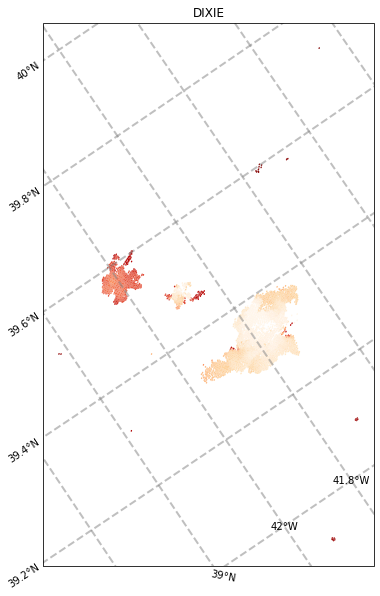

DIXIE E9DB628D-DFB7-4C85-BCD6-1254574D946B
DIXIE


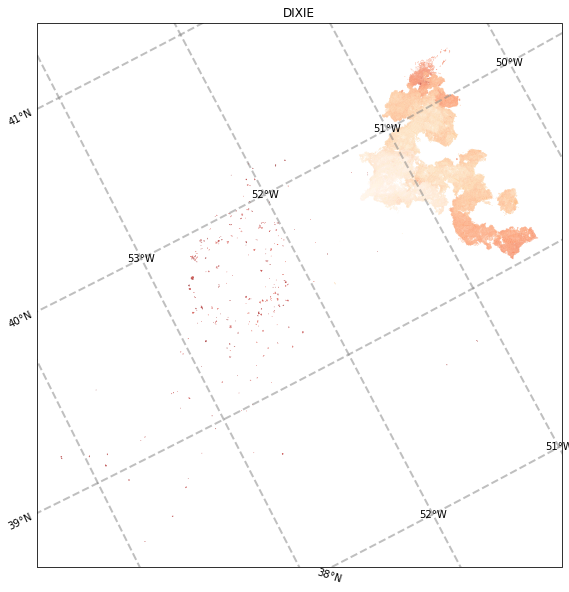

BOOTLEG 0BA1C51B-1EEF-4081-BB65-76EC999F95C6
BOOTLEG


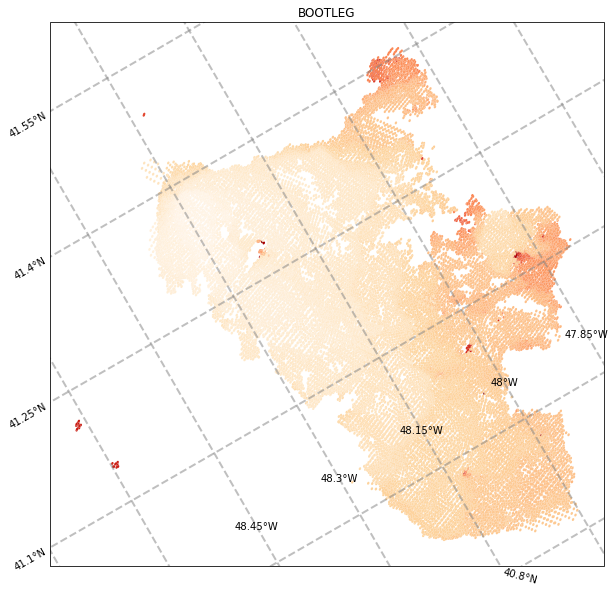

MONUMENT 9CF3A69A-A888-4BCD-AA7A-703D75D47E78
MONUMENT


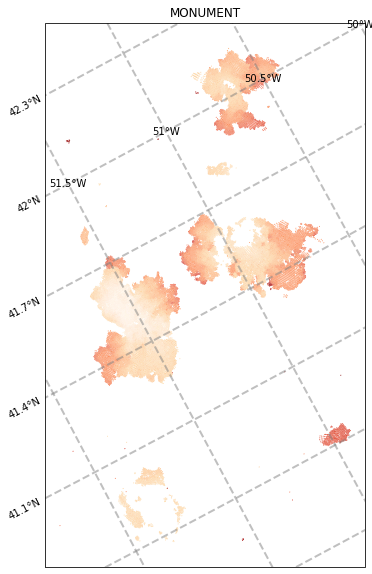

CALDOR E6C053C8-A346-43FB-9C29-632BC7536717
CALDOR


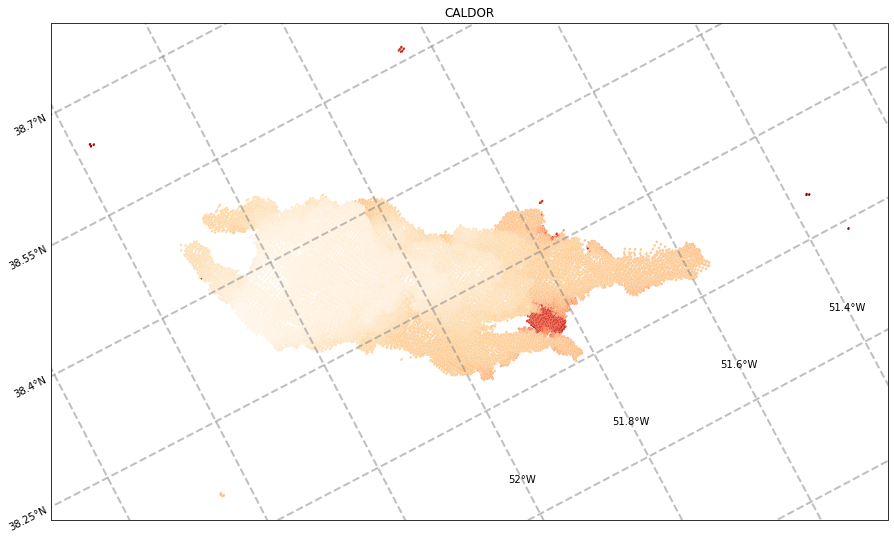

RIVER COMPLEX 0B29DF1A-7790-44CB-B735-ABDEAE0615CC
RIVER COMPLEX


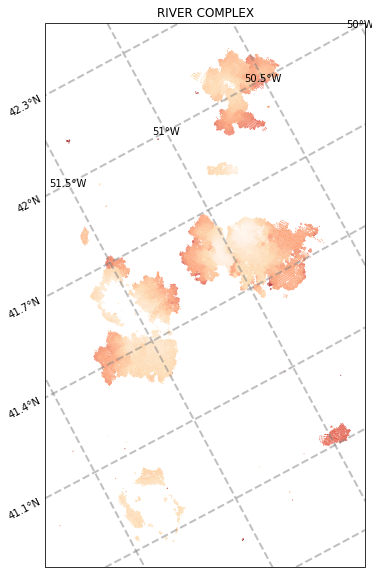

RICHARD SPRING 817720DD-B015-46D6-8DB2-2EE2210BAD14
RICHARD SPRING


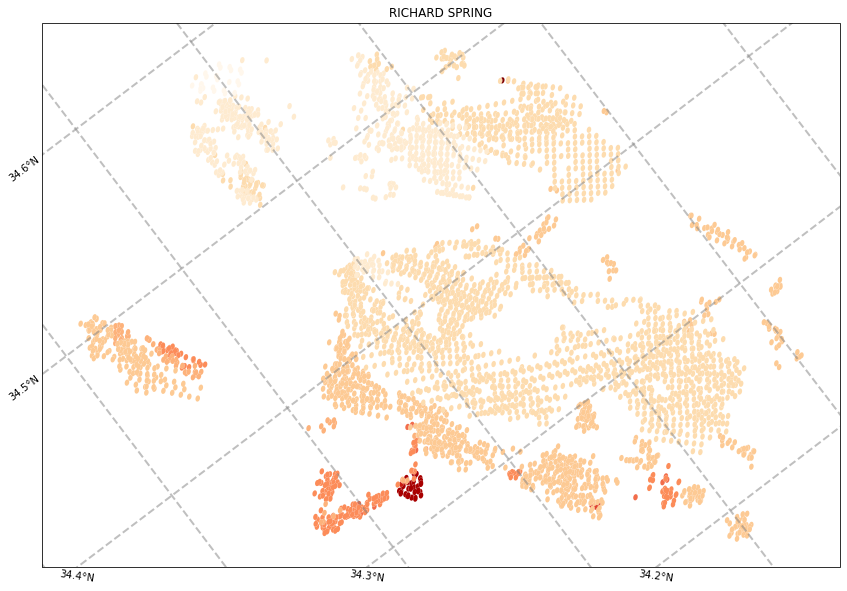

ANTELOPE 4098977E-B34D-40C3-8F34-2B913217503A
ANTELOPE


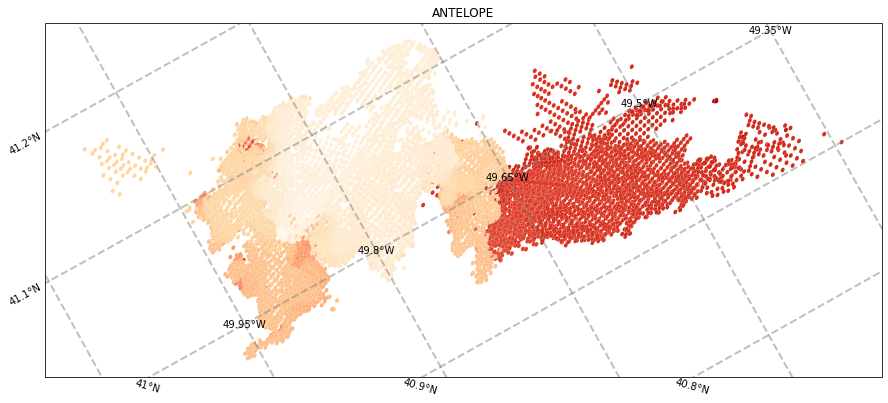

MCFARLAND 938686BB-0F52-47B2-B077-EB307941D939
MCFARLAND


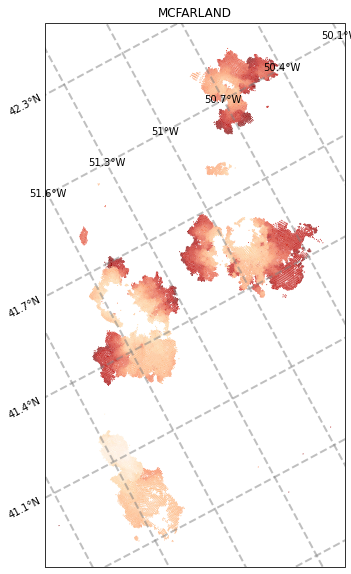

In [59]:
fire_names = ['DIXIE','BOOTLEG','MONUMENT','CALDOR','RIVER COMPLEX','TELEGRAPH','RICHARD SPRING','ANTELOPE',
              'MCFARLAND']
for name in fire_names:
    for i_d in np.unique(polygons_2021['irwinID'][polygons_2021['Fire Name']==name]):
        print(name, i_d)
        
        fire_plot = polygons_2021[polygons_2021['irwinID']==i_d].reset_index(drop=True)
        
        print(fire_plot['Fire Name'].loc[0])
        fig = plt.figure(figsize=(15,10))
        ax= fig.add_subplot(111,projection=ccrs.LambertConformal())
        #ax.set_extent([-54.6, -55, 38.4,38.75])
        fire_plot.plot(column='Current Day', cmap='OrRd',ax=ax)#, legend=True)
        gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,\
            linewidth=2, color='gray', alpha=0.5, linestyle='--')
        gl.top_labels = False
        gl.right_labels = False
        plt.title(fire_plot['Fire Name'].loc[0])
        plt.show()

                                irwinID  \
0  00295066-E99F-4F61-8FDC-DC06A97F7B52   

                                            geometry               Event_ID  \
0  POLYGON ((5554701.493 -285117.366, 5554769.062...  TX3385309829420211210   

  Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
0  ARROWHEAD   Wildfire  10023474     MTBS    Initial       6125     33.839   

   ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
0  ...  802803720220103     None         26         44     -970        -150   

   Low_T  Mod_T  High_T  Comment  
0     85   9999    9999     None  

[1 rows x 23 columns]
                                irwinID  \
1  008D427F-CB87-4556-9418-BA8C2C34E65A   

                                            geometry               Event_ID  \
1  POLYGON ((5773345.042 -2756.469, 5773414.076 -...  OK3636009629420210304   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
1  BOAR CREEK   W

                                 irwinID  \
16  1A6EF06F-0508-42FE-B365-85850E42EBCC   

                                             geometry               Event_ID  \
16  POLYGON ((4402639.331 833207.650, 4402638.393 ...  UT4113611287920210330   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
16        TTU   Wildfire  10021889     MTBS    Initial       5880     41.119   

    ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
16  ...  A12TUL20210410_30m     None         21         15     -970   

    IncGreen_T  Low_T  Mod_T  High_T  Comment  
16        -150     50   9999    9999     None  

[1 rows x 23 columns]
                                 irwinID  \
17  1CEA5A61-E3F4-41F7-9487-EAA93FFD5450   

                                             geometry               Event_ID  \
17  POLYGON ((5067399.828 1136463.510, 5067421.020...  MT4526010618620210809   

     Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
17  HO

                                 irwinID  \
28  260CD6FC-B2B8-4D8F-B36B-0BDD4983E247   

                                             geometry               Event_ID  \
28  POLYGON ((5948638.623 -196146.274, 5948639.451...  AR3484009439320211212   

      Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
28  STATE LINE 3   Wildfire  10023425     MTBS    Initial        777   

   BurnBndLat  ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv  \
28     34.835  ...  A15SUU20211222_30m     None          0         20   

   NoData_T  IncGreen_T  Low_T  Mod_T  High_T  Comment  
28     -970        -150     35   9999    9999     None  

[1 rows x 23 columns]
                                 irwinID  \
29  282B0245-9B06-4955-B108-321249875C5D   

                                             geometry               Event_ID  \
29  POLYGON ((7346481.198 275353.069, 7346459.577 ...  VA3791307945220210430   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnB

                                 irwinID  \
41  2EF73F92-8DFC-4533-97C3-B0456450C73E   

                                             geometry               Event_ID  \
41  MULTIPOLYGON (((4798851.966 -212651.119, 47990...  NM3340210587120210426   

      Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
41  THREE RIVERS   Wildfire  10023761     MTBS    Initial       6200   

   BurnBndLat  ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv  \
41     33.419  ...  A13SDT20210508_30m     None          1         39   

   NoData_T  IncGreen_T  Low_T  Mod_T  High_T  \
41     -970        -150     84    423     752   

                                              Comment  
41  Snow on the ground, at the time of ignition da...  

[1 rows x 23 columns]
                                 irwinID  \
42  3238849B-BD88-4BD6-A65F-B4D67A0A39BE   

                                             geometry               Event_ID  \
42  POLYGON ((5802136.547 32574.392, 5802136.451 3...  

                                 irwinID  \
53  3E829C9B-5950-446C-8494-717F0AD020B0   

                                             geometry               Event_ID  \
53  POLYGON ((4234356.376 1047846.663, 4234364.919...  ID4232511556420210703   

      Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
53  INSIDE LAKES   Wildfire  10021864     MTBS    Initial       2354   

   BurnBndLat  ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv  \
53     42.323  ...  A11TPG20210712_30m     None          7          8   

   NoData_T  IncGreen_T  Low_T  Mod_T  High_T  Comment  
53     -970        -150     40   9999    9999     None  

[1 rows x 23 columns]
                                 irwinID  \
54  3FA55611-FC76-40A9-A2BC-E1A0DA93AF04   

                                             geometry               Event_ID  \
54  POLYGON ((4342535.879 -162035.551, 4342548.469...  AZ3286511020120210610   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnB

                                 irwinID  \
65  46F2AEC9-0D36-48AE-B10C-6F921C3A13CA   

                                             geometry               Event_ID  \
65  POLYGON ((7436544.921 -1179573.149, 7436527.34...  FL2607308114920210531   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
65   AIRPLANE   Wildfire  10022090     MTBS    Initial       1147     26.081   

    ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
65  ...  801504220210630     None         73         18     -970        -150   

    Low_T  Mod_T  High_T  Comment  
65    100    350    9999     None  

[1 rows x 23 columns]
                                 irwinID  \
66  47659E60-326D-48A4-AA71-9BD0D4087EBF   

                                             geometry               Event_ID  \
66  POLYGON ((4286718.328 1054096.828, 4286851.970...  ID4253711500720210703   

          Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
66  CAS

                                 irwinID  \
78  4FA992F7-89B7-47F0-9F20-9003012D4331   

                                             geometry               Event_ID  \
78  POLYGON ((5853454.277 1432213.961, 5853547.552...  MN4888009658020211005   

      Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
78  BEACHES LAKE   Wildfire  10022652     MTBS    Initial       1952   

   BurnBndLat  ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv  \
78     48.897  ...  B14UPV20211007_30m     None          1         26   

   NoData_T  IncGreen_T  Low_T  Mod_T  High_T  Comment  
78     -970        -150     45   9999    9999     None  

[1 rows x 23 columns]
                                 irwinID  \
79  501A5999-20E4-4D66-B5FE-821652468FD3   

                                             geometry               Event_ID  \
79  POLYGON ((5585390.368 219628.848, 5585425.970 ...  KS3814709852820210407   

         Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc

                                 irwinID  \
91  5E81D8CF-317C-44A4-BDD7-E84EE627771C   

                                             geometry               Event_ID  \
91  POLYGON ((4472976.094 795317.702, 4472970.995 ...  UT4097711195620210910   

   Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
91     LEGACY   Wildfire  10021884     MTBS    Initial       1565     40.984   

    ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
91  ...  A12TVL20210917_30m     None          6         11     -970   

    IncGreen_T  Low_T  Mod_T  High_T  Comment  
91        -150     50   9999    9999     None  

[1 rows x 23 columns]
                                 irwinID  \
92  5F3C24E4-05E9-41DF-BBC4-BA57ADF1A2C0   

                                             geometry               Event_ID  \
92  POLYGON ((7520067.111 -1211340.301, 7520072.96...  FL2571108047920210530   

        Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
92 

                                  irwinID  \
104  701005F8-73FD-466F-8515-A56FAF7DB546   

                                              geometry               Event_ID  \
104  POLYGON ((4171806.167 401927.910, 4171790.290 ...  AZ3697411369720210713   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
104       LIME   Wildfire  10021902     MTBS    Initial       2357     36.954   

     ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
104  ...  B11SQA20210714_30m     None         -8         10     -970   

     IncGreen_T  Low_T  Mod_T  High_T  Comment  
104        -150     35   9999    9999     None  

[1 rows x 23 columns]
                                  irwinID  \
105  7066A8A7-A1B6-4EBE-84E2-24387B4906A0   

                                              geometry               Event_ID  \
105  POLYGON ((4880632.147 26265.610, 4880633.352 2...  NM3553410550120210509   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBn

                                  irwinID  \
117  7E9BE942-1E0A-4350-9650-F71A3D17EB10   

                                              geometry               Event_ID  \
117  POLYGON ((3673250.295 438694.246, 3673240.903 ...  CA3568711855020210818   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
117     FRENCH   Wildfire  10022046     MTBS   Extended      27330     35.696   

     ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
117  ...  804203520220614     None        -15         36     -970        -150   

     Low_T  Mod_T  High_T  Comment  
117     60    276     525     None  

[1 rows x 23 columns]
                                  irwinID  \
118  803B37D5-3CDD-49C6-9B5A-75E8281FA188   

                                              geometry               Event_ID  \
118  POLYGON ((5658107.119 -221978.206, 5658151.161...  OK3441309727820210304   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc Bu

                                  irwinID  \
129  90489F3B-FCAB-4086-8E55-BF44FA28D0BD   

                                              geometry               Event_ID  \
129  POLYGON ((4441980.228 -121993.004, 4441970.026...  AZ3345510938920210616   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
129       BEAR   Wildfire  10023771     MTBS    Initial      24464      33.48   

     ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
129  ...  A12SXC20210710_30m     None        -22         24     -970   

     IncGreen_T  Low_T  Mod_T  High_T  Comment  
129        -150     40    380     620     None  

[1 rows x 23 columns]
                                  irwinID  \
130  911C48CB-4721-4642-9C3C-895389070EBF   

                                              geometry               Event_ID  \
130  POLYGON ((5594078.117 -238435.659, 5594077.178...  OK3429509789820210319   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBn

                                  irwinID  \
142  9FF7CCAB-238B-49E8-A3FB-698DBD8E74A6   

                                              geometry               Event_ID  \
142  POLYGON ((4340972.102 1279537.831, 4340963.138...  ID4453211532920210810   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
142   BOUNDARY   Wildfire  10022526     MTBS   Extended      98005     44.597   

     ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
142  ...  804102920220725     None         24         28     -970        -150   

     Low_T  Mod_T  High_T  Comment  
142     50    270     520     None  

[1 rows x 23 columns]
                                  irwinID  \
143  A0A9789D-7AC2-4784-8AD3-B348CF5E64DD   

                                              geometry               Event_ID  \
143  MULTIPOLYGON (((4181250.656 1835779.692, 41812...  WA4855212019420210716   

      Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc 

                                  irwinID  \
154  A92932FB-9F0D-47E6-9B25-83B4CA3A1442   

                                              geometry               Event_ID  \
154  POLYGON ((7385636.290 -979565.494, 7385634.340...  FL2768708126520210126   

       Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
154  AREA 6 NORTH   Wildfire  10021754     MTBS    Initial       3276   

    BurnBndLat  ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv  \
154     27.683  ...  B17RML20210202_30m     None         91         25   

    NoData_T  IncGreen_T  Low_T  Mod_T  High_T  Comment  
154     -970        -150    150   9999    9999     None  

[1 rows x 23 columns]
                                  irwinID  \
155  AA982C59-F792-432C-891D-AFDD652CE7C0   

                                              geometry               Event_ID  \
155  POLYGON ((5227384.436 798201.043, 5227309.599 ...  NE4258910342620210913   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  

                                  irwinID  \
167  BA34B783-AB1A-4638-8B48-45236E30AD9F   

                                              geometry               Event_ID  \
167  POLYGON ((7414233.795 -64480.357, 7414367.497 ...  NC3496007948020210502   

             Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
167  SLATES CHURCH FIRE   Wildfire  10021847     MTBS    Initial       1824   

    BurnBndLat  ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv  \
167     34.972  ...  B17SPU20210523_30m     None         36         22   

    NoData_T  IncGreen_T  Low_T  Mod_T  High_T  Comment  
167     -970        -150     40   9999    9999     None  

[1 rows x 23 columns]
                                  irwinID  \
168  BB5FAB97-A332-401D-ABE9-FFB8536426B0   

                                              geometry               Event_ID  \
168  POLYGON ((4293626.268 1705095.243, 4293697.793...  WA4791211798620210721   

    Incid_Name Incid_Type    Map_ID Map_Prog 

                                  irwinID  \
179  C63FC371-BC70-4615-841B-B0838C21064F   

                                              geometry               Event_ID  \
179  MULTIPOLYGON (((5014994.971 527460.953, 501511...  CO3995610523120211230   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
179   MARSHALL   Wildfire  10023606     MTBS    Initial       6274     39.958   

     ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
179  ...  A13TDE20220314_30m     None         -4         37     -970   

     IncGreen_T  Low_T  Mod_T  High_T  Comment  
179        -150     31   9999    9999     None  

[1 rows x 23 columns]
                                  irwinID  \
180  C897370B-98B6-4F8F-BD7E-0B9D413AF312   

                                              geometry               Event_ID  \
180  MULTIPOLYGON (((5830661.319 296974.838, 583060...  KS3892309594020210305   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBn

                                  irwinID  \
191  D7A8FCA8-3B32-4C53-8663-AD17EAB86087   

                                              geometry               Event_ID  \
191  POLYGON ((5109655.380 135850.806, 5109654.779 ...  NM3678810339520210507   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
191  SKILES 57   Wildfire  10023567     MTBS    Initial       2651     36.807   

     ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
191  ...  A13SFA20210515_30m     None         -6          8     -970   

     IncGreen_T  Low_T  Mod_T  High_T  Comment  
191        -150     20   9999    9999     None  

[1 rows x 23 columns]
                                  irwinID  \
192  D7B2E306-9501-4C37-AFA0-47CEC0204326   

                                              geometry               Event_ID  \
192  POLYGON ((4485008.607 1455843.607, 4484963.448...  ID4645911452820210707   

      Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  Burn

                                  irwinID  \
205  E8E83861-AC2F-4E78-A5D8-EE8A22AC5975   

                                              geometry               Event_ID  \
205  POLYGON ((4176026.630 910472.116, 4176045.017 ...  NV4099311562120210622   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
205       HUFF   Wildfire  10021897     MTBS    Initial       1554     41.018   

     ...             Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
205  ...  B11TPF20210627_30m     None         18          9     -970   

     IncGreen_T  Low_T  Mod_T  High_T  Comment  
205        -150     50    355    9999     None  

[1 rows x 23 columns]
                                  irwinID  \
206  E9D23D84-C04E-446C-BFC0-62F67153DD0B   

                                              geometry               Event_ID  \
206  POLYGON ((4462501.081 1007571.042, 4462501.594...  ID4268511284420210614   

     Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnB

                                  irwinID  \
217  F1ECB7CA-B4BB-40D3-B299-374C7195ED30   

                                              geometry               Event_ID  \
217  POLYGON ((4238565.494 -322224.420, 4238589.417...  AZ3140011075320210610   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
217   SHAMROCK   Wildfire  10023744     MTBS    Initial       1084     31.403   

     ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  \
217  ...  803503820210712     None         20         28     -970        -150   

     Low_T  Mod_T  High_T                                            Comment  
217     40   9999    9999  803503820210626_REFL.tif used as perimeter image.  

[1 rows x 23 columns]
                                  irwinID  \
218  F23488CA-FF3B-41BA-8FFA-B7FAF10F3512   

                                              geometry               Event_ID  \
218  POLYGON ((5310385.119 1304005.267, 5310378.513...  ND471321036

                                  irwinID  \
229  FE477303-0699-4C04-B951-3291CE248A07   

                                              geometry               Event_ID  \
229  POLYGON ((3962530.950 357662.597, 3962530.265 ...  NV3599911559820210610   

       Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
229  SANDY VALLEY   Wildfire  10021922     MTBS    Initial       1082   

    BurnBndLat  ...          Post_ID Perim_ID dNBR_offst dNBR_stdDv NoData_T  \
229     35.989  ...  804003520210613     None          7          8     -970   

     IncGreen_T  Low_T  Mod_T  High_T  Comment  
229        -150     30    170     305     None  

[1 rows x 23 columns]
                                  irwinID  \
230  FE54A69C-8DFA-439E-8D49-02B6E3C4C392   

                                              geometry               Event_ID  \
230  POLYGON ((7287266.643 77465.960, 7287275.619 7...  NC3634008046020211127   

     Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnB

# Combine Overpasses to Daily

In [43]:
daily_2019 = combine_per_overpass_polygons_to_daily('ClippedFires', 12,2019)
print(daily_2019.head())
daily_2019.to_file('ClippedFires2019_VIIRS_daily_12Z_Day_Start.geojson', driver='GeoJSON')

['2019-07-13', '2019-07-30', '2019-07-31', '2019-07-31', '2019-08-01', '2019-08-01', '2019-08-01', '2019-08-02', '2019-08-03', '2019-08-03', '2019-08-03', '2019-08-04', '2019-08-04', '2019-08-04', '2019-08-05', '2019-08-06', '2019-08-06', '2019-08-07', '2019-08-12', '2019-08-13', '2019-08-13', '2019-08-14', '2019-08-14', '2019-08-15', '2019-08-15', '2019-08-16', '2019-08-16', '2019-08-17', '2019-08-17', '2019-08-18', '2019-08-18', '2019-08-19', '2019-08-19', '2019-08-20', '2019-08-20', '2019-08-21', '2019-08-23', '2019-08-24', '2019-08-24', '2019-08-25', '2019-08-27', '2019-08-27', '2019-08-27', '2019-08-28', '2019-08-28', '2019-08-29', '2019-08-31', '2019-09-01', '2019-09-02', '2019-09-03', '2019-09-03', '2019-09-03', '2019-09-04', '2019-09-04', '2019-10-26', '2019-10-27', '2019-08-14', '2019-08-16', '2019-08-18', '2019-08-19', '2019-08-19', '2019-08-19', '2019-08-20', '2019-08-20', '2019-08-21', '2019-08-02', '2019-08-03', '2019-08-04', '2019-09-03', '2019-09-04', '2019-09-04', '2019

6 seconds
    Local Day                               irwinID  \
0  2019-06-30  659B5E49-52DE-4A6B-9EC6-CD2F0D095DC8   
1  2019-07-01  659B5E49-52DE-4A6B-9EC6-CD2F0D095DC8   
2  2019-07-01  DA8CDABD-08AB-4B08-A5EA-8EF196936471   
3  2019-07-02  A887CF9D-CB2F-4CC8-9499-79730B6F8FF7   
4  2019-07-02  DA8CDABD-08AB-4B08-A5EA-8EF196936471   

                                            geometry  Incident Number  \
0  MULTIPOLYGON (((4435839.139 1444154.440, 44358...       10773154.0   
1  POLYGON ((4436538.655 1443945.710, 4436531.131...       10773154.0   
2  POLYGON ((4522587.913 -175495.883, 4522581.900...       10677416.0   
3  POLYGON ((4763518.699 127981.819, 4763513.091 ...       10669846.0   
4  POLYGON ((4522218.588 -175249.566, 4522212.330...       10677416.0   

     Fire Name Current Day  Current Overpass   Lat Fire    Lon Fire  \
0  BARREN HILL  2019-07-01             818.0  46.236833 -114.982833   
1  BARREN HILL  2019-07-02             941.0  46.236833 -114.982833   
2      

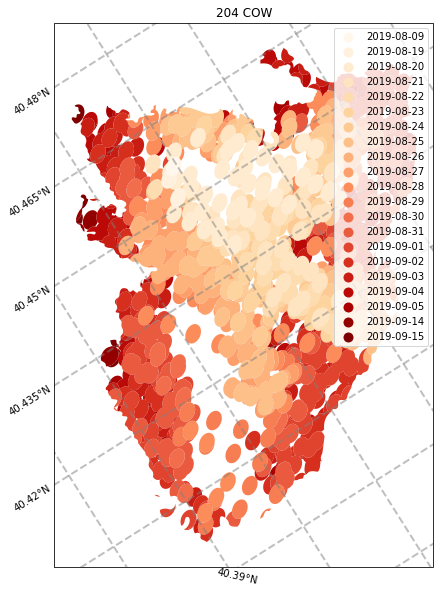

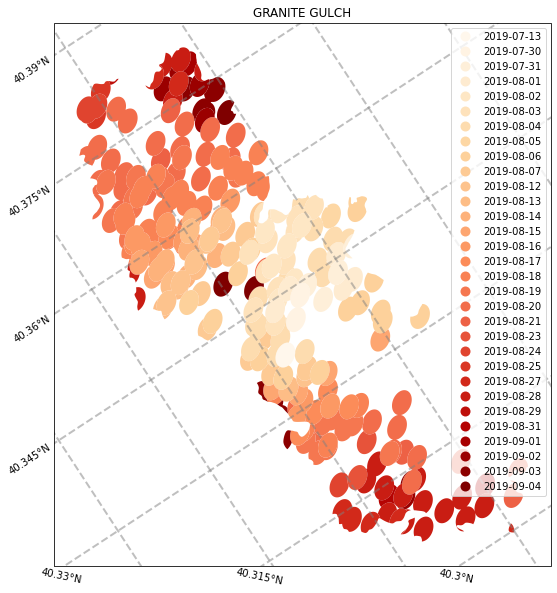

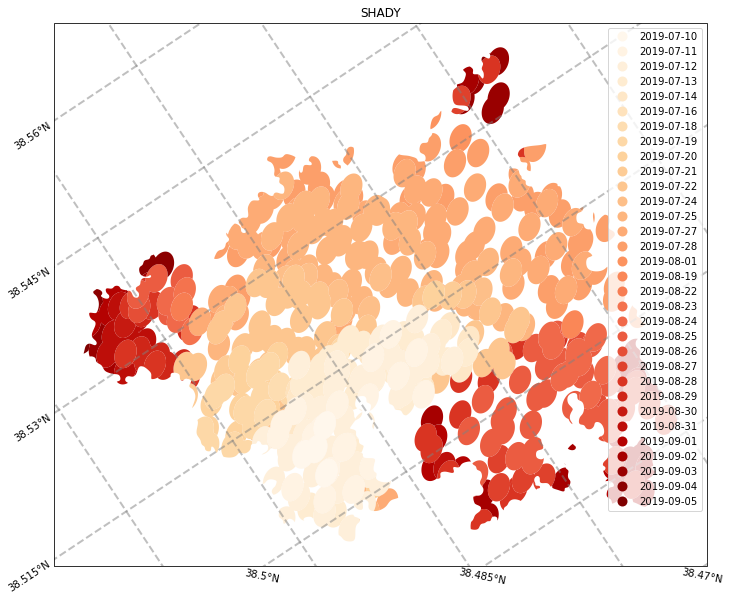

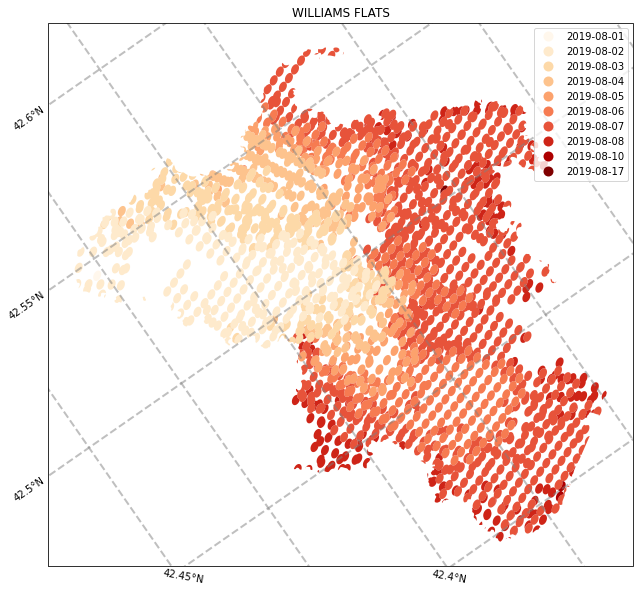

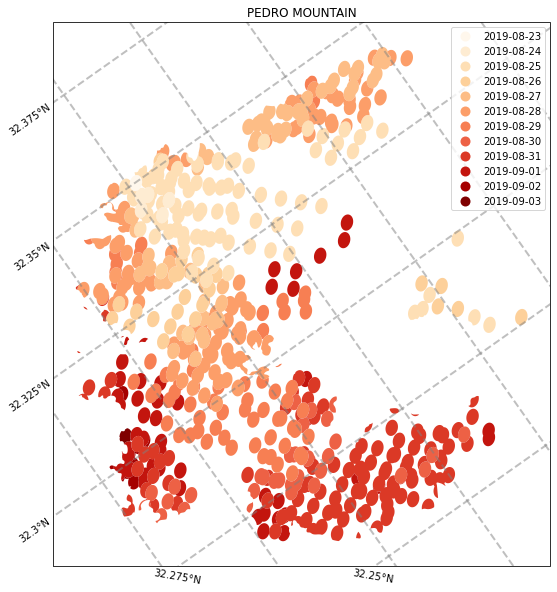

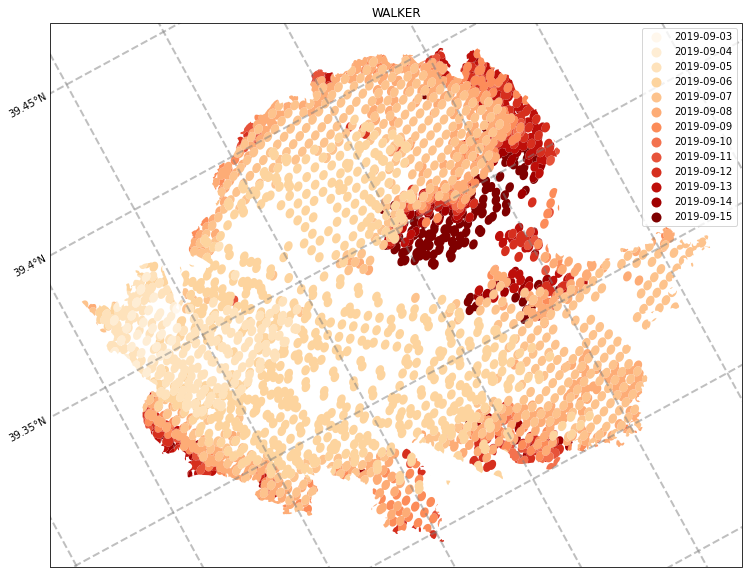

In [51]:
"""print(daily_2019.columns)
print(daily_2019.head())"""

fire_names = ['204 COW', 'GRANITE GULCH', 'SHADY','WILLIAMS FLATS', 'PEDRO MOUNTAIN','WALKER']

for name in fire_names:
    fire_plot = daily_2019[daily_2019['Fire Name']==name].reset_index(drop=True)
    fig = plt.figure(figsize=(15,10))
    ax= fig.add_subplot(111,projection=ccrs.LambertConformal())
    #ax.set_extent([-54.6, -55, 38.4,38.75])
    fire_plot.plot(column='Local Day', cmap='OrRd',ax=ax, legend=True)
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,\
            linewidth=2, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    plt.title(name)
    plt.show()    

In [52]:
daily_2020= combine_per_overpass_polygons_to_daily('ClippedFires', 12,2020)
print(daily_2020.head())
daily_2020.to_file('ClippedFires2020_VIIRS_daily_12Z_Day_Start.geojson', driver='GeoJSON')

['2020-09-07', '2020-09-07', '2020-09-07', '2020-09-07', '2020-09-08', '2020-09-08', '2020-09-08', '2020-09-08', '2020-09-08', '2020-09-08', '2020-09-08', '2020-09-09', '2020-09-09', '2020-09-09', '2020-09-09', '2020-09-09', '2020-09-09', '2020-09-10', '2020-09-10', '2020-09-10', '2020-09-10', '2020-09-10', '2020-09-10', '2020-09-10', '2020-09-11', '2020-09-11', '2020-09-11', '2020-09-11', '2020-09-11', '2020-09-11', '2020-09-12', '2020-09-12', '2020-09-12', '2020-09-12', '2020-09-12', '2020-09-12', '2020-09-13', '2020-09-14', '2020-09-14', '2020-09-14', '2020-09-14', '2020-09-15', '2020-09-15', '2020-09-15', '2020-09-15', '2020-09-15', '2020-09-16', '2020-09-16', '2020-09-16', '2020-09-16', '2020-09-16', '2020-09-17', '2020-09-17', '2020-09-17', '2020-09-19', '2020-09-20', '2020-09-20', '2020-08-20', '2020-08-21', '2020-08-24', '2020-08-24', '2020-08-24', '2020-08-25', '2020-08-25', '2020-08-25', '2020-08-25', '2020-08-26', '2020-08-26', '2020-08-26', '2020-08-26', '2020-08-27', '2020

1468 seconds
    Local Day                               irwinID  \
0  2020-07-01  3215B87E-97CC-4F60-A276-DE4120F4AB5B   
1  2020-07-01  3DE641EE-702E-4EF7-B274-F1B5F12A0506   
2  2020-07-02  3215B87E-97CC-4F60-A276-DE4120F4AB5B   
3  2020-07-02  44F1AEC6-36D9-410E-8A11-4EF5FD7FA781   
4  2020-07-03  2AD7C3F8-5CB0-480C-BCB1-2EC9FF77619D   

                                            geometry  Incident Number  \
0  POLYGON ((4483269.318 1121317.465, 4483262.228...       11751212.0   
1  MULTIPOLYGON (((3656615.741 399181.034, 365660...       11749823.0   
2  MULTIPOLYGON (((4483967.672 1121445.224, 44839...       11751212.0   
3  POLYGON ((4311866.641 1092907.563, 4311858.992...       11759379.0   
4  MULTIPOLYGON (((5223915.623 -525961.303, 52239...       11751160.0   

      Fire Name Current Day  Current Overpass   Lat Fire    Lon Fire  \
0     HOWE PEAK  2020-07-02             742.0  43.696430 -113.055300   
1          BENA  2020-07-02            1018.0  35.318333 -118.708333   
2

/home/lthapa/anaconda3/envs/ML_py/lib/python3.7/site-packages/geopandas/plotting.py:681: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


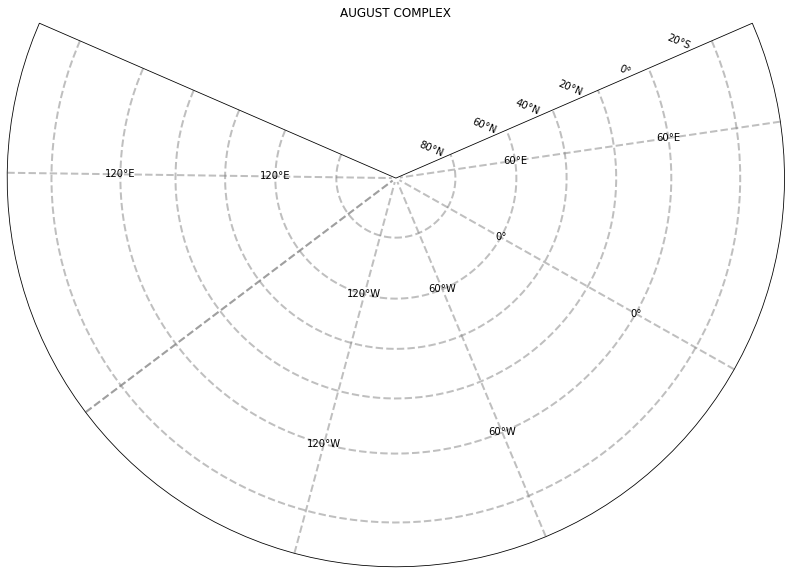

/home/lthapa/anaconda3/envs/ML_py/lib/python3.7/site-packages/geopandas/plotting.py:681: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


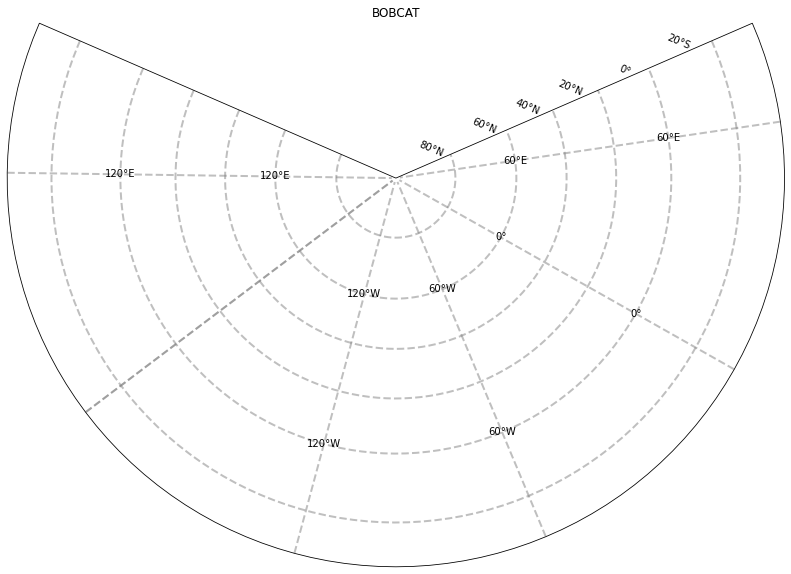

/home/lthapa/anaconda3/envs/ML_py/lib/python3.7/site-packages/geopandas/plotting.py:681: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


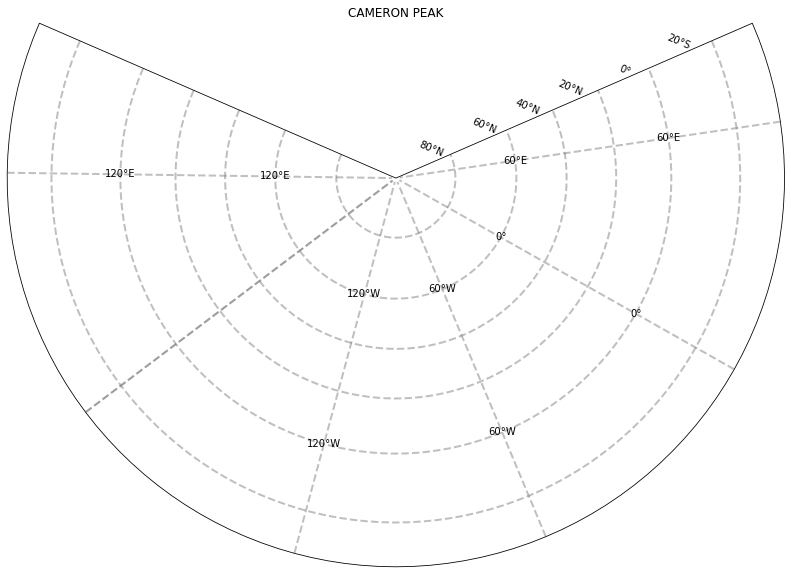

/home/lthapa/anaconda3/envs/ML_py/lib/python3.7/site-packages/geopandas/plotting.py:681: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


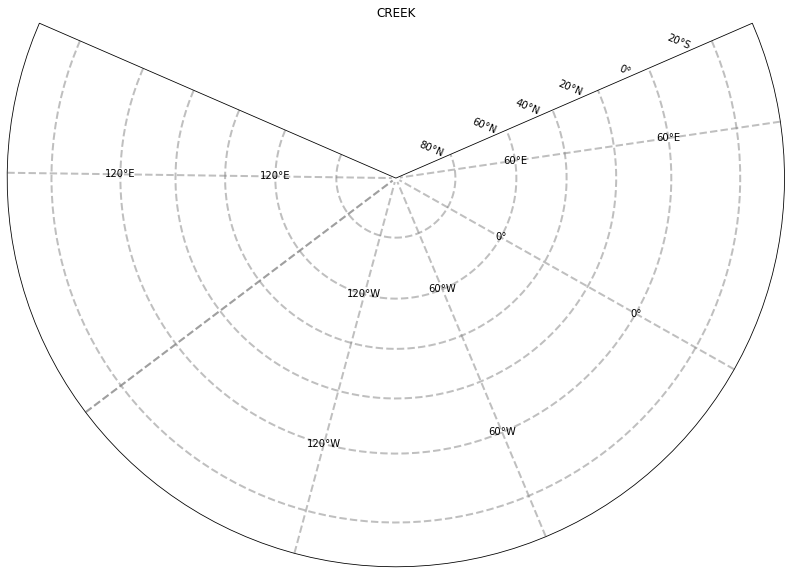

/home/lthapa/anaconda3/envs/ML_py/lib/python3.7/site-packages/geopandas/plotting.py:681: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


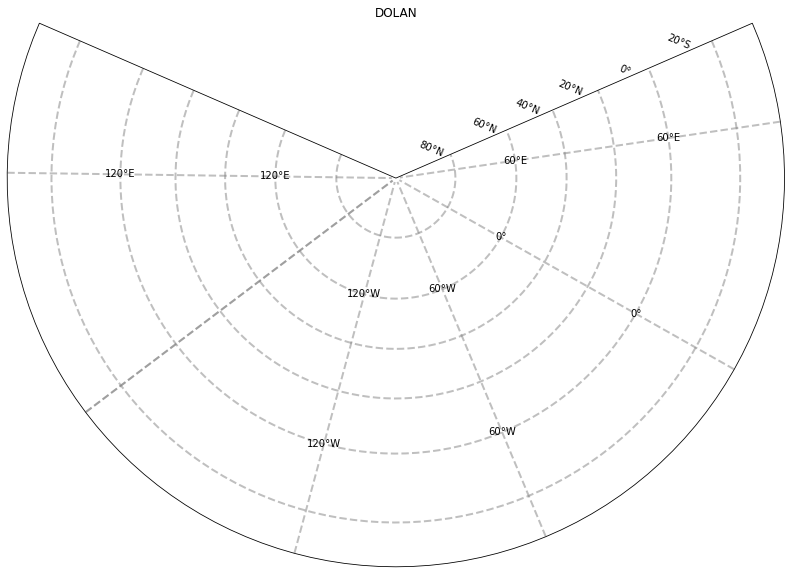

/home/lthapa/anaconda3/envs/ML_py/lib/python3.7/site-packages/geopandas/plotting.py:681: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


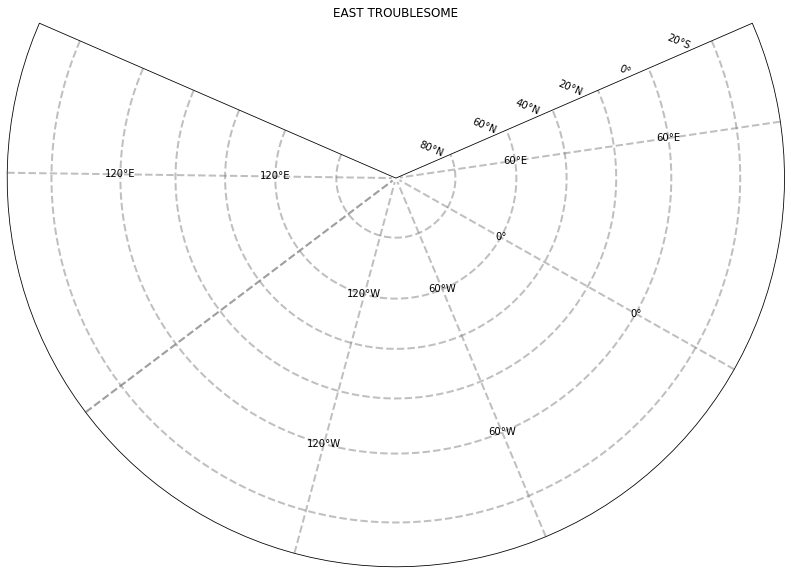

/home/lthapa/anaconda3/envs/ML_py/lib/python3.7/site-packages/geopandas/plotting.py:681: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


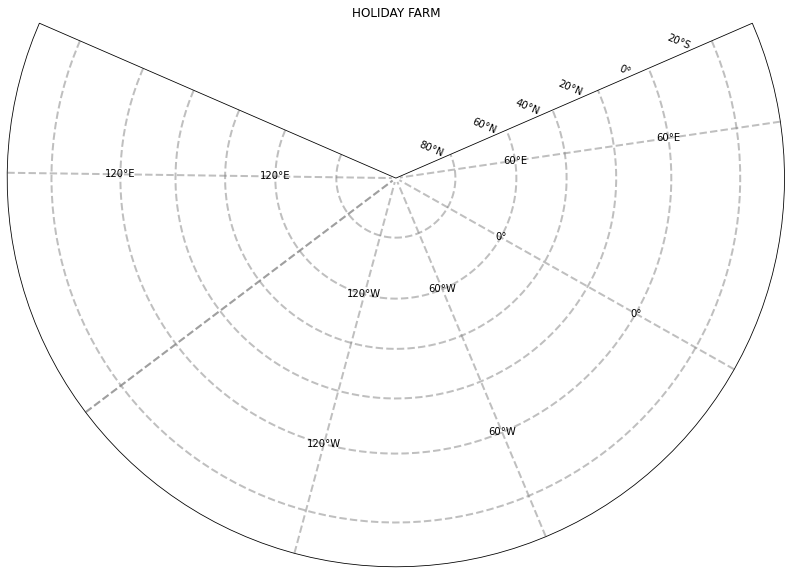

/home/lthapa/anaconda3/envs/ML_py/lib/python3.7/site-packages/geopandas/plotting.py:681: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


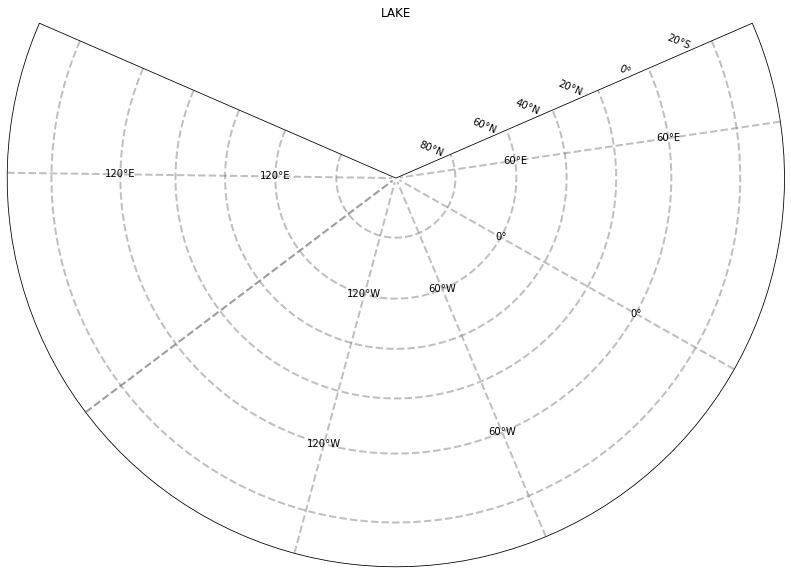

/home/lthapa/anaconda3/envs/ML_py/lib/python3.7/site-packages/geopandas/plotting.py:681: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


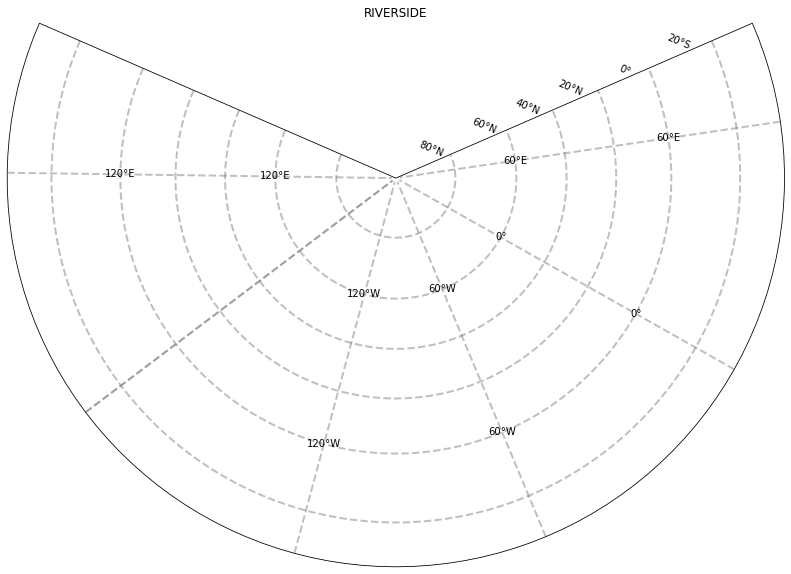

/home/lthapa/anaconda3/envs/ML_py/lib/python3.7/site-packages/geopandas/plotting.py:681: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


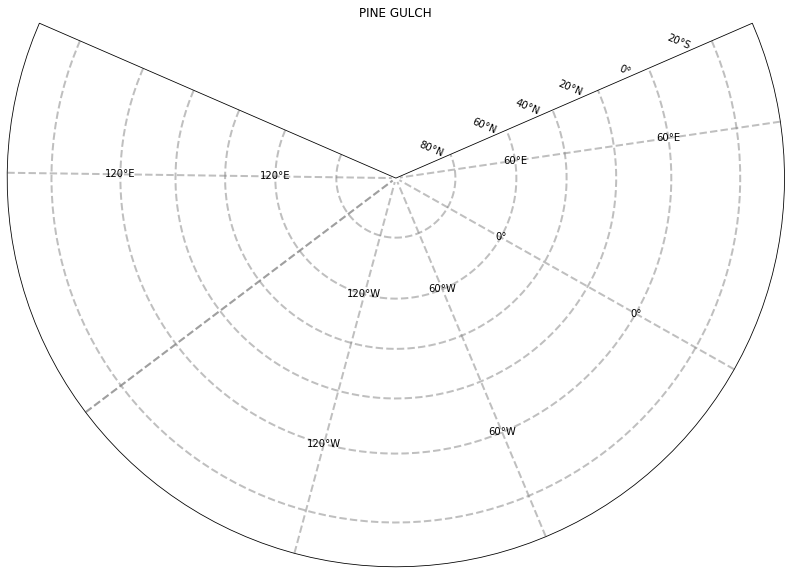

/home/lthapa/anaconda3/envs/ML_py/lib/python3.7/site-packages/geopandas/plotting.py:681: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


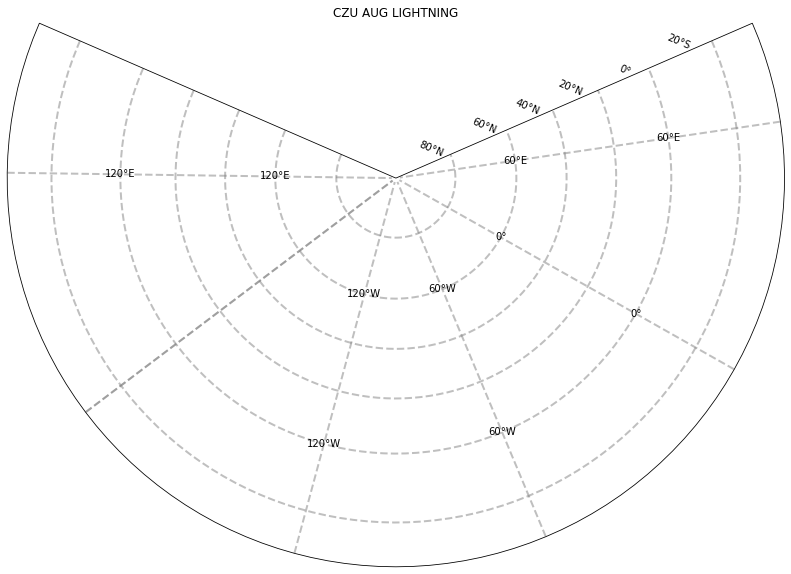

/home/lthapa/anaconda3/envs/ML_py/lib/python3.7/site-packages/geopandas/plotting.py:681: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


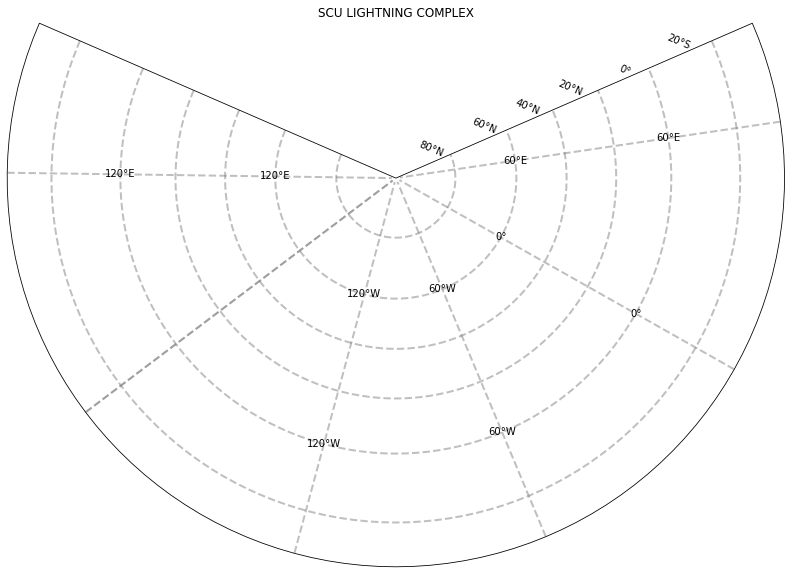

In [53]:
fire_names = ['AUGUST COMPLEX','BOBCAT', 'CAMERON PEAK','CREEK','DOLAN','EAST TROUBLESOME','HOLIDAY FARM','LAKE','RIVERSIDE',
              'PINE GULCH','CZU AUG LIGHTNING','SCU LIGHTNING COMPLEX']

for name in fire_names:
    fire_plot = daily_2019[daily_2019['Fire Name']==name].reset_index(drop=True)
    fig = plt.figure(figsize=(15,10))
    ax= fig.add_subplot(111,projection=ccrs.LambertConformal())
    #ax.set_extent([-54.6, -55, 38.4,38.75])
    fire_plot.plot(column='Local Day', cmap='OrRd',ax=ax, legend=True)
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,\
            linewidth=2, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    plt.title(name)
    plt.show()  

In [16]:
daily_2021= combine_per_overpass_polygons_to_daily('ClippedFires', 12,2021)
print(daily_2021.head())
daily_2021.to_file('ClippedFires2021_VIIRS_daily_12Z_Day_Start.geojson', driver='GeoJSON')

['2021-07-16', '2021-07-17', '2021-07-17', '2021-07-18', '2021-07-18', '2021-07-18', '2021-07-18', '2021-07-23', '2021-07-23', '2021-07-23', '2021-07-24', '2021-07-24', '2021-07-24', '2021-07-24', '2021-07-24', '2021-07-25', '2021-07-25', '2021-07-25', '2021-07-25', '2021-07-25', '2021-07-26', '2021-07-26', '2021-07-26', '2021-07-27', '2021-07-27', '2021-07-28', '2021-07-28', '2021-07-29', '2021-07-29', '2021-07-30', '2021-07-30', '2021-07-30', '2021-09-05', '2021-09-06', '2021-09-06', '2021-09-06', '2021-09-06', '2021-09-06', '2021-09-06', '2021-09-07', '2021-09-07', '2021-09-07', '2021-09-07', '2021-09-07', '2021-09-07', '2021-09-07', '2021-09-08', '2021-09-08', '2021-09-08', '2021-09-08', '2021-09-08', '2021-09-08', '2021-09-09', '2021-09-09', '2021-09-09', '2021-09-09', '2021-09-09', '2021-09-09', '2021-09-10', '2021-09-10', '2021-09-10', '2021-09-11', '2021-09-11', '2021-09-11', '2021-09-11', '2021-09-11', '2021-09-11', '2021-09-12', '2021-09-12', '2021-09-12', '2021-09-12', '2021

761 seconds
    Local Day                               irwinID  \
0  2021-07-02  3E829C9B-5950-446C-8494-717F0AD020B0   
1  2021-07-02  47659E60-326D-48A4-AA71-9BD0D4087EBF   
2  2021-07-02  F97524B0-26E2-4BE2-BA5B-0F417E42B54E   
3  2021-07-03  3E829C9B-5950-446C-8494-717F0AD020B0   
4  2021-07-03  47659E60-326D-48A4-AA71-9BD0D4087EBF   

                                            geometry  Incident Number  \
0  POLYGON ((4231968.663 1047022.283, 4231960.785...       12761368.0   
1  POLYGON ((4284793.757 1052745.534, 4284786.049...       12759412.0   
2  POLYGON ((5308905.820 1318356.167, 5308901.627...       12761451.0   
3  MULTIPOLYGON (((4230327.486 1046506.416, 42303...       12761368.0   
4  MULTIPOLYGON (((4281897.107 1048798.441, 42818...       12759412.0   

          Fire Name Current Day  Current Overpass   Lat Fire    Lon Fire  \
0      INSIDE LAKES  2021-07-03             730.0  42.324790 -115.563900   
1  CASTLEFORD BUTTE  2021-07-03             730.0  42.537480 -115.

In [20]:
print(len(np.unique(daily_2021['irwinID'])))

81


# Plot some daily polygons

## 2021

In [4]:
#daily_2021= combine_per_overpass_polygons_to_daily('AllFires', 12,2021)
daily_2021= gpd.read_file('./fire_polygons/ClippedFires2021_VIIRS_daily_12Z_Day_Start.geojson')


63
961


In [15]:
print(len(np.unique(daily_2021['irwinID'])))
print(np.unique(daily_2021['irwinID']))

print(daily_2021)

64
['05AB0B04-EEA1-4BAD-858A-D906AC3583DC'
 '07C75421-ED46-4D0C-90A7-9B89F6C80A9B'
 '087636DC-25DC-4309-A1F4-5A3B9A5141DF'
 '1CEA5A61-E3F4-41F7-9487-EAA93FFD5450'
 '236951C4-0149-4523-AE60-6AF68FD053D9'
 '25B910BE-5396-40F4-A8F5-AAA41F8667F8'
 '29AF1E94-C4C1-4BA6-9D2C-BFD34C446418'
 '2A29D213-FCA8-424C-A37B-4EA86B11156B'
 '3502EB16-012C-42FA-9531-B87897EEB494'
 '37DC75CB-32CA-4980-9AC4-E0FDBBB0738D'
 '3E829C9B-5950-446C-8494-717F0AD020B0'
 '4673F502-C5F9-49C7-B222-2A4828C4E296'
 '46E71AE7-7787-48B3-B584-9D63F43FA071'
 '47659E60-326D-48A4-AA71-9BD0D4087EBF'
 '4952EF9D-9038-4292-AE95-4994DA495618'
 '499D6545-2A19-458A-8C7C-554932C6B86E'
 '4B7E8BE5-E47E-4EF0-AE34-46FFB8BA7795'
 '4CF95306-CAF8-47BA-ADBE-52AACDFFFE5C'
 '52FEA762-2640-471F-B625-373D8B3C830D'
 '5E81D8CF-317C-44A4-BDD7-E84EE627771C'
 '63FFB3A1-2BC3-4E08-9C97-B17F9A05F22B'
 '6C637E6B-6609-45D0-BED7-C75756A63B05'
 '701005F8-73FD-466F-8515-A56FAF7DB546'
 '73BFB602-BC56-4F24-B382-213B86A75828'
 '751BAEA9-D0BC-43AF-AE3E-34CBFB05911

KeyboardInterrupt: 

CLUB


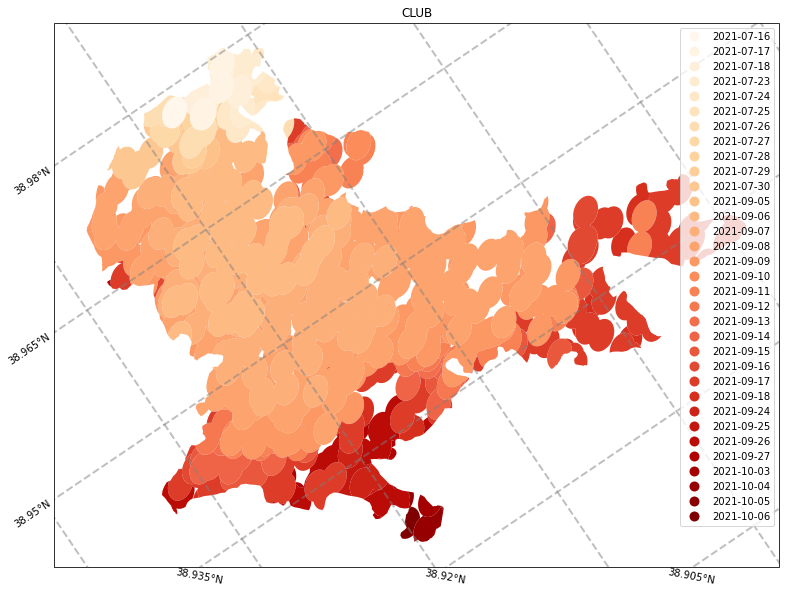

TRAIL CREEK


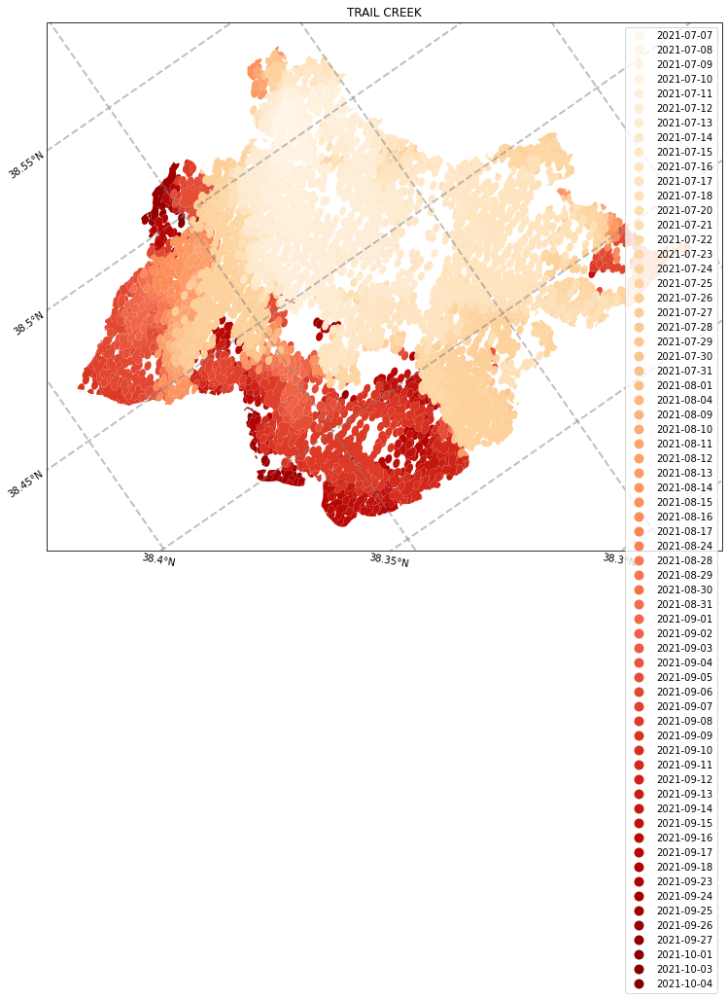

BULLDOG MOUNTAIN


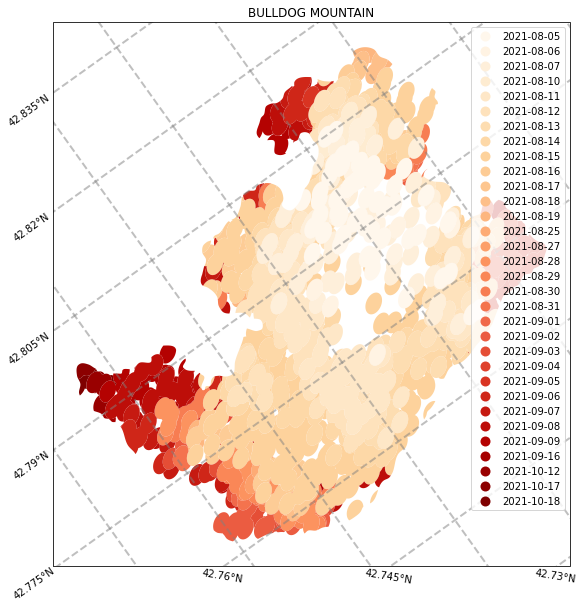

HORSE CREEK


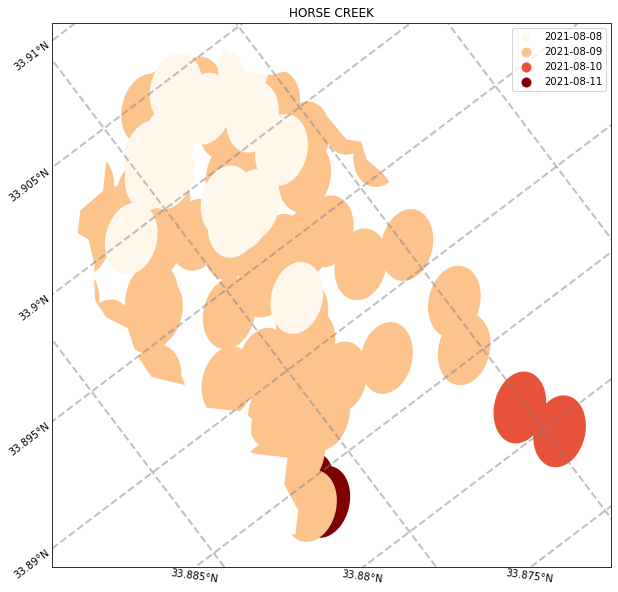

SILCOTT


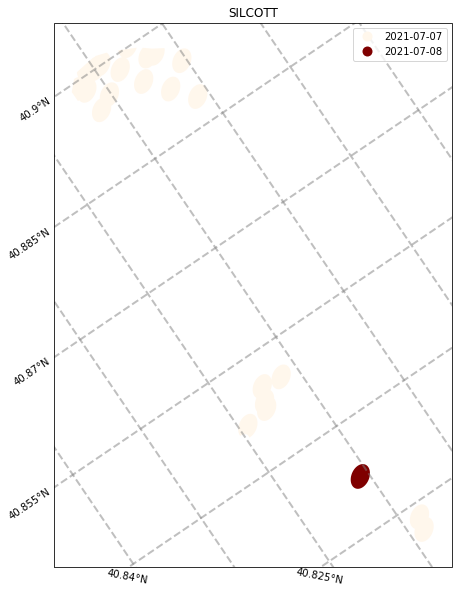

313


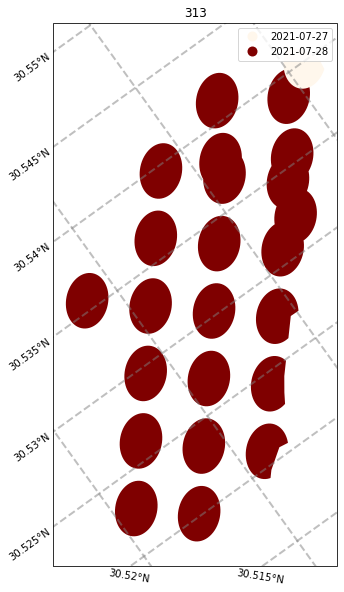

SOUTH MOCCASIN


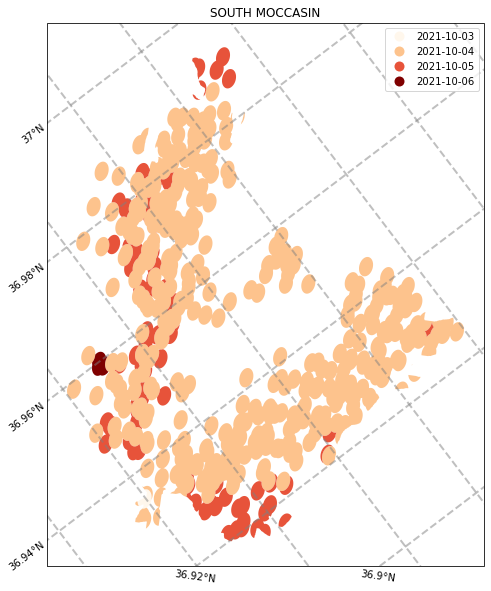

VINEGAR


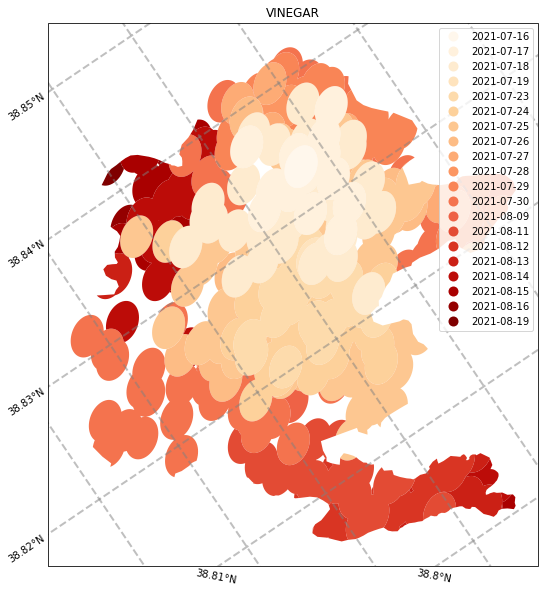

DIXIE


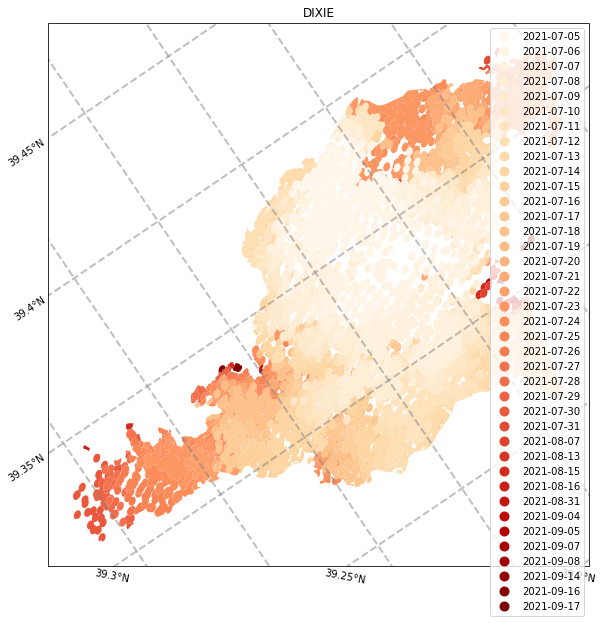

WHIPPLE CAMP


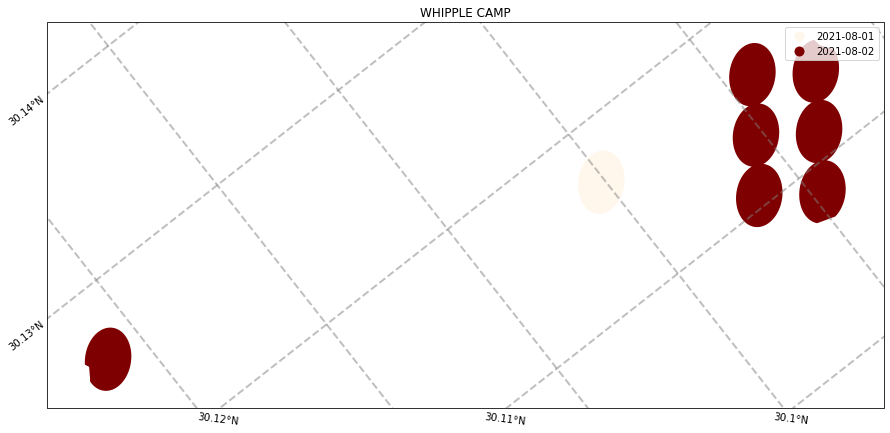

INSIDE LAKES


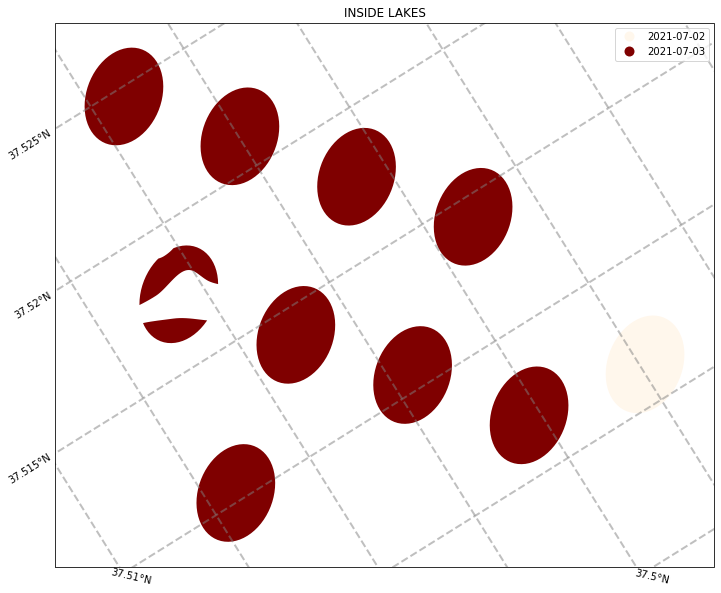

MACK MOUNTAIN


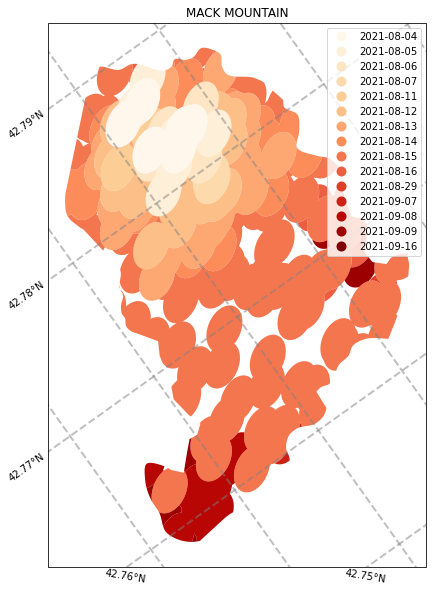

CEDAR CREEK


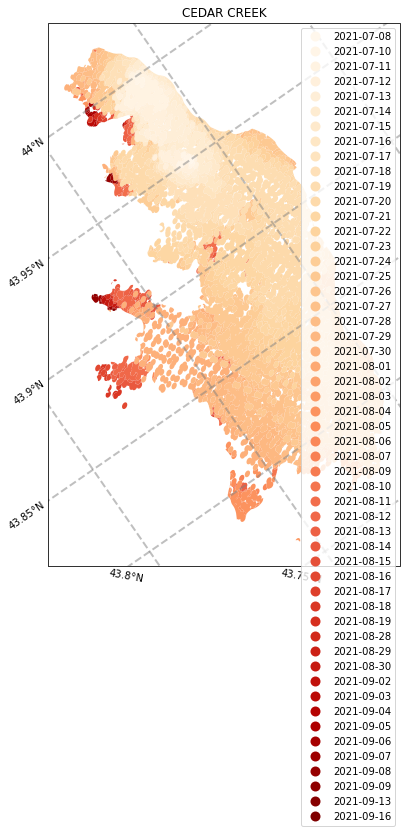

CASTLEFORD BUTTE


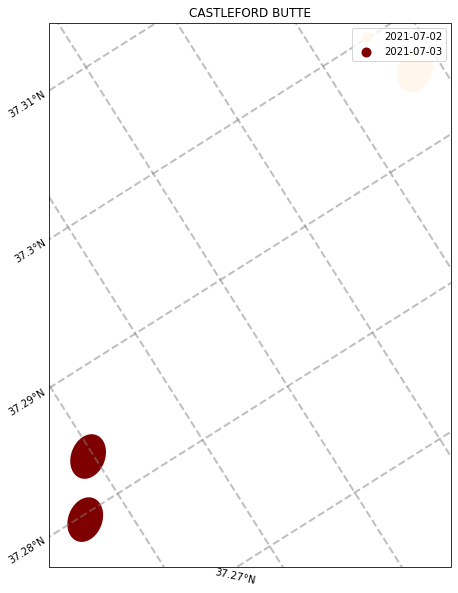

CHICKADEE CREEK


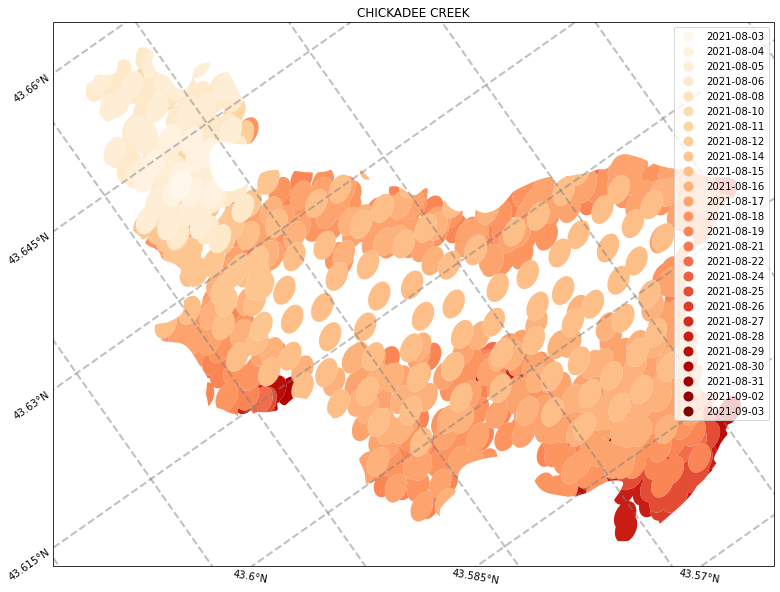

KNP COMPLEX


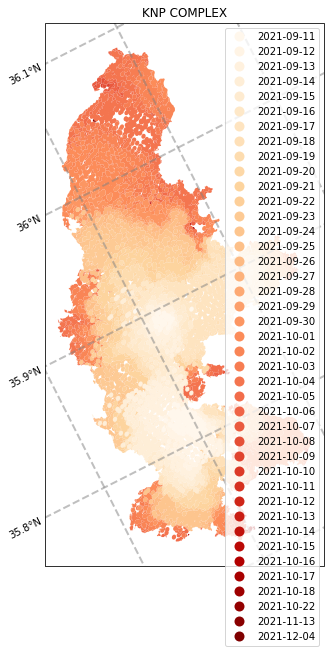

PARKER CREEK


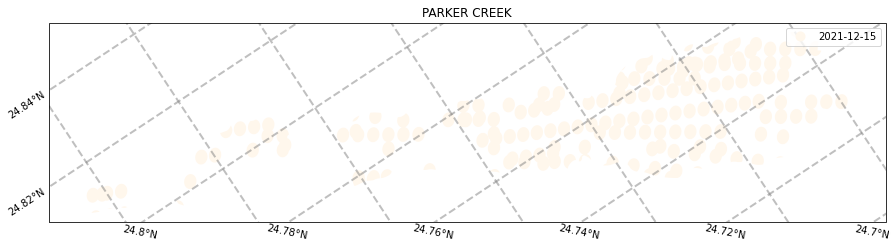

BIJOU


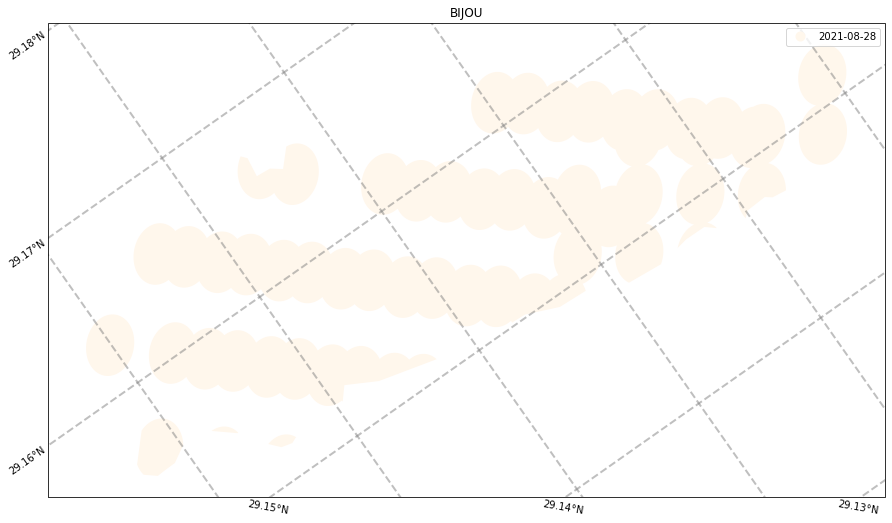

MUD LICK


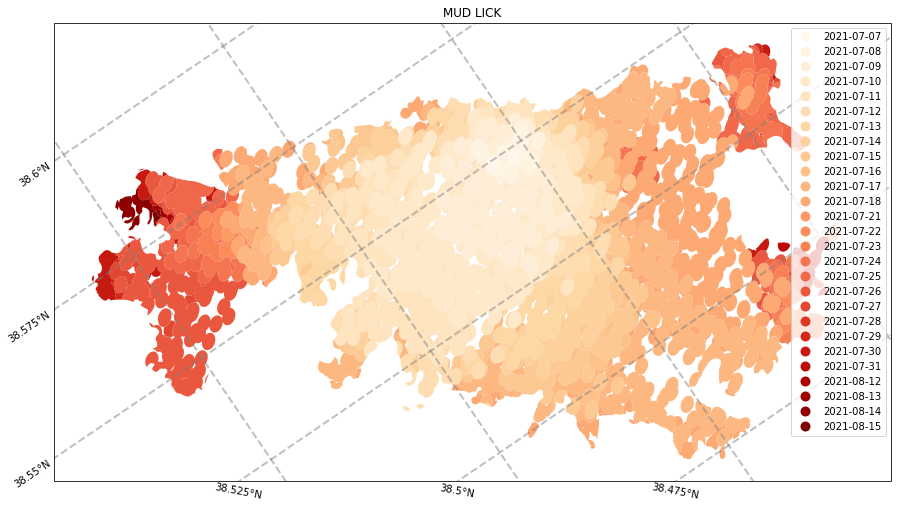

LEGACY


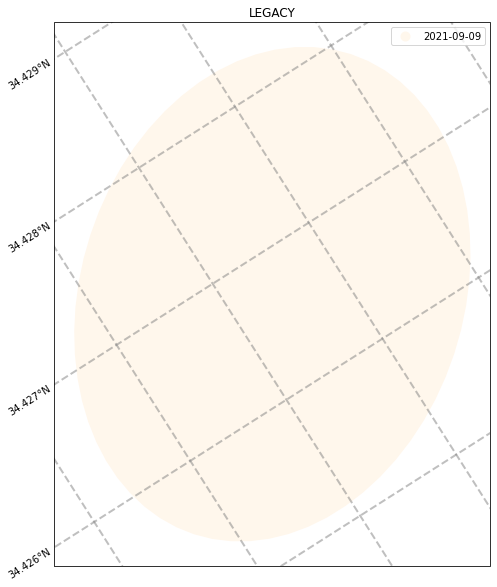

RUSH CREEK


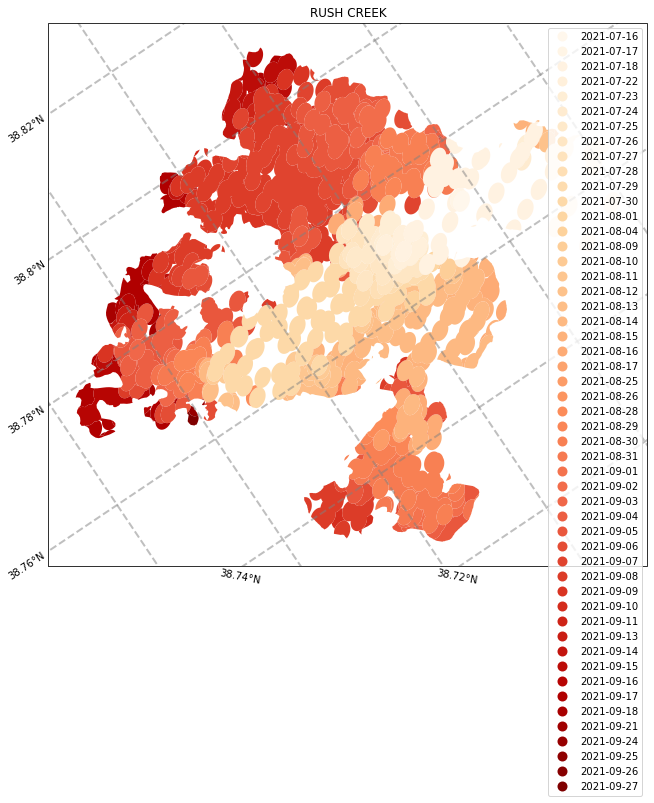

OCOTILLO


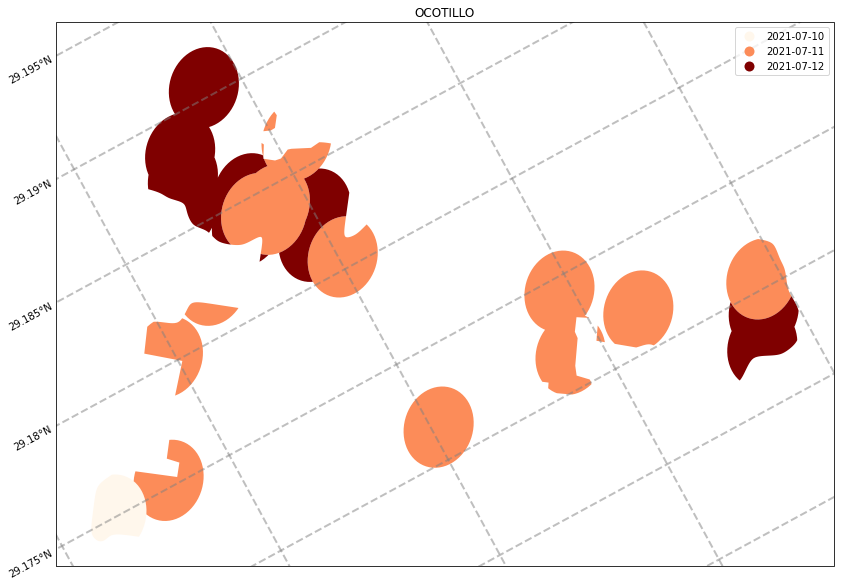

LIME


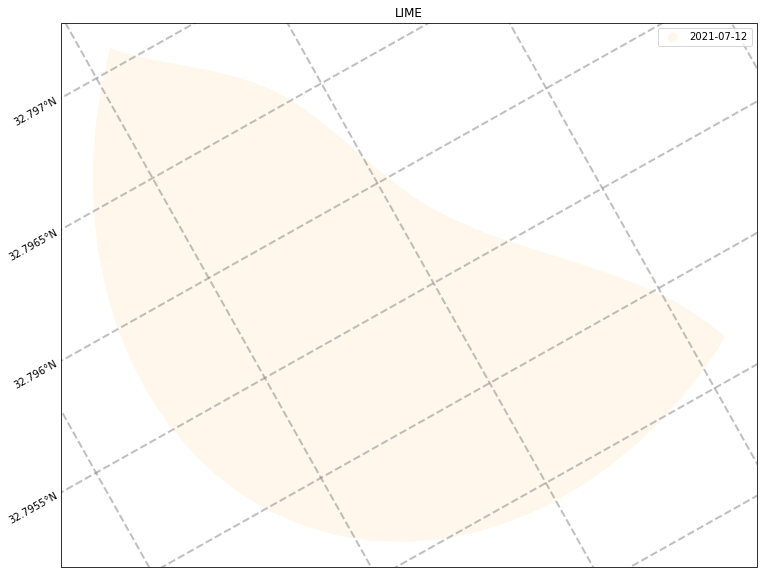

BUFFALO CREEK


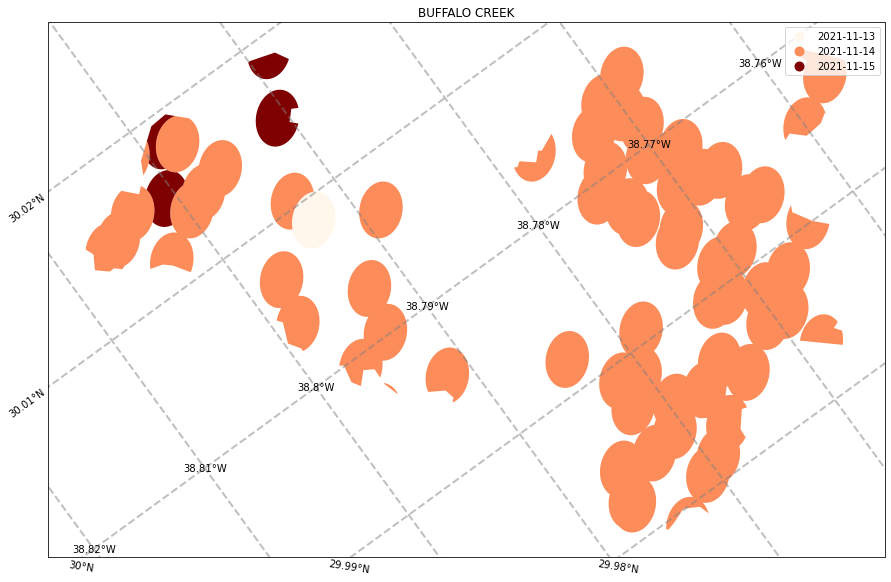

WALKERS


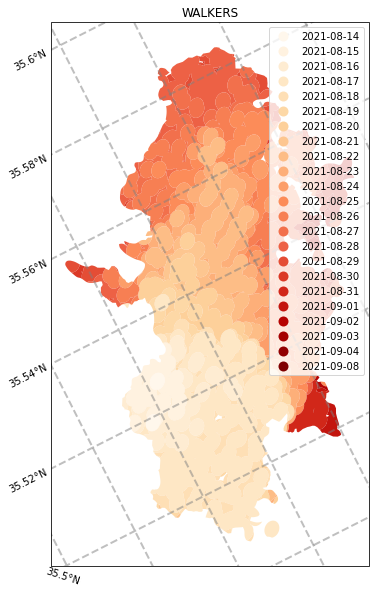

PINE GROVE


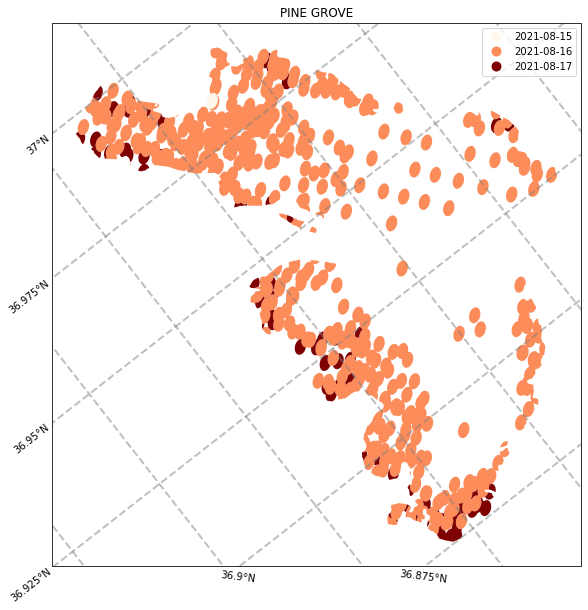

CHAPARRAL


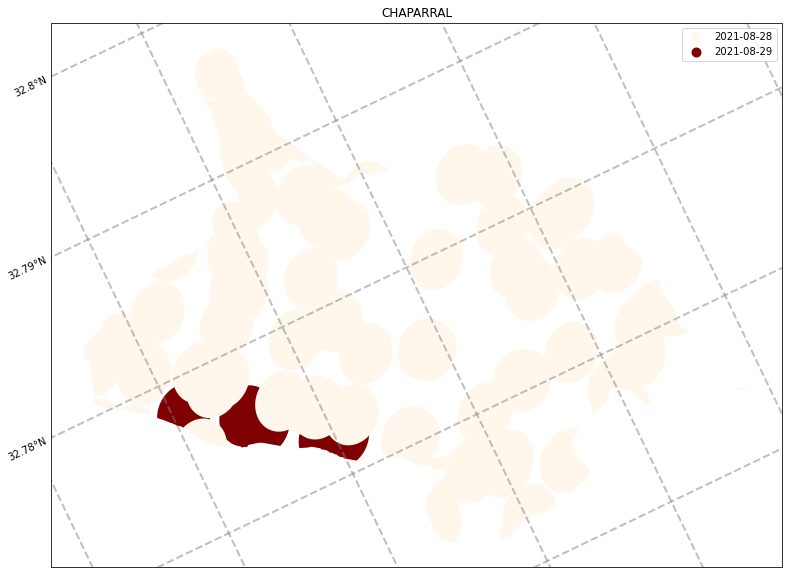

FRENCH


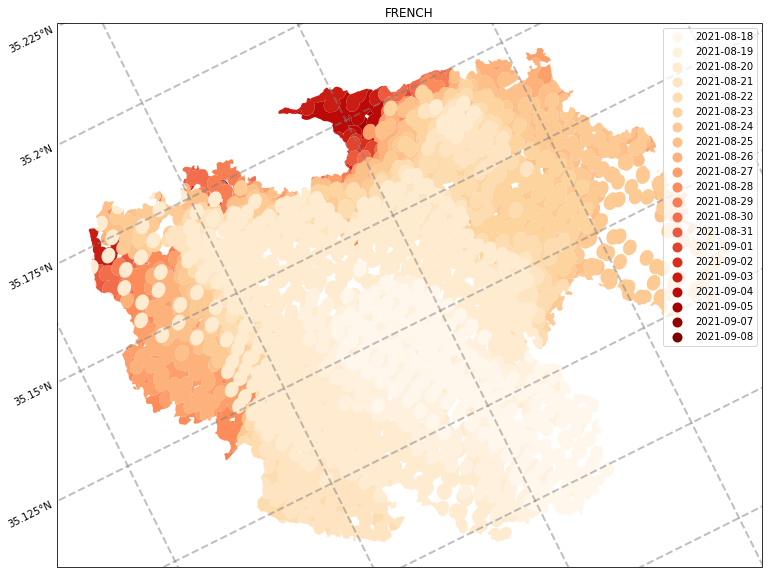

LONESOME


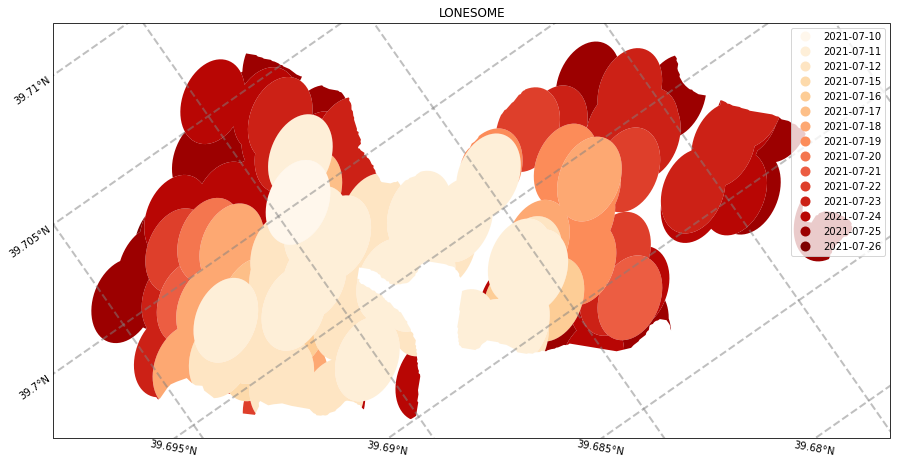

PEAK


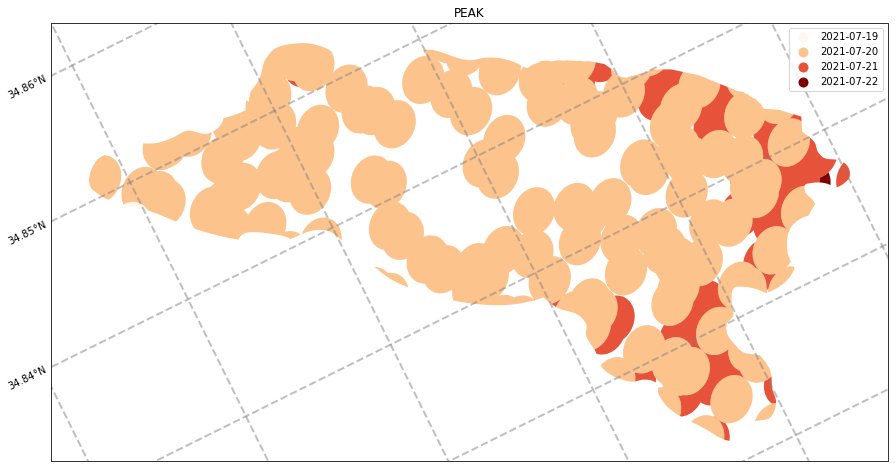

DEER CREEK 2


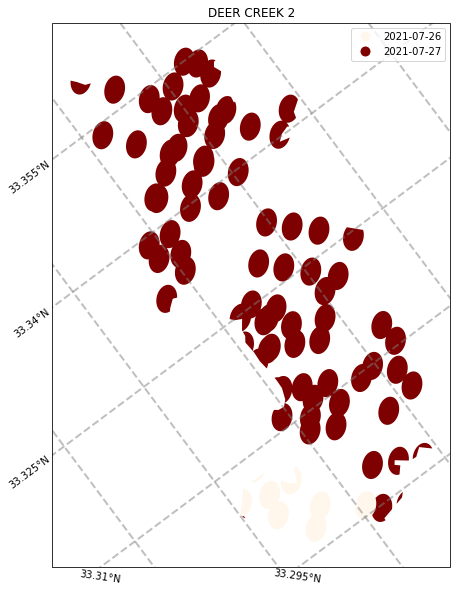

NORTH 207


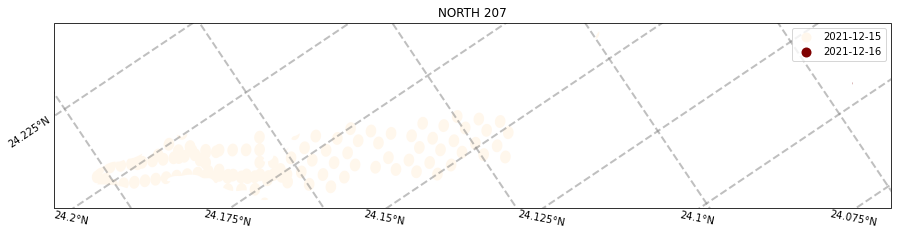

SAW MILL


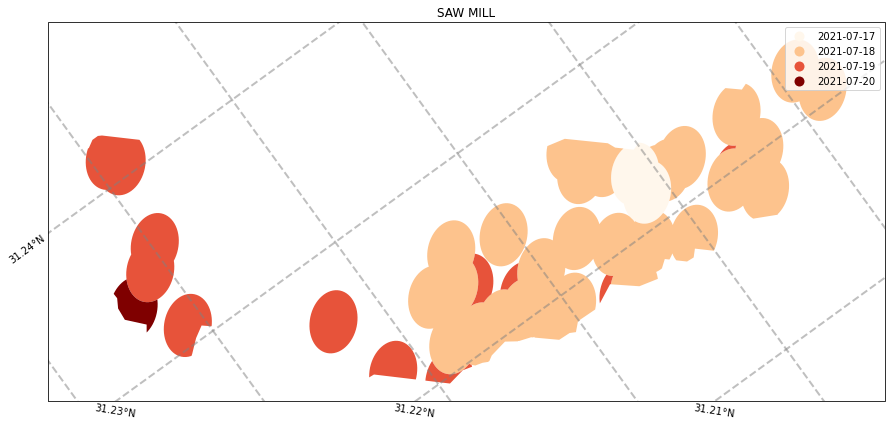

BOUNDARY


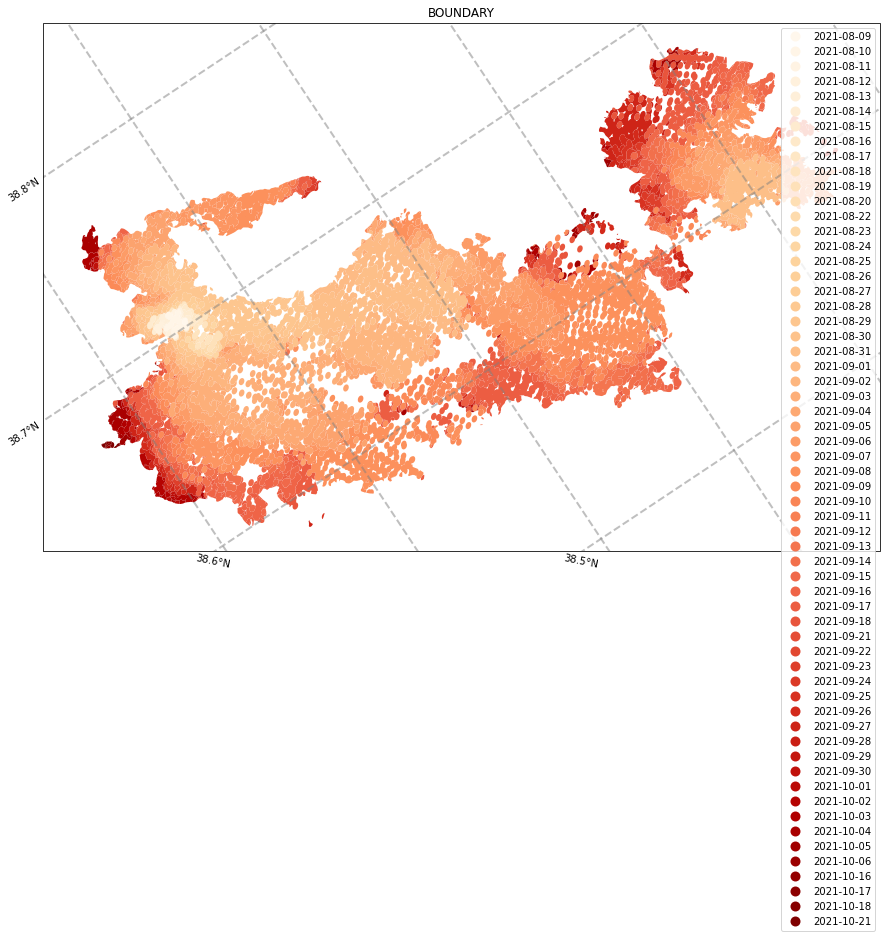

CUB CREEK 2


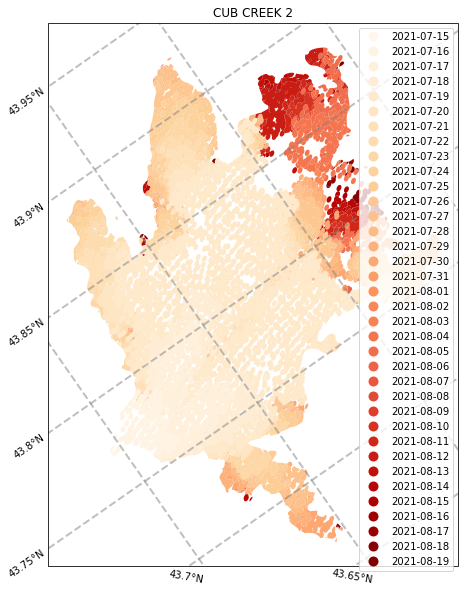

SOUTHERN BENCH


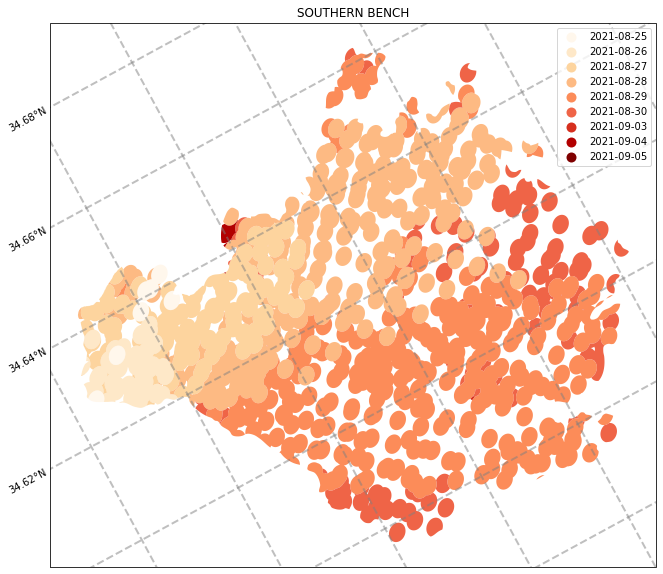

CLOVER CREEK


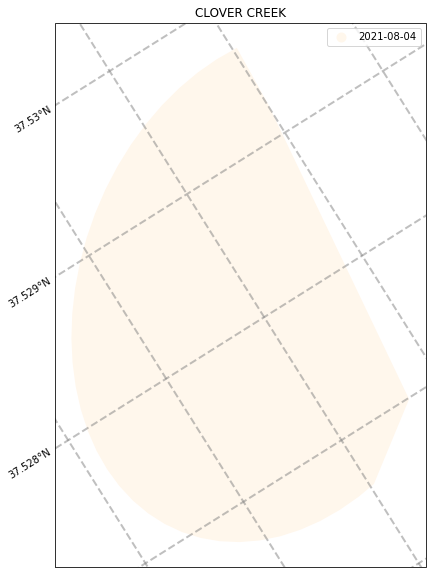

HACKBERRY CA


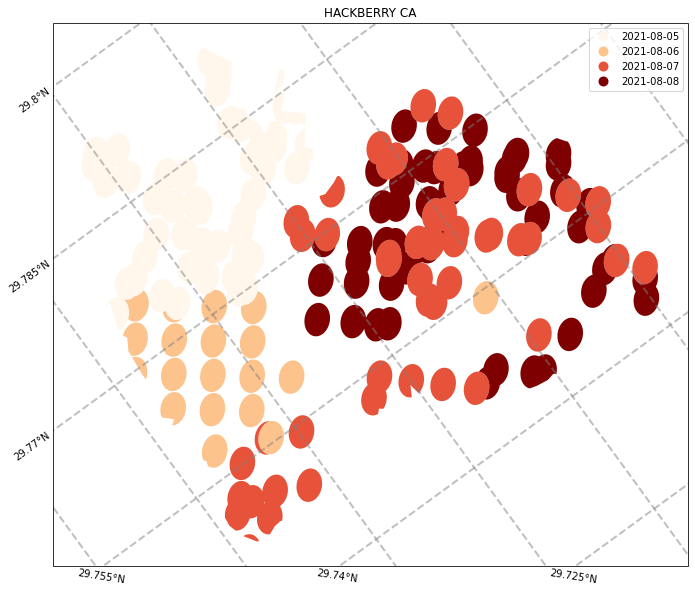

COBB FIRE


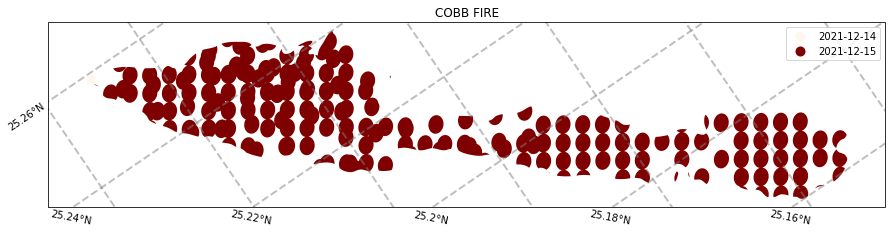

KNOB


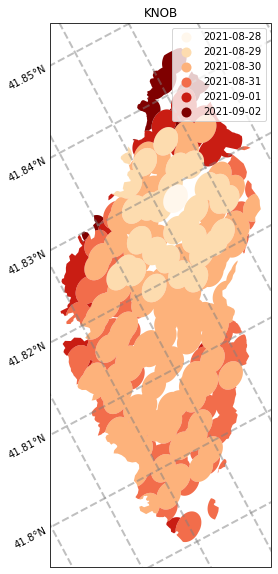

MAVRICK


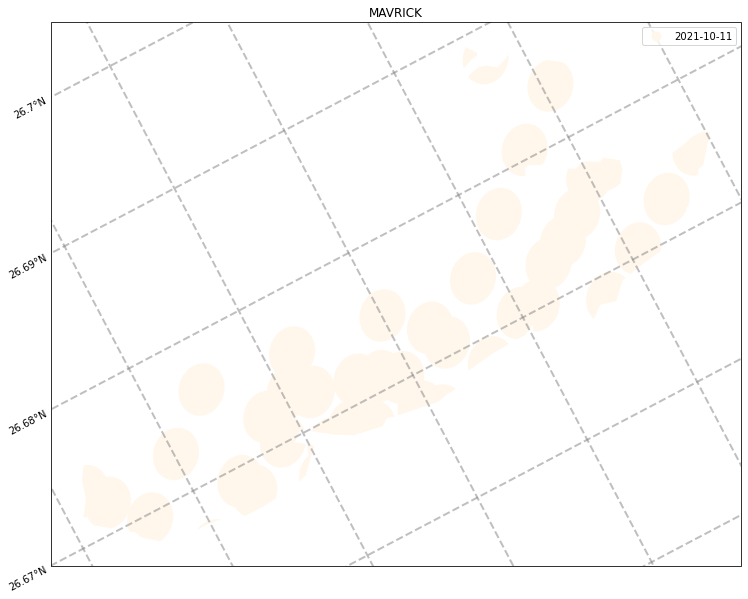

POST CA


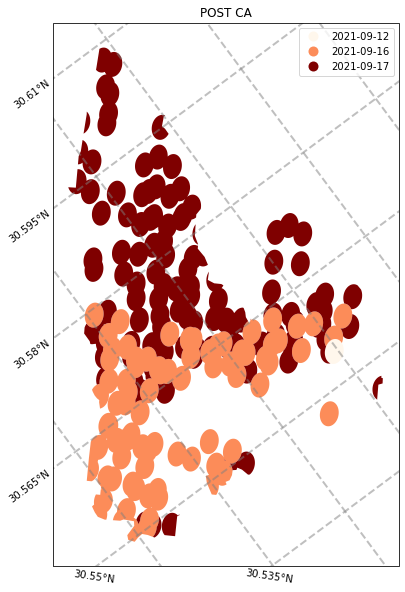

WINDY


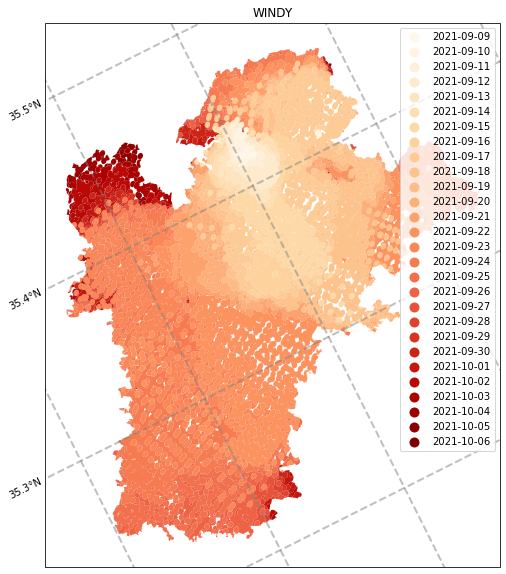

AMARGO


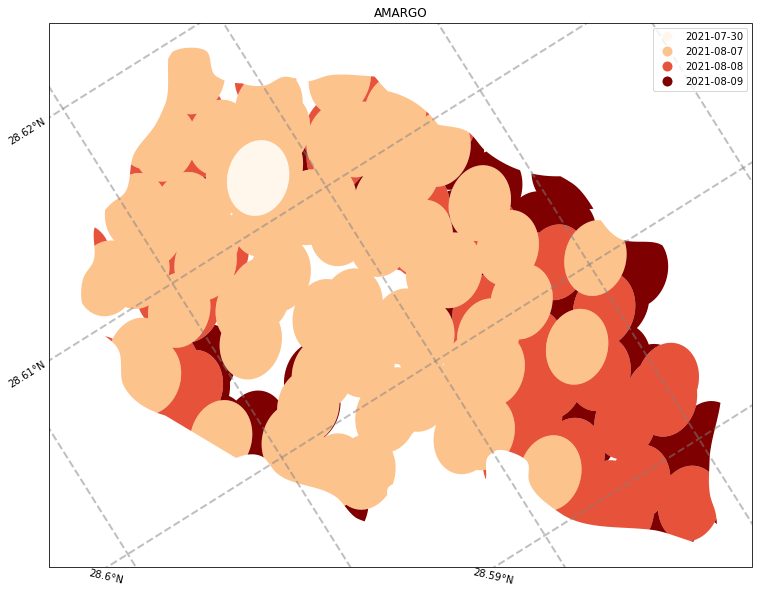

118 CA


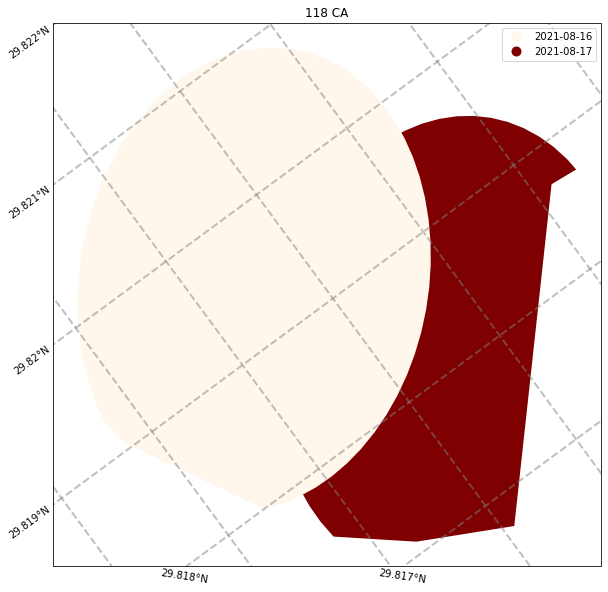

ALISAL


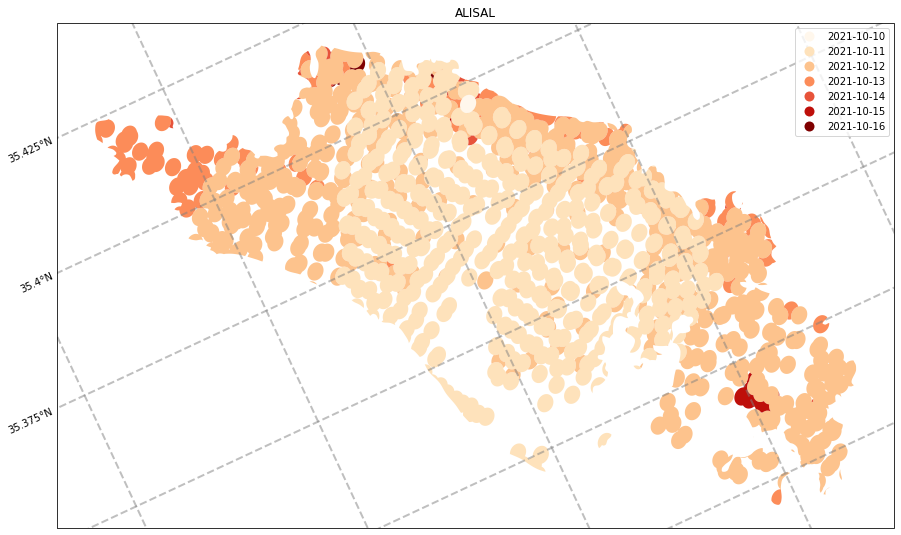

SHERWOOD


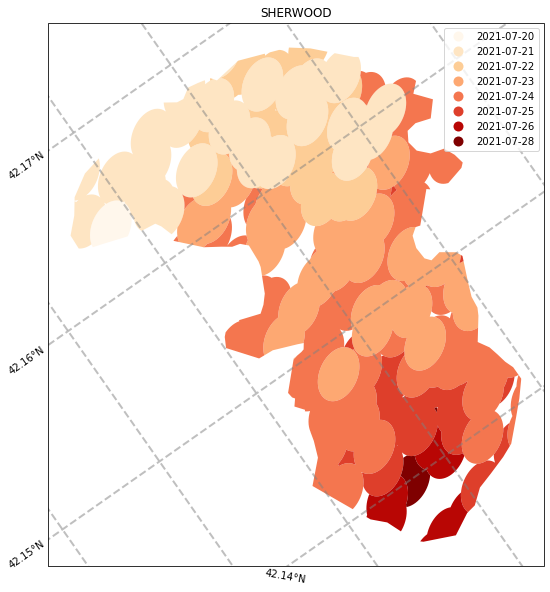

VISTA TREND CA


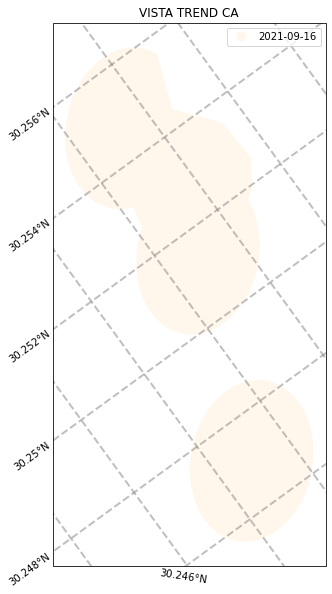

SUMMIT TRAIL


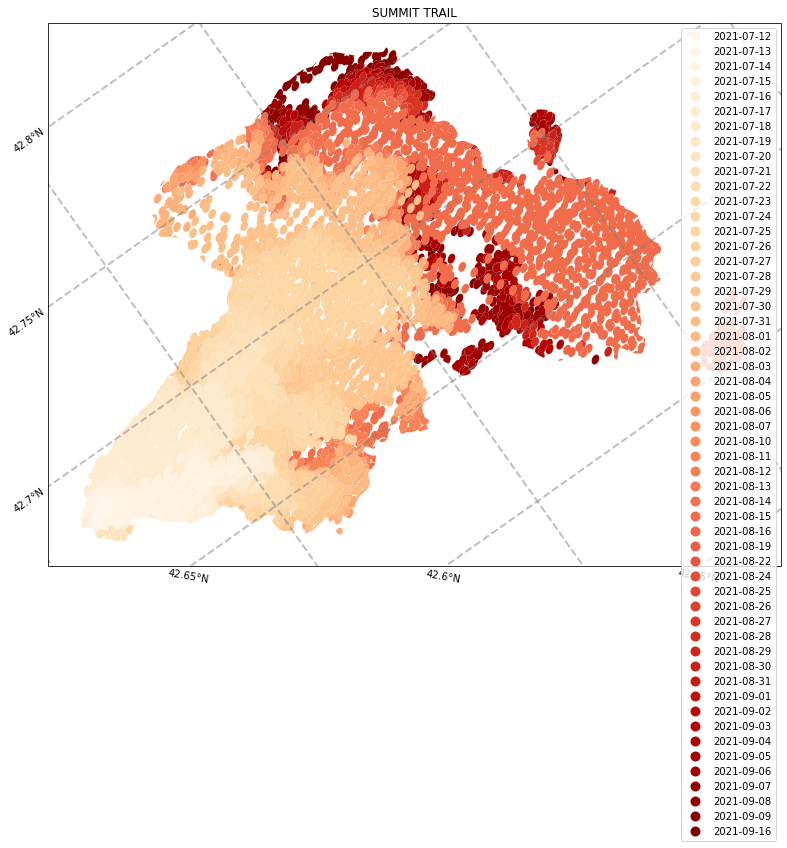

CHUWEAH CREEK FIRE


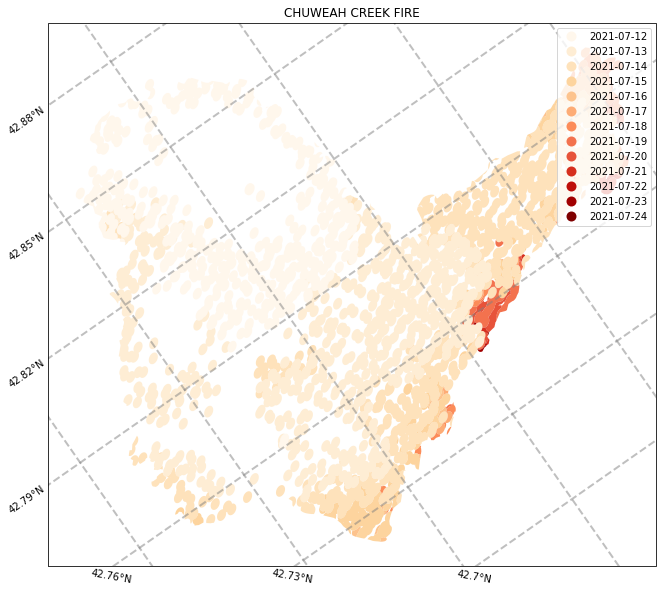

MARSHALL


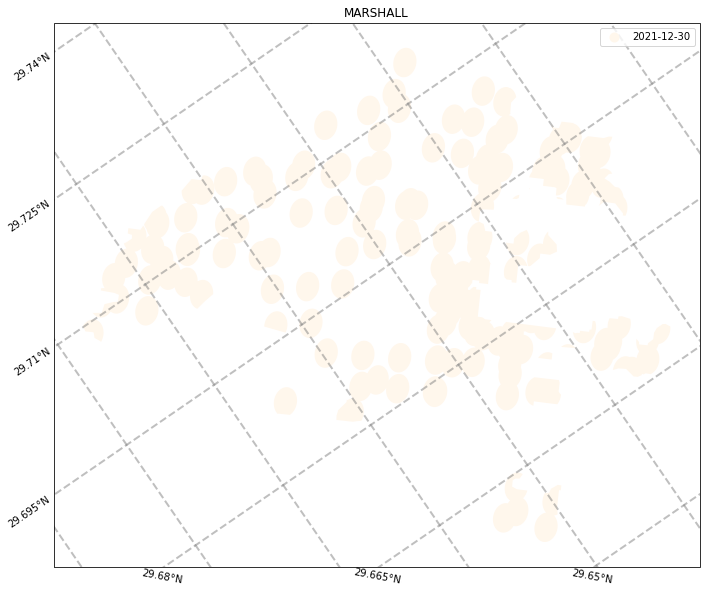

RIVER


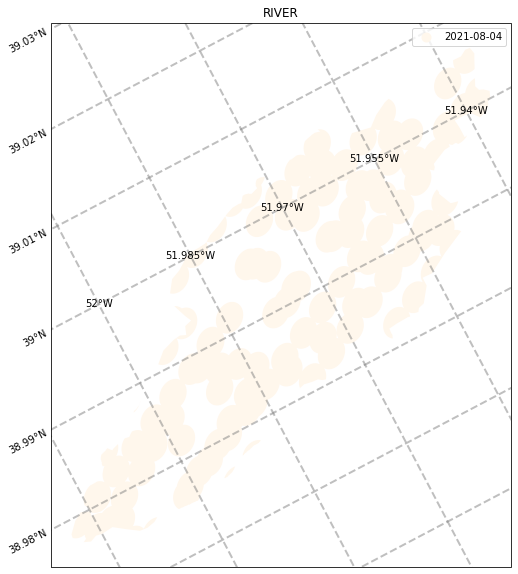

BRUNEAU


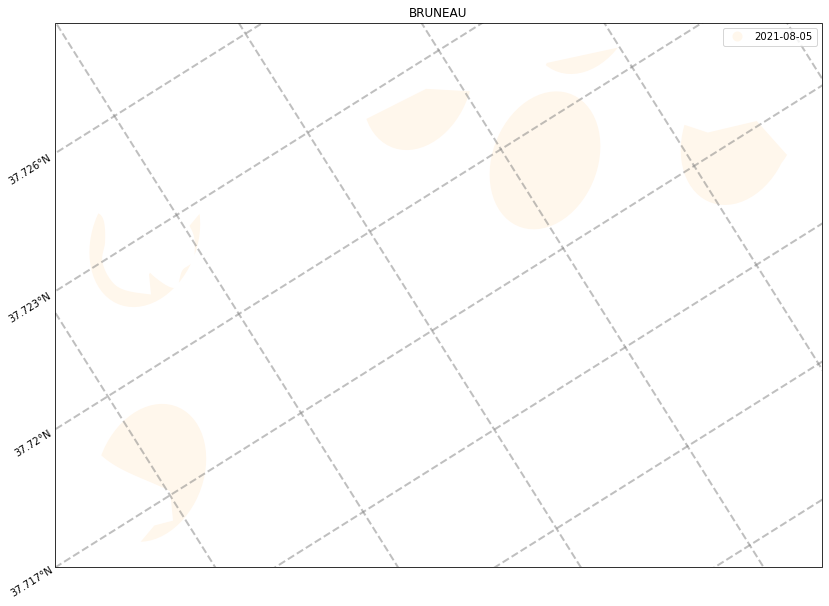

STORM CREEK


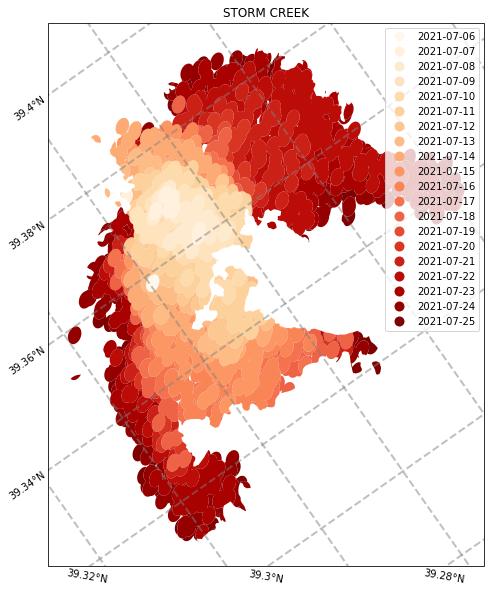

BAR CREEK


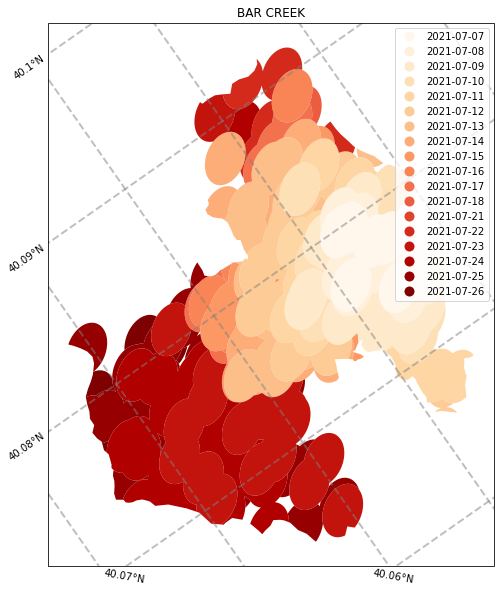

STEPTOE CANYON


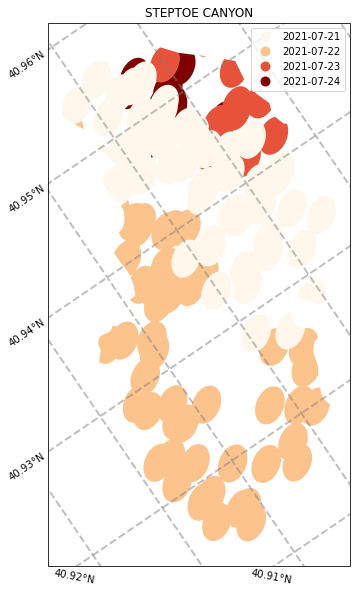

TWIN CREEK


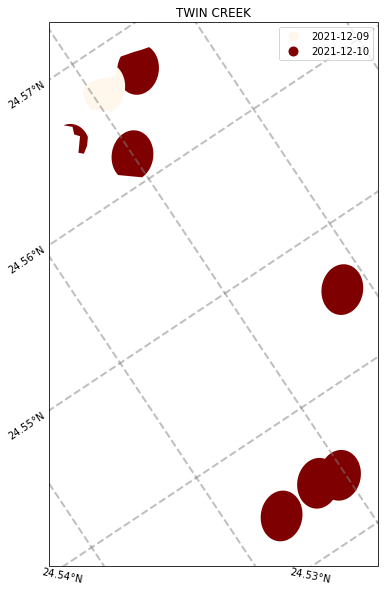

DIXIE


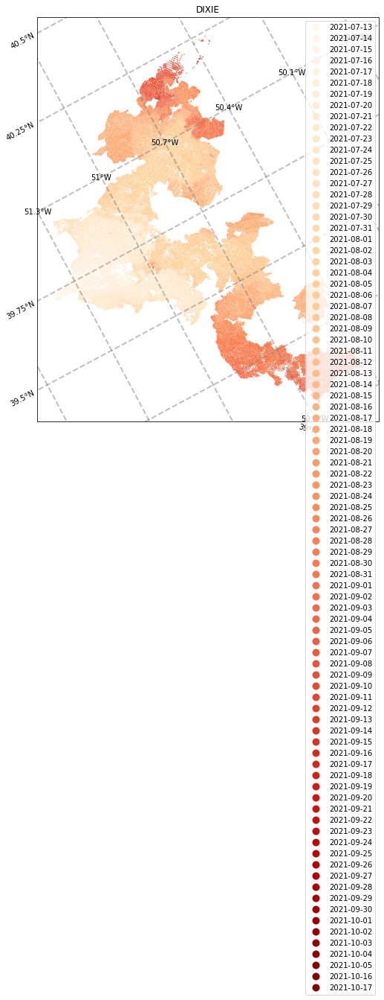

WALKER CREEK


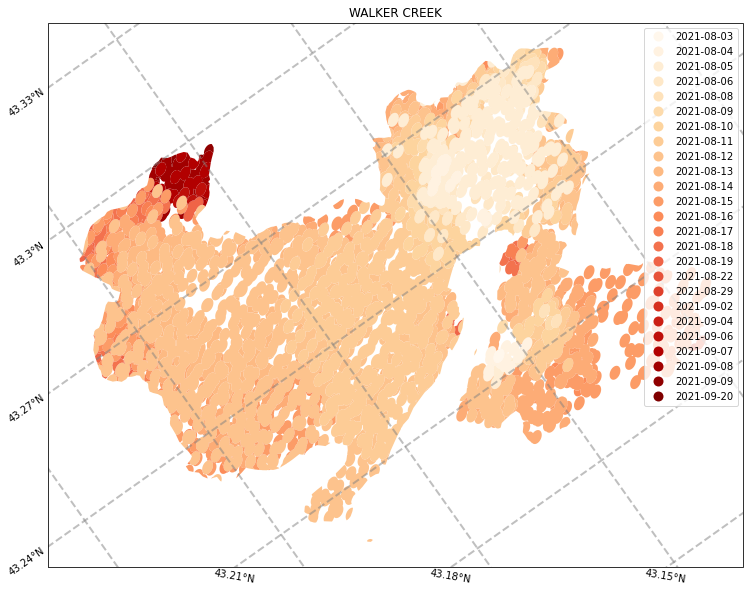

LUSK


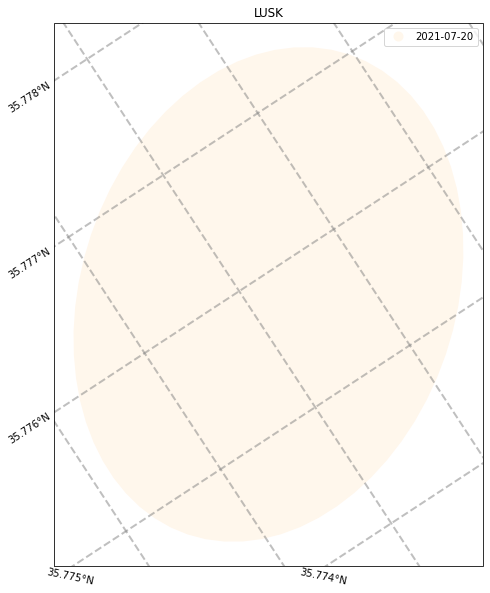

LYNX


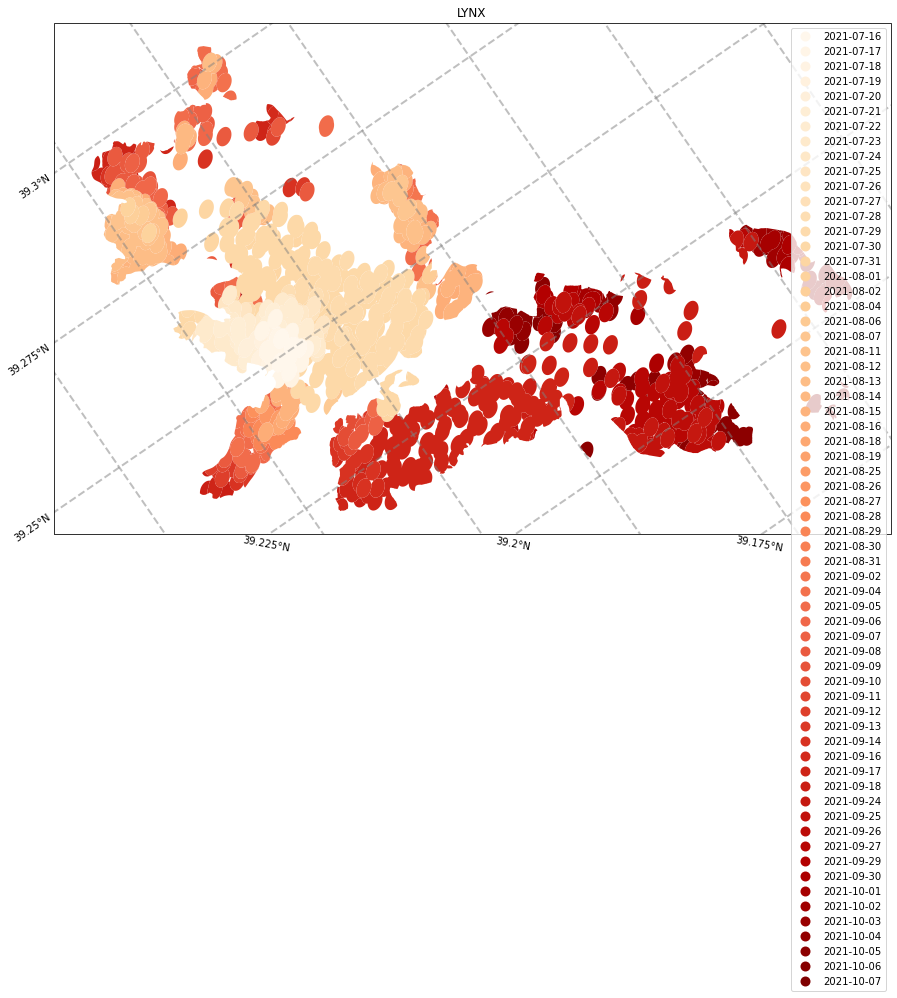

ALDER CREEK


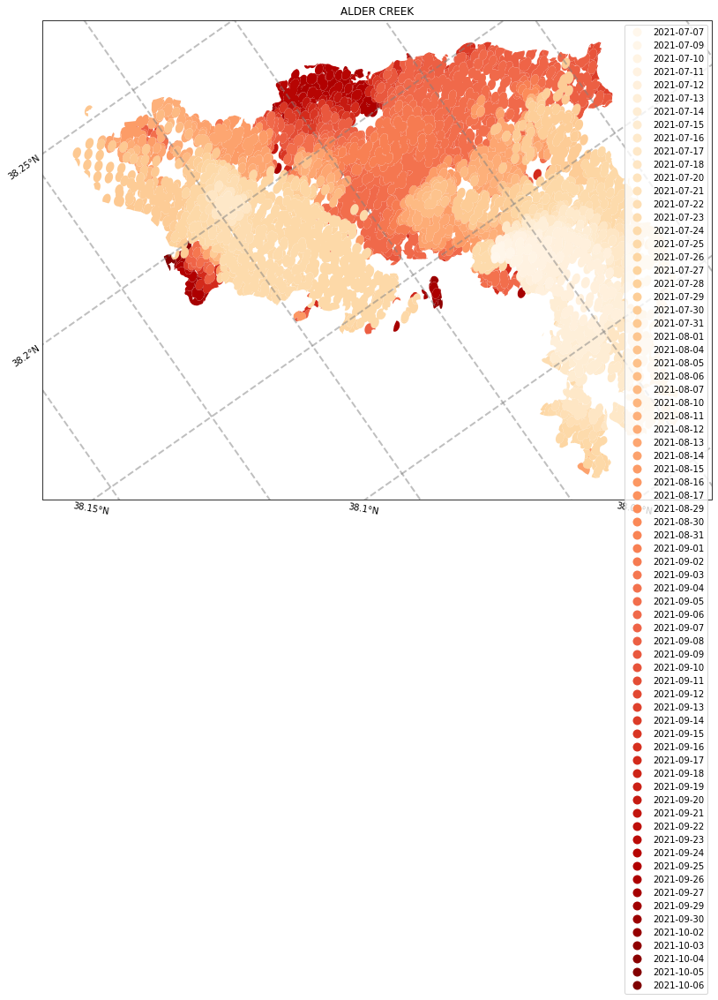

ELKHORN


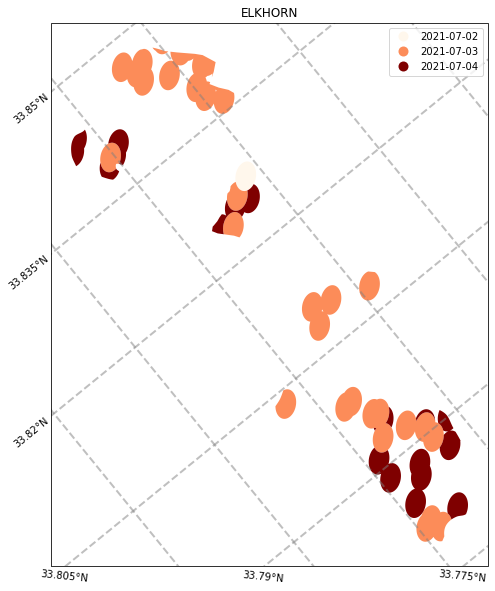

CROSS CA


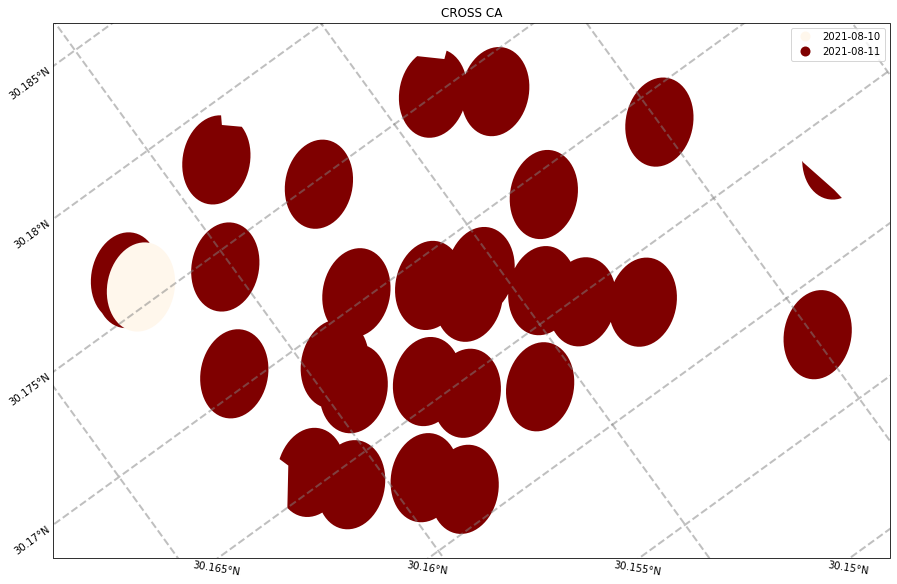

In [24]:
#fire_names = ['DIXIE']
fire_names = np.unique(daily_2021['irwinID'])
for name in fire_names:
    fire_plot = daily_2021[daily_2021['irwinID']==name].reset_index(drop=True)
    print(fire_plot['Fire Name'].loc[0])
    fig = plt.figure(figsize=(15,10))
    ax= fig.add_subplot(111,projection=ccrs.LambertConformal())
    #ax.set_extent([-54.6, -55, 38.4,38.75])
    fire_plot.plot(column='Local Day', cmap='OrRd',ax=ax, legend=True)
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,\
            linewidth=2, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    plt.title(fire_plot['Fire Name'].loc[0])
    plt.show()  

In [50]:
#these are nifc's most significant incidents over 40k acres for 2021  (AK & HI REMOVED, NOT IN DOMAIN)
# https://www.predictiveservices.nifc.gov/intelligence/2021_statssumm/annual_report_2021.pdf
fire_names = ['DIXIE','BOOTLEG','MONUMENT','CALDOR','RIVER COMPLEX','TELEGRAPH','RICHARD SPRING','ANTELOPE',
              'MCFARLAND', 'FOUR COUNTY', 'SNAKE RIVER COMPLEX', 'SCHNEIDER SPRINGS', 'BECKWOURTH COMPLEX',
             'WINDY', 'MCCASH', 'COUGAR PEAK', 'JOHNSON', 'BOUNDARY', 'KNP COMPLEX', 'RAFAEL', 'MESCAL', 'CUB CREEK 2', 
              "DEVIL'S KNOB COMPLEX", 'TAMARACK', 'P F', 'TRAIL CREEK', 'WHITMORE', 'CEDAR CREEK', 'WOODS CREEK', 
             'DRY GULCH', 'ROUGH PATCH COMPLEX', 'SUMMIT TRAIL', 'DIXIE', 'GREEN RIDGE', 'BACKBONE']


for name in fire_names:
    bdry =mtbs_bdrys_merged_2021[mtbs_bdrys_merged_2021['Incid_Name']==name] 
    if len(bdry)>0:
        print(bdry[['Incid_Name', 'Event_ID', 'irwinID', 'Ig_Date']])
        for ii in range(len(bdry)):
            print(ii)
            bdry_id = bdry['irwinID'].values[ii]
        
            #print(daily_2021[daily_2021['irwinID'].values==bdry_id])
        
        

   Incid_Name               Event_ID                               irwinID  \
45      DIXIE  ID4558511544420210705  3502EB16-012C-42FA-9531-B87897EEB494   

       Ig_Date  
45  2021-07-05  
0
      Incid_Name               Event_ID                               irwinID  \
223  FOUR COUNTY  KS3910009890020211215  F6A52A51-02E6-4B9F-99AE-6B469C3AB07B   

        Ig_Date  
223  2021-12-15  
0
    Incid_Name               Event_ID                               irwinID  \
107      WINDY  ND4600310234320210114  72161559-DB04-4930-A80C-D576230FA0E9   
157      WINDY  CA3604711863120210910  ACD5C207-BB83-4419-977D-3F64778081A3   

        Ig_Date  
107  2021-01-14  
157  2021-09-10  
0
1
   Incid_Name               Event_ID                               irwinID  \
81    JOHNSON  NM3323810847220210520  534842F3-0195-4BDD-93DE-393F6967572A   

       Ig_Date  
81  2021-05-20  
0
    Incid_Name               Event_ID                               irwinID  \
142   BOUNDARY  ID4453211532920210810 

## 2019

In [10]:
daily_2019= gpd.read_file('./fire_polygons/ClippedFires2019_VIIRS_daily_12Z_Day_Start.geojson')


In [11]:
print(len(np.unique(daily_2019['irwinID'])))
print(np.unique(daily_2019['irwinID']))

159
['026F0FC5-D38C-4F7B-928A-59F37BE81BAA'
 '044FCDB3-02B4-4166-A0E2-21D01913F3ED'
 '0788D1EE-E09B-4BEF-9B79-F43B91350D18'
 '085CC92E-2D49-4F95-98B8-2ED293D238CB'
 '094DE97E-055E-4489-81EA-9FE7AB80F221'
 '0A04F520-2251-4B7A-BF45-D47DC6BD6D49'
 '0BC4A236-9114-4044-8F7C-9ABAC2EF8CEA'
 '12D435C8-627E-438F-994A-1105E5DBB56F'
 '16601786-0C27-4047-876C-A985B7BAE2D2'
 '169D6993-FD9C-4E72-AB3D-ED752F19FC8E'
 '19B6F261-215E-4D6C-B62B-DA836C097B86'
 '1BFD3A06-0959-4FDF-A7D9-72B7B1BB78A3'
 '1DAFC388-98C2-401A-849E-C435E3260425'
 '1EF4925F-A9ED-43E7-B2A1-7EEC8DEEF6C5'
 '20EEC0CB-93DD-4D5E-946D-2349AE51F360'
 '22E2150C-45A1-4C69-8F6D-9100F1D072D6'
 '257F6CDB-2E7E-48D4-B530-28BEBAE66C43'
 '2ABFE1D2-64B3-44FE-BF31-B85CD7BD49A7'
 '2CB4CF0E-9AFC-407E-AC4D-6F523F7059FE'
 '2EF511E0-4B20-4B29-B335-21C9587B7D30'
 '30BCC069-947B-43F3-B139-0761FD79C4BD'
 '31A016C8-AC09-4C58-ACA3-789CFCA0B830'
 '32176236-1B80-4070-BDD3-BBCF798681A8'
 '33A6F0F0-CACF-4421-A4BF-2A52AA1F184F'
 '37E018F9-A7D3-4E37-AB9C-A078269AD5

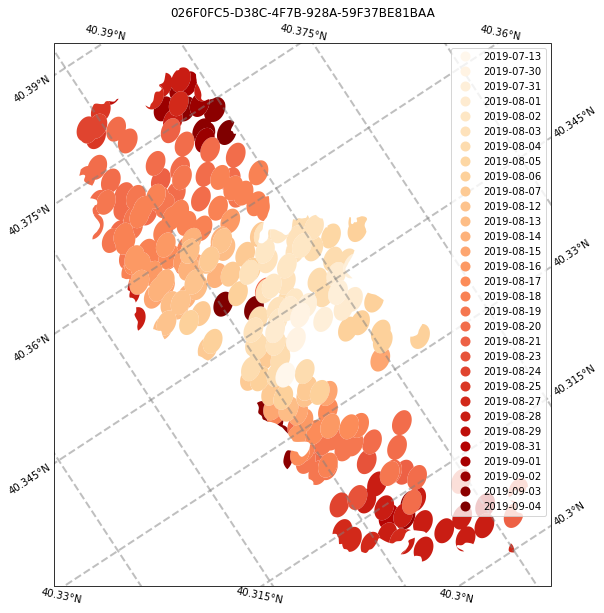

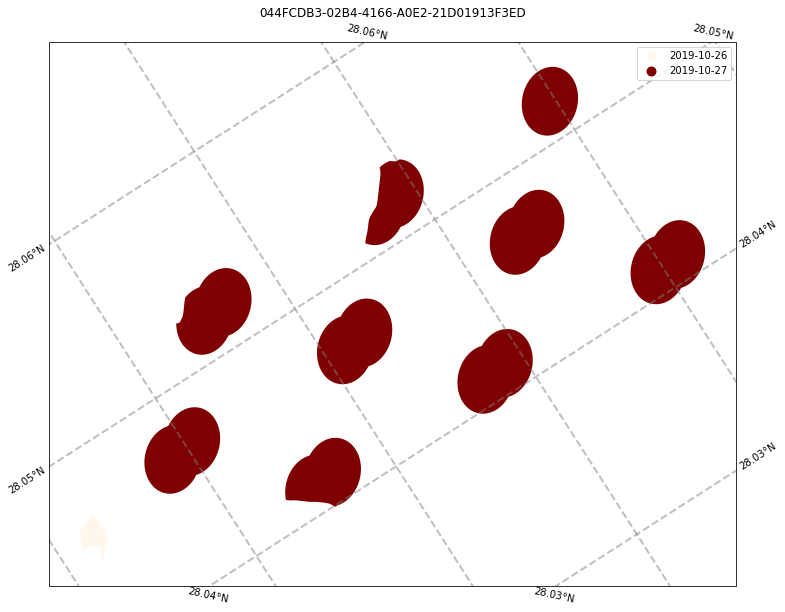

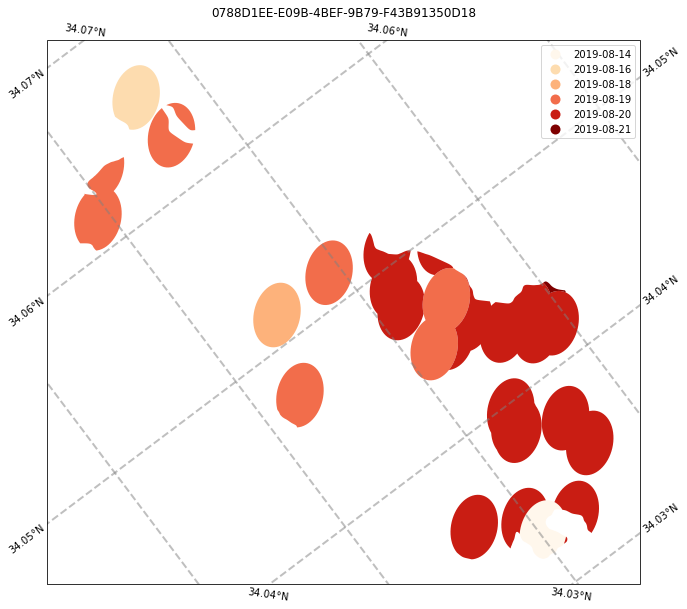

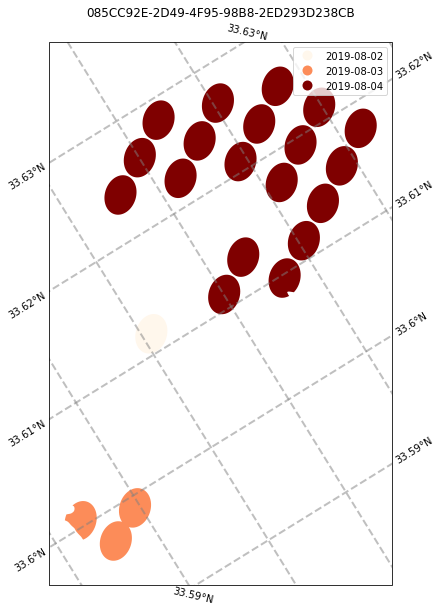

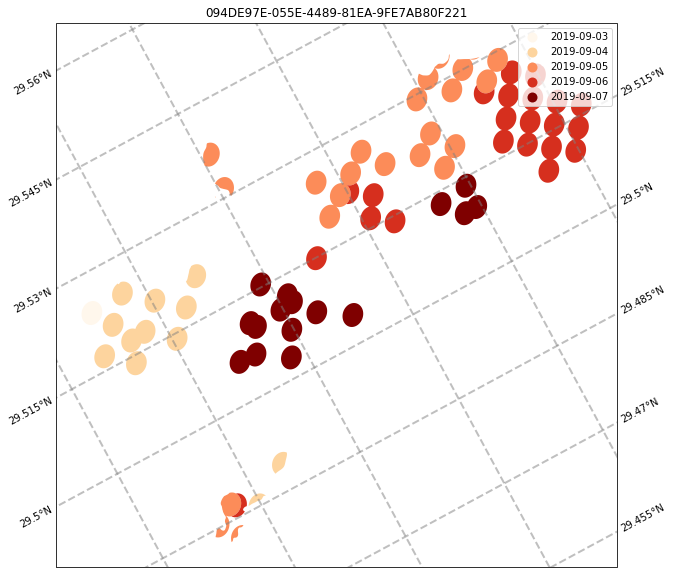

...

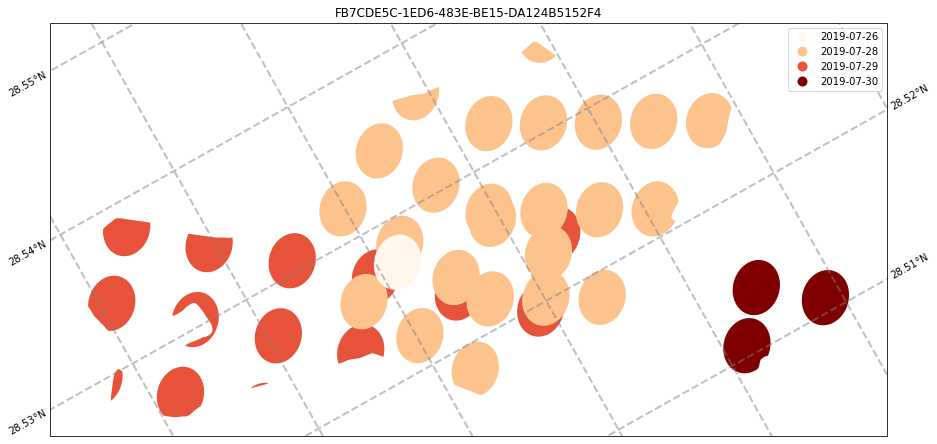

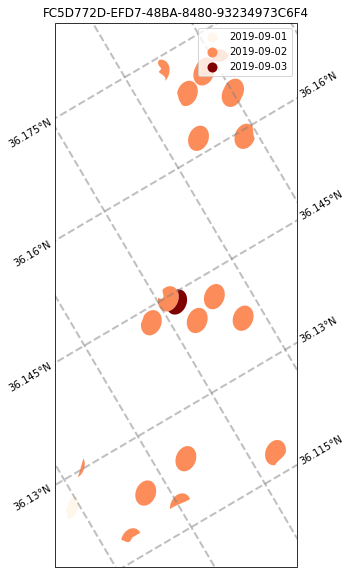

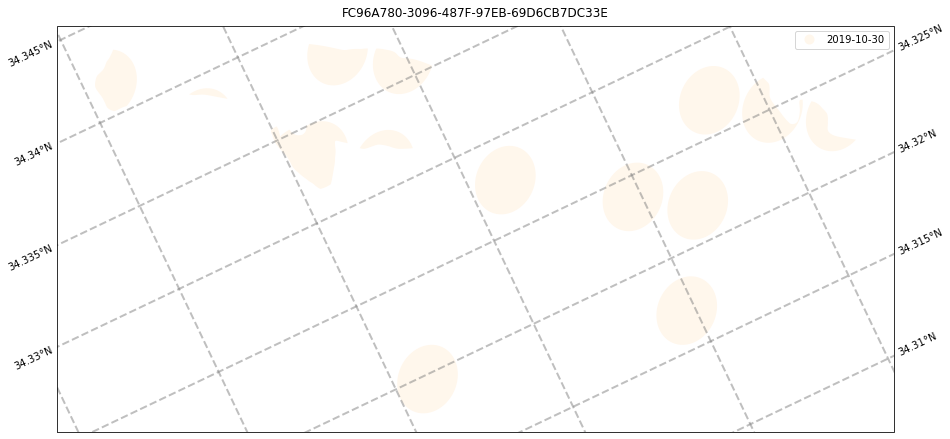

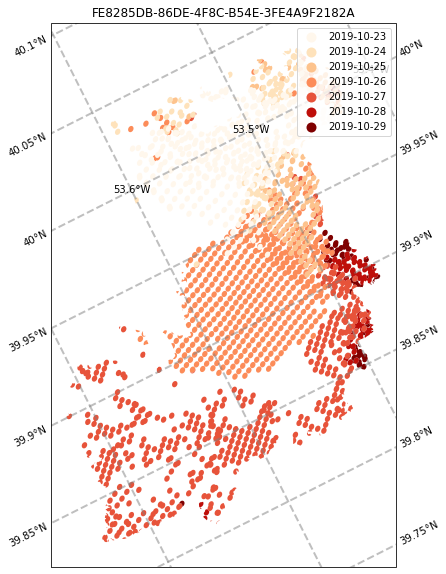

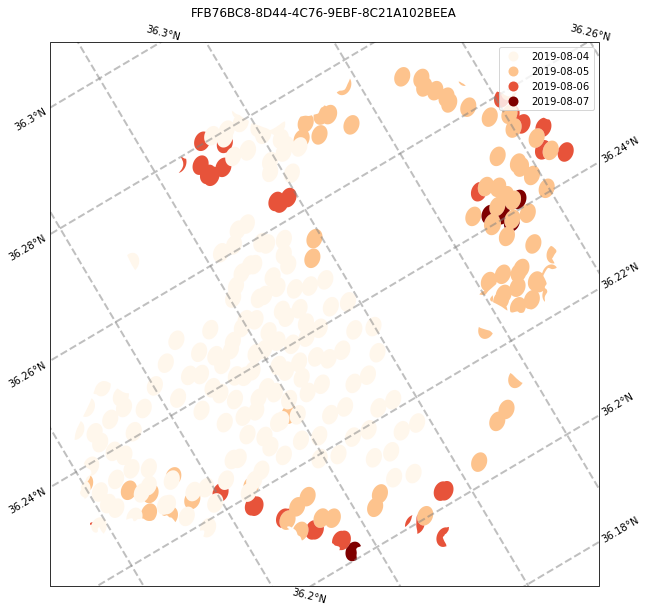

In [14]:
#fire_names = ['DIXIE', 'CUB CREEK 2', 'BOUNDARY']
fire_names = np.unique(daily_2019['irwinID'])
for name in fire_names:
    fire_plot = daily_2019[daily_2019['irwinID']==name].reset_index(drop=True)
    fig = plt.figure(figsize=(15,10))
    ax= fig.add_subplot(111,projection=ccrs.LambertConformal())
    #ax.set_extent([-54.6, -55, 38.4,38.75])
    fire_plot.plot(column='Local Day', cmap='OrRd',ax=ax, legend=True)
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,\
            linewidth=2, color='gray', alpha=0.5, linestyle='--')
    #gl.top_labels = False
    #gl.right_labels = False
    plt.title(name)
    plt.show()  

# Helper Functions

In [15]:
#uses max to combine the polygons, day starts at day_start_hour
def combine_per_overpass_polygons_to_daily(fire, day_start_hour, year):
    # load in the PER OVERPASS polygons and attributes
    per_overpass_fire = gpd.read_file('./fire_polygons/'+fire.replace(' ','_')+'_VIIRS_per_overpass_'+str(year)+'.geojson') #polygons only
    #per_overpass_fire = gpd.read_file('./'+fire.replace(' ','_')+'_VIIRS_per_overpass_irwin_'+str(year)+'.geojson') #polygons only

    daystrings = [per_overpass_fire['Current Day'].iloc[i]  for i in range(len(per_overpass_fire))]
    timestrings = [str(int(per_overpass_fire['Current Overpass'].iloc[i])).zfill(4) for i in range(len(per_overpass_fire))]

    datetime_strings = [daystrings[i]+'T'+timestrings[i][0:2]+':'+timestrings[i][2:4] for i in range(len(per_overpass_fire))]
    datetimes = np.array(datetime_strings,dtype='datetime64')

    current_day = [] #if observed hour>day_start_hour, current day, else previous day
    for ii in range(len(datetimes)):
        time_compare = np.datetime64(daystrings[ii]+'T'+str(day_start_hour).zfill(2)+':00')
        if datetimes[ii]>= time_compare:
            current_day.append(daystrings[ii])
        else:
            current_day.append(str(np.datetime64(daystrings[ii])-np.timedelta64(1,'D')))
    print(current_day)
    per_overpass_fire['Local Day'] = current_day #this is the 12Z Start Day
    tic = np.datetime64('now')
    daily_fire_dataframe = per_overpass_fire.dissolve(by=['Local Day','irwinID'], aggfunc='max',as_index=False) #index on day and fire name
    toc = np.datetime64('now')
    print(toc-tic)
    
    return daily_fire_dataframe

In [2]:
mtbs_2021 = gpd.read_file('../mtbs_perims_DD.shp') #the direct download, selecting 2020 

In [19]:
mtbs_bdrys_merged = mtbs_2021.dissolve(by='irwinID').reset_index()


In [22]:
print(mtbs_bdrys_merged[mtbs_bdrys_merged['Incid_Name']=='DIXIE'])


                                   irwinID  \
831   3502EB16-012C-42FA-9531-B87897EEB494   
3771  DF046F57-64B0-4978-ADF5-61C30C8031B1   

                                               geometry  \
831   MULTIPOLYGON (((-115.34468 45.65231, -115.3444...   
3771  POLYGON ((-115.88871 40.62327, -115.88844 40.6...   

                   Event_ID Incid_Name Incid_Type    Map_ID Map_Prog  \
831   ID4558511544420210705      DIXIE   Wildfire  10022502     MTBS   
3771  NV4061211588320180724      DIXIE   Wildfire  10010981     MTBS   

     Asmnt_Type  BurnBndAc BurnBndLat  ...          Post_ID Perim_ID  \
831    Extended      45254     45.536  ...  904102820220717     None   
3771    Initial       2468     40.623  ...  804003220180808     None   

     dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  Low_T  Mod_T  High_T  Comment  
831           1         26     -970        -150     80    324     600     None  
3771         24         10     -970        -150     40    320    9999     None  

[2 ro

3353
                                   irwinID  \
831   3502EB16-012C-42FA-9531-B87897EEB494   
3771  DF046F57-64B0-4978-ADF5-61C30C8031B1   

                                               geometry  \
831   MULTIPOLYGON (((-115.34468 45.65231, -115.3444...   
3771  POLYGON ((-115.88871 40.62327, -115.88844 40.6...   

                   Event_ID Incid_Name Incid_Type    Map_ID Map_Prog  \
831   ID4558511544420210705      DIXIE   Wildfire  10022502     MTBS   
3771  NV4061211588320180724      DIXIE   Wildfire  10010981     MTBS   

     Asmnt_Type  BurnBndAc BurnBndLat  ...          Post_ID Perim_ID  \
831    Extended      45254     45.536  ...  904102820220717     None   
3771    Initial       2468     40.623  ...  804003220180808     None   

     dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  Low_T  Mod_T  High_T  Comment  
831           1         26     -970        -150     80    324     600     None  
3771         24         10     -970        -150     40    320    9999     None  



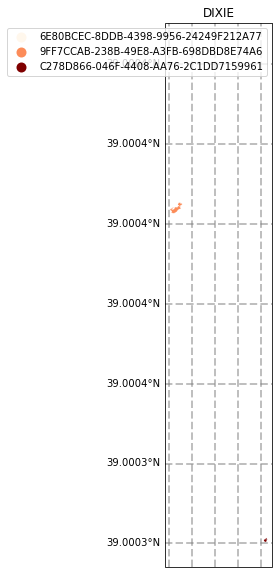

In [21]:
wildfires = mtbs_bdrys_merged[mtbs_bdrys_merged['Incid_Type']=='Wildfire']
print(len(wildfires))
print(wildfires[wildfires['Incid_Name']=='DIXIE'])


fire_plot = wildfires[wildfires['Incid_Name']=='BOUNDARY'].reset_index(drop=True)
fig = plt.figure(figsize=(15,10))
ax= fig.add_subplot(111,projection=ccrs.LambertConformal())
#ax.set_extent([-54.6, -55, 38.4,38.75])
fire_plot.plot(column='irwinID', cmap='OrRd',ax=ax, legend=True)
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,\
            linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.top_labels = False
gl.right_labels = False
plt.title('DIXIE')
plt.show()  

# Make plots of the test fires, and MTBS Perimeters

In [19]:
#2019 
daily_2019 = gpd.read_file('./fire_polygons/ClippedFires2019_VIIRS_daily_12Z_Day_Start.geojson')

file_list = os.listdir('../mtbs/2019/')

mtbs_bdrys = gpd.GeoDataFrame()
for file in file_list:
    if file.endswith('_burn_bndy.shp'):
        gdf_file = gpd.read_file('../mtbs/2019/'+file)
        mtbs_bdrys = pd.concat([mtbs_bdrys, gdf_file], axis=0)

mtbs_bdrys_merged = mtbs_bdrys.dissolve(by='irwinID').reset_index()
print(mtbs_bdrys_merged.head())

                                irwinID  \
0  026F0FC5-D38C-4F7B-928A-59F37BE81BAA   
1  02F5A6D9-30E9-4B60-9583-6081C60C4955   
2  044FCDB3-02B4-4166-A0E2-21D01913F3ED   
3  0788D1EE-E09B-4BEF-9B79-F43B91350D18   
4  085CC92E-2D49-4F95-98B8-2ED293D238CB   

                                            geometry               Event_ID  \
0  POLYGON ((-1666620.387 2655610.867, -1666618.9...  OR4517811742720190728   
1  POLYGON ((-2187716.566 1895702.336, -2187718.7...  CA3747212124920190625   
2  POLYGON ((-872420.944 1606010.594, -872423.217...  CO3708210594220191027   
3  POLYGON ((-823295.134 2515231.807, -823292.617...  MT4520210650820190815   
4  POLYGON ((-1347699.509 1974619.658, -1347700.8...  UT3977911193520190803   

      Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
0  GRANITE GULCH   Wildfire  10016387     MTBS   Extended       5834   
1           ROCK   Wildfire  10015610     MTBS    Initial       2451   
2            G18   Wildfire  10015845     MTBS    

No handles with labels found to put in legend.


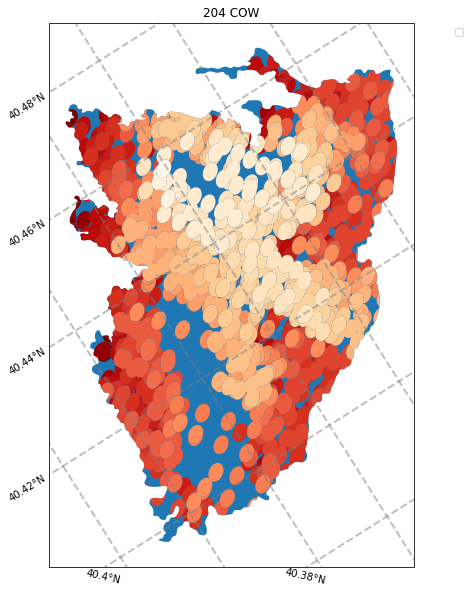

No handles with labels found to put in legend.


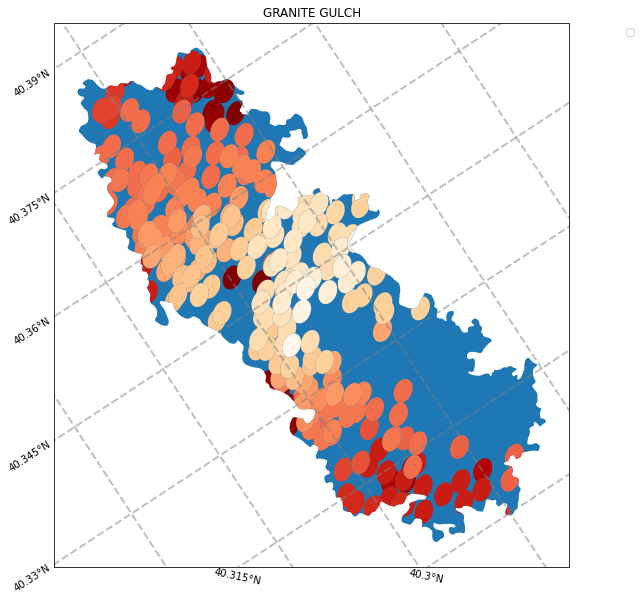

No handles with labels found to put in legend.


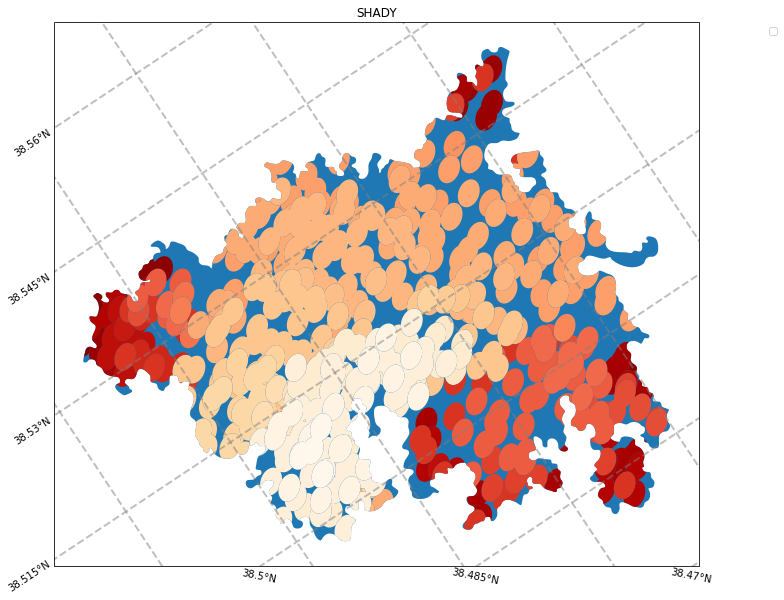

No handles with labels found to put in legend.


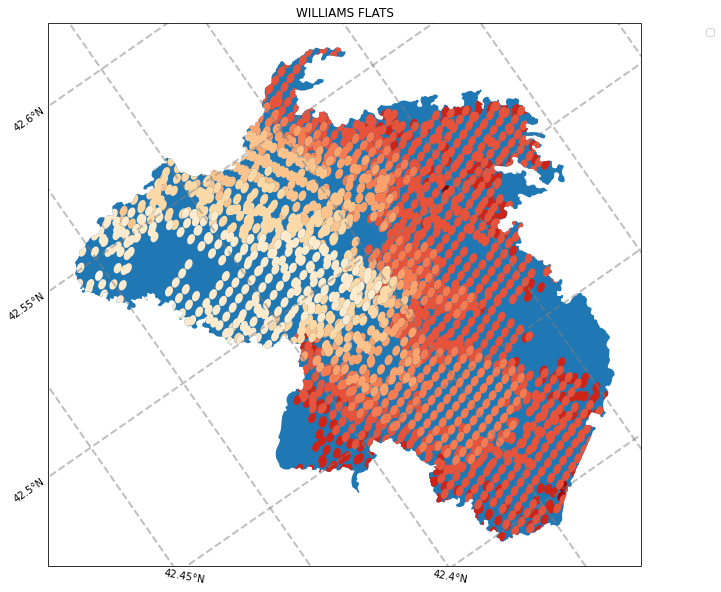

No handles with labels found to put in legend.


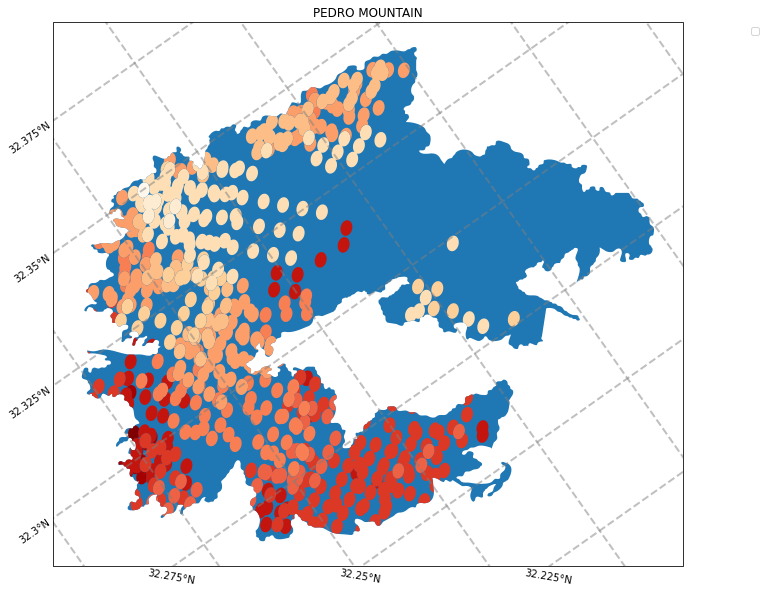

No handles with labels found to put in legend.


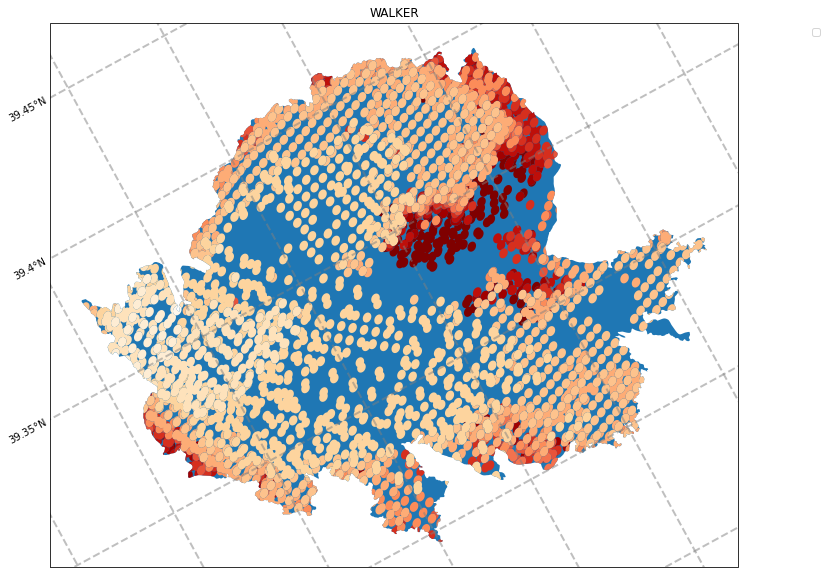

In [55]:
fire_names = ['204 COW', 'GRANITE GULCH', 'SHADY','WILLIAMS FLATS', 'PEDRO MOUNTAIN','WALKER']

for name in fire_names:
    fire_plot = daily_2019[daily_2019['Fire Name']==name].reset_index(drop=True)
    irwin = fire_plot['irwinID'].values[0]
    mtbs_plot = mtbs_bdrys_merged[mtbs_bdrys_merged['irwinID']==irwin].to_crs('EPSG:3347')
    fig = plt.figure(figsize=(15,10))
    ax= fig.add_subplot(111,projection=ccrs.LambertConformal())
    #ax.set_extent([-54.6, -55, 38.4,38.75])
    mtbs_plot.plot(ax=ax)
    fire_plot.plot(column='Local Day', cmap='OrRd',ax=ax, legend=True)
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,\
            linewidth=2, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    ax.legend(bbox_to_anchor=(0.6, 1), loc='upper left')

    plt.title(name)
    plt.show()  

In [25]:
#2020 
daily_2020 = gpd.read_file('./fire_polygons/ClippedFires2020_VIIRS_daily_12Z_Day_Start.geojson')




                                irwinID  \
0  026F0FC5-D38C-4F7B-928A-59F37BE81BAA   
1  02F5A6D9-30E9-4B60-9583-6081C60C4955   
2  044FCDB3-02B4-4166-A0E2-21D01913F3ED   
3  0788D1EE-E09B-4BEF-9B79-F43B91350D18   
4  085CC92E-2D49-4F95-98B8-2ED293D238CB   

                                            geometry               Event_ID  \
0  POLYGON ((-1666620.387 2655610.867, -1666618.9...  OR4517811742720190728   
1  POLYGON ((-2187716.566 1895702.336, -2187718.7...  CA3747212124920190625   
2  POLYGON ((-872420.944 1606010.594, -872423.217...  CO3708210594220191027   
3  POLYGON ((-823295.134 2515231.807, -823292.617...  MT4520210650820190815   
4  POLYGON ((-1347699.509 1974619.658, -1347700.8...  UT3977911193520190803   

      Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc  \
0  GRANITE GULCH   Wildfire  10016387     MTBS   Extended       5834   
1           ROCK   Wildfire  10015610     MTBS    Initial       2451   
2            G18   Wildfire  10015845     MTBS    

In [35]:
file_list = os.listdir('../mtbs/2020/')

mtbs_bdrys_2020 = gpd.GeoDataFrame()
for file in file_list:
    if file.endswith('_burn_bndy.shp'):
        gdf_file = gpd.read_file('../mtbs/2020/'+file)
        mtbs_bdrys_2020 = pd.concat([mtbs_bdrys_2020, gdf_file], axis=0)

mtbs_bdrys_merged_2020 = mtbs_bdrys_2020.dissolve(by='irwinID').reset_index()
print(mtbs_bdrys_merged_2020.head())

                                irwinID  \
0  007738AD-E20A-4B7D-9F77-6A5D50291B88   
1  00B3EDB2-87A4-4D0A-A834-4E1012BF9693   
2  013BE5E0-9AC8-4901-B7B7-E9DE5D0D14E2   
3  024CFE3D-2AA3-4BEC-BF99-7508B3B14C24   
4  03E930CE-D511-42C2-8808-08CF0FF43C7D   

                                            geometry               Event_ID  \
0  POLYGON ((-468656.027 1392775.681, -468656.313...  TX3553710125120200609   
1  MULTIPOLYGON (((-1997498.758 2824746.900, -199...  WA4592712198020200908   
2  POLYGON ((-1346730.496 1222215.244, -1346726.5...  AZ3309311057520200821   
3  POLYGON ((-805842.803 2639802.166, -805841.166...  MT4635510649020200715   
4  POLYGON ((-1369131.826 2208060.960, -1369137.6...  UT4180611268420200603   

    Incid_Name Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat  \
0        YANDY   Wildfire  10019331     MTBS    Initial       2722     35.507   
1   BIG HOLLOW   Wildfire  10021334     MTBS   Extended         13     45.932   
2    ROCKHOUSE   Wildfi

In [52]:
print(mtbs_bdrys_2020[mtbs_bdrys_2020['Incid_Name']=='BOBCAT'])

print(daily_2020[daily_2020['Fire Name']=='BOBCAT'])

                Event_ID                               irwinID Incid_Name  \
0  CA3424811795920200906  56C3E0AE-98EF-4433-863D-23A5DFF3D0C2     BOBCAT   
0  MT4630410839320200902  5EF2FBCA-7D0E-431F-9A04-743804054FAA     BOBCAT   

  Incid_Type    Map_ID Map_Prog Asmnt_Type  BurnBndAc BurnBndLat BurnBndLon  \
0   Wildfire  10020990     MTBS   Extended     115720     34.325   -117.936   
0   Wildfire  10021397     MTBS   Extended      30655     46.309   -108.373   

   ...         Perim_ID dNBR_offst dNBR_stdDv NoData_T  IncGreen_T  Low_T  \
0  ...  804103620201007         80         38     -970        -150    130   
0  ...             None         13         25     -970        -150     40   

   Mod_T  High_T                                            Comment  \
0    332     580                                               None   
0    240     460  Mapped as IA and EA. Used IA for perimeter due...   

                                            geometry  
0  POLYGON ((-1987465.450 146

No handles with labels found to put in legend.


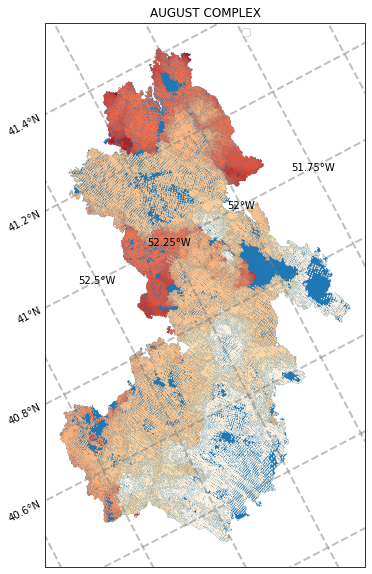

No handles with labels found to put in legend.


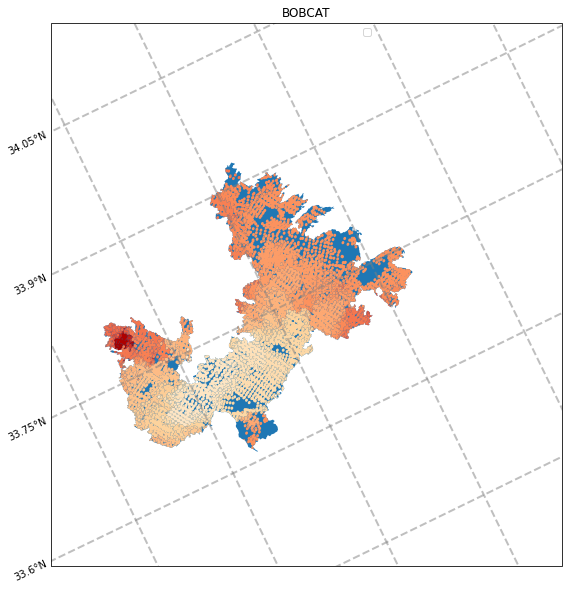

No handles with labels found to put in legend.


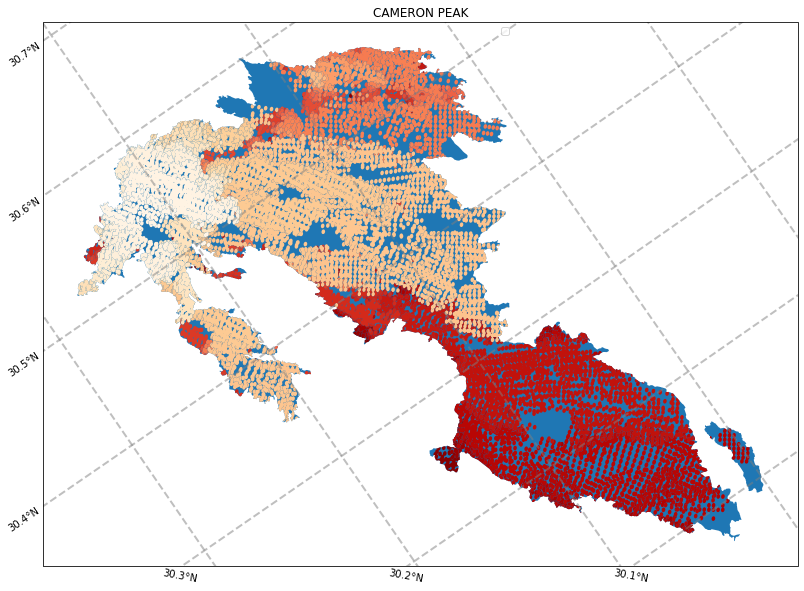

No handles with labels found to put in legend.


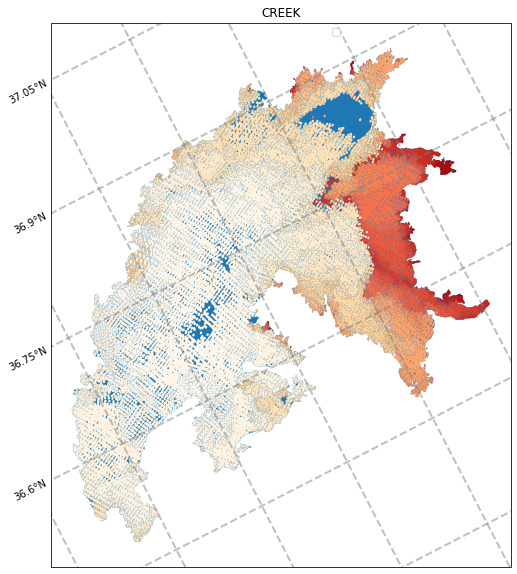

No handles with labels found to put in legend.


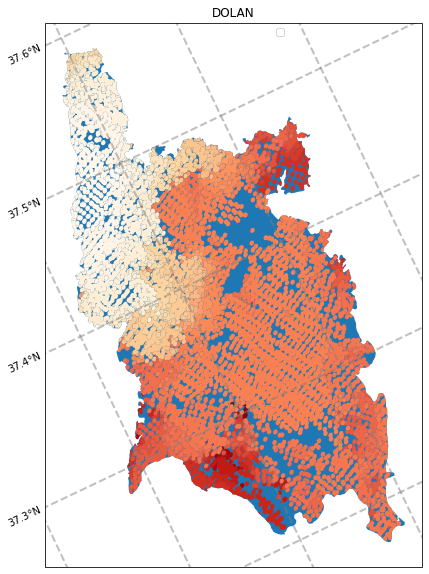

No handles with labels found to put in legend.


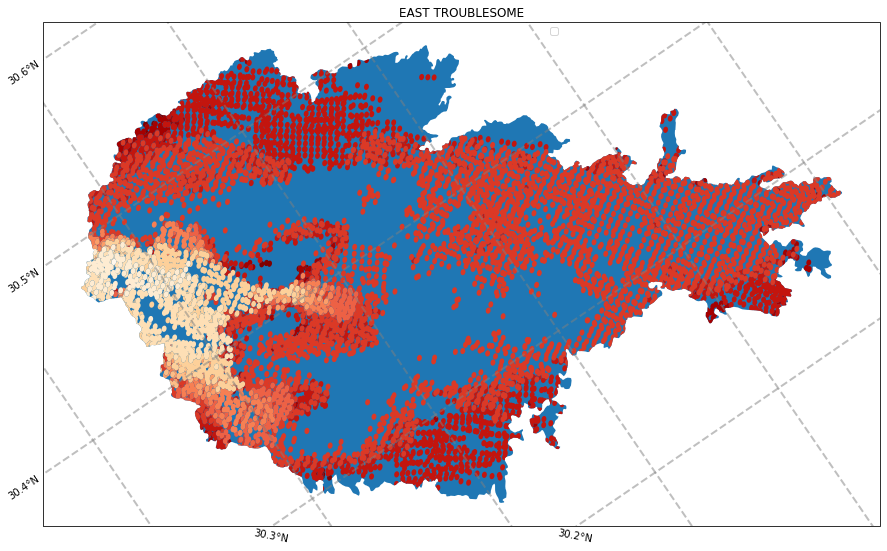

No handles with labels found to put in legend.


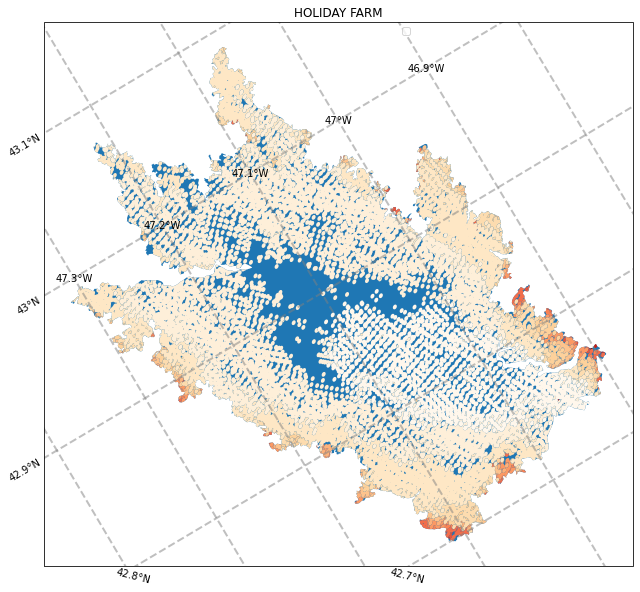

No handles with labels found to put in legend.


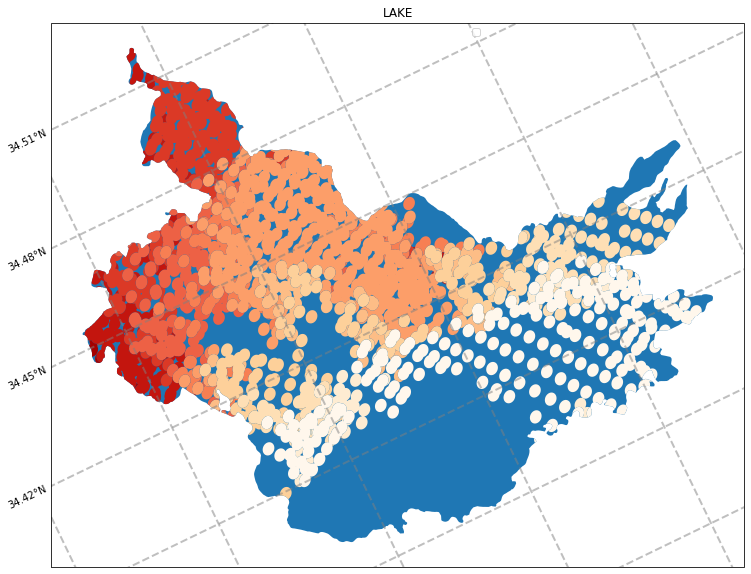

No handles with labels found to put in legend.


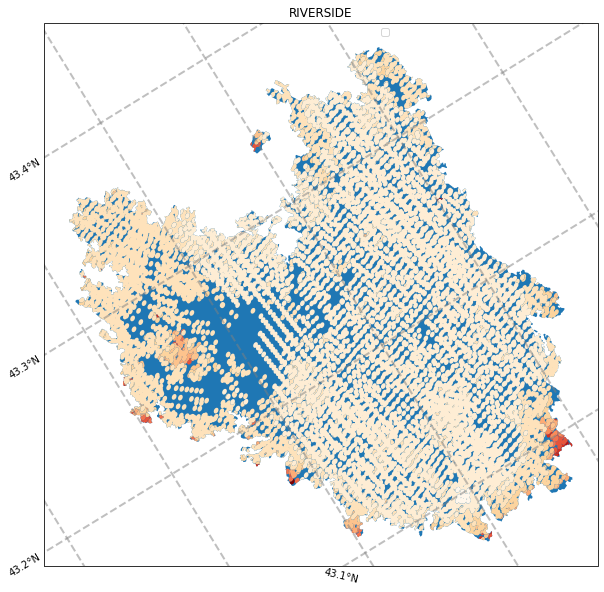

No handles with labels found to put in legend.


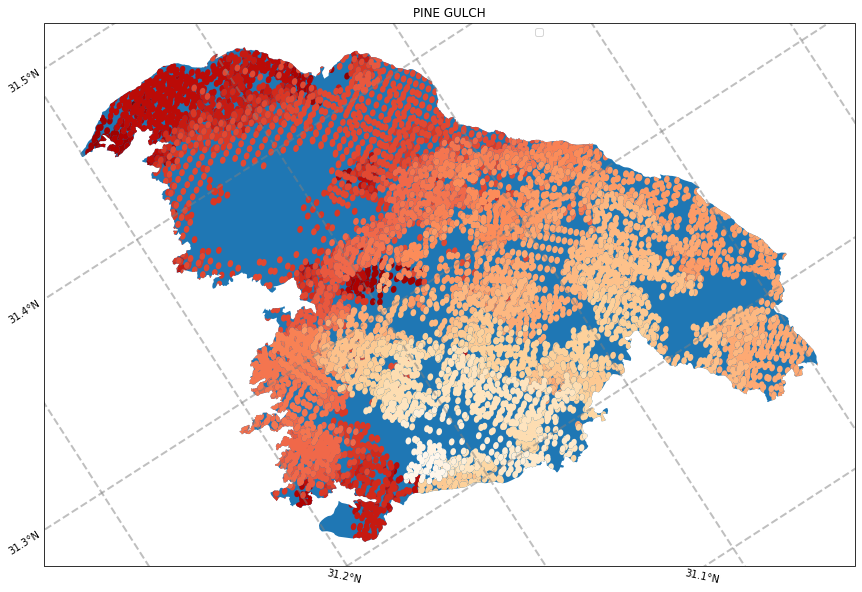

No handles with labels found to put in legend.


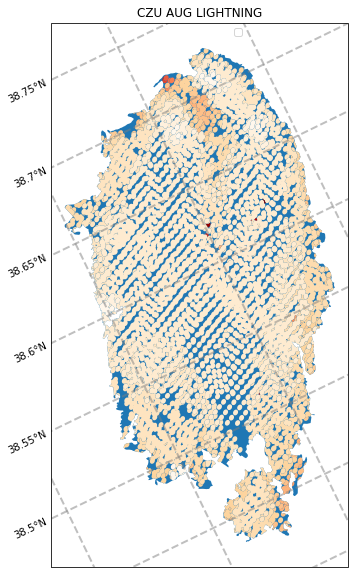

No handles with labels found to put in legend.


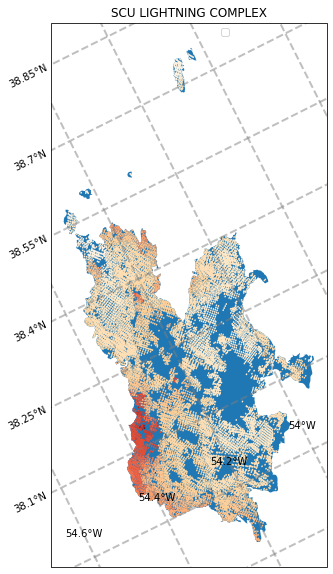

In [70]:
fire_names = ['AUGUST COMPLEX','BOBCAT', 'CAMERON PEAK','CREEK','DOLAN','EAST TROUBLESOME','HOLIDAY FARM','LAKE','RIVERSIDE',
              'PINE GULCH','CZU AUG LIGHTNING','SCU LIGHTNING COMPLEX']
#fire_names = ['BOBCAT']
for name in fire_names:
    fire_plot = daily_2020[daily_2020['Fire Name']==name].reset_index(drop=True)
    #print(fire_plot)
    irwin = fire_plot['irwinID'].values[0]
    if name=='BOBCAT':
        irwin=fire_plot['irwinID'].values[4]
    #print(irwin)
    mtbs_plot = mtbs_bdrys_2020[mtbs_bdrys_2020['irwinID']==irwin].to_crs('EPSG:3347')
    #print(mtbs_plot.columns)
    #print(mtbs_plot[['Map_ID','BurnBndLat', 'BurnBndLon']])
    #print(mtbs_plot)
    fig = plt.figure(figsize=(15,10))
    ax= fig.add_subplot(111,projection=ccrs.LambertConformal())
    if name=='BOBCAT':
        ax.set_extent([-54.6, -55.1, 33.5,34])
    mtbs_plot.plot(ax=ax)
    fire_plot.plot(column='Local Day', cmap='OrRd',ax=ax, legend=True)
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,\
            linewidth=2, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    ax.legend(bbox_to_anchor=(0.6, 1), loc='upper left')

    plt.title(name)
    plt.show()    

## Load and plot multiple fires

In [ ]:
file_list = os.listdir('../mtbs/2020/')

mtbs_bdrys = gpd.GeoDataFrame()
for file in file_list:
    if file.endswith('_burn_bndy.shp'):
        gdf_file = gpd.read_file('../mtbs/2020/'+file)
        mtbs_bdrys = pd.concat([mtbs_bdrys, gdf_file], axis=0)

mtbs_bdrys_merged = mtbs_bdrys.dissolve(by='irwinID').reset_index()
print(mtbs_bdrys_merged)

In [ ]:
fig = plt.figure(figsize=(15,10))
ax= fig.add_subplot(111,projection=ccrs.LambertConformal())
#ax.set_extent([-54.6, -55, 38.4,38.75])
mtbs_bdrys.plot(column='Incid_Name',cmap='tab20',ax=ax, legend=True)
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,\
            linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.top_labels = False
gl.right_labels = False
plt.title('Burn_Bndys')
plt.show()

In [ ]:
polygons_2020 = gpd.read_file('AllFires_VIIRS_per_overpass_irwin_2020.geojson')

In [ ]:
print(polygons_2020.head())
print(polygons_2020[polygons_2020['irwinID']==mtbs_bdrys_merged['irwinID'].iloc[0]])

In [ ]:
print(polygons_2020['irwinID'])
print(mtbs_bdrys_merged['irwinID'])

In [ ]:
polygons_2020_irwin = polygons_2020.set_index(['irwinID'])
mtbs_bdrys_merged_irwin = mtbs_bdrys_merged.set_index(['irwinID'])

In [ ]:
clipped_polys = gpd.GeoDataFrame()
for ii in range(len(mtbs_bdrys_merged)):
    clipper = mtbs_bdrys_merged.iloc[ii:ii+1].to_crs('EPSG:3347') #the merged MTBS
    to_clip = polygons_2020.iloc[np.where(polygons_2020['irwinID'].values==clipper['irwinID'].values)] #my polygon
    clipped = gpd.clip(to_clip, clipper) #clip out all the extra stuff, other fires, random spot detections, etc
    
    clipped_polys = pd.concat([clipped_polys, clipped],axis=0) #save the clipped ones, work with these

fig = plt.figure(figsize=(15,10))
ax= fig.add_subplot(111,projection=ccrs.LambertConformal())
#ax.set_extent([-54.6, -55, 38.4,38.75])
clipped_polys.plot(column='Current Day', cmap='tab20',ax=ax, legend=True)
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,\
            linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.top_labels = False
gl.right_labels = False
plt.title('SCU')
plt.show()    

In [ ]:
clipped_polys.head()

In [ ]:
polygons_2019 = gpd.read_file('AllFires_VIIRS_per_overpass_irwin_2019.geojson', include_fields=['irwinID'])
print(polygons_2019.head())

In [ ]:
print(scu)

In [ ]:
scu = polygons_2020[polygons_2020['Fire Name']=='SCU LIGHTNING COMPLEX']
scu_mtbs = mtbs_bdrys_merged[mtbs_bdrys_merged['Incid_Name']=='SCU LIGHTNING COMPLEX']['geometry'].to_crs('EPSG:3347')
print(scu_mtbs.crs)

scu_clipped = gpd.clip(scu, scu_mtbs)


fig = plt.figure(figsize=(15,10))
ax= fig.add_subplot(111,projection=ccrs.LambertConformal())
#ax.set_extent([-54.6, -55, 38.4,38.75])
scu.plot(color='k',ax=ax, legend=True)
scu_clipped.plot(color='y', ax=ax, legend=True)
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,\
            linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.top_labels = False
gl.right_labels = False
plt.title('SCU')
plt.show()

## Load and plot one fire

In [ ]:
czu_burn_bndy = gpd.read_file('../mtbs/2020/ca3726212222320200816_20200724_20210711_burn_bndy.shp')
czu_mask = gpd.read_file('../mtbs/2020/ca3726212222320200816_20200724_20210711_mask.shp')
print(czu_burn_bndy.columns)
print(czu_burn_bndy)

In [ ]:
fig = plt.figure(figsize=(15,10))
ax= fig.add_subplot(111,projection=ccrs.LambertConformal())
#ax.set_extent([-54.6, -55, 38.4,38.75])
czu_burn_bndy.plot(color='k',ax=ax, legend=True)
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,\
            linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.top_labels = False
gl.right_labels = False
plt.title('CZU Burn_Bndy')
plt.show()

In [ ]:
fig = plt.figure(figsize=(15,10))
ax= fig.add_subplot(111,projection=ccrs.LambertConformal())
#ax.set_extent([-54.6, -55, 38.4,38.75])
czu_mask.plot(color='k',ax=ax, legend=True)
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,\
            linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.top_labels = False
gl.right_labels = False
plt.title('CZU mask')
plt.show()